# Data preparetion

### Import

In [1]:
#Load the required libraries
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import sklearn.model_selection as ms
from sklearn.svm import SVR
from sklearn.model_selection  import train_test_split
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from pandas.plotting import scatter_matrix
from sklearn.metrics import mean_squared_error
from math import sqrt

## Confusion Matrix
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_recall_fscore_support, classification_report
from sklearn.metrics import accuracy_score,f1_score,roc_auc_score, recall_score
from sklearn.model_selection import cross_val_score, KFold, cross_val_predict
from sklearn.metrics import precision_recall_curve, average_precision_score,roc_curve, auc, precision_score

In [2]:
# feature selection
import statsmodels.api as sm
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from sklearn.inspection import permutation_importance
import shap
import category_encoders as ce

import xgboost as xgb

In [3]:
## roc & auc
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc  ###计算roc和auc

In [4]:
# Tree View
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

In [5]:
## modelling
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

In [6]:
## GridSearch
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

In [7]:
## Model Explaination
### Permutation Importance
import eli5
from eli5.sklearn import PermutationImportance
### SHAP
import shap

In [10]:
import os
os.getcwd()

'/Users/lijiaze/Desktop/2022-2/CITS5553/model/data'

In [11]:
os.chdir('/Users/lijiaze/Desktop/2022-2/CITS5553/model/data/')

### Load data

#### load whole data

In [12]:
#Load the data
df = pd.read_csv("wba_data_CLEAN.csv")

#View the data
df.head()

,Unnamed: 0,Subject,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,0,8,0,9.333333,1.08,-189.0,0.52,1,3.0,10.0,...,0.5370,0.4869,0.4301,0.4080,0.3804,0.3291,0.2951,0.2530,0.2282,0.2003
1,1,22,0,9.500000,1.28,-49.0,1.28,0,7.0,4.0,...,0.2636,0.2578,0.2443,0.2549,0.2604,0.2397,0.2299,0.2048,0.1917,0.1659
2,2,24,1,9.833333,1.26,-27.0,0.87,0,9.0,12.0,...,0.4269,0.4142,0.3910,0.3799,0.3740,0.3536,0.3473,0.3237,0.3056,0.2881
3,3,31,0,9.916667,0.64,-8.0,0.60,0,13.0,9.0,...,0.0077,0.0123,0.0066,0.0000,0.0126,0.0231,0.0405,0.0401,0.0391,0.0258
4,4,42,0,7.916667,0.92,-17.0,1.65,0,7.0,0.0,...,0.2332,0.2216,0.2228,0.2653,0.2596,0.2576,0.2838,0.3598,0.3953,0.3642


In [13]:
# Remove 'Unnamed: 0' and subject column
wba_data = df.drop(["Unnamed: 0", "Subject"], axis=1)

wba_data.head()

,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,OAE2.8,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,0,9.333333,1.08,-189.0,0.52,1,3.0,10.0,18.0,14.0,...,0.5370,0.4869,0.4301,0.4080,0.3804,0.3291,0.2951,0.2530,0.2282,0.2003
1,0,9.500000,1.28,-49.0,1.28,0,7.0,4.0,9.0,5.0,...,0.2636,0.2578,0.2443,0.2549,0.2604,0.2397,0.2299,0.2048,0.1917,0.1659
2,1,9.833333,1.26,-27.0,0.87,0,9.0,12.0,8.0,12.0,...,0.4269,0.4142,0.3910,0.3799,0.3740,0.3536,0.3473,0.3237,0.3056,0.2881
3,0,9.916667,0.64,-8.0,0.60,0,13.0,9.0,13.0,11.0,...,0.0077,0.0123,0.0066,0.0000,0.0126,0.0231,0.0405,0.0401,0.0391,0.0258
4,0,7.916667,0.92,-17.0,1.65,0,7.0,0.0,2.0,12.0,...,0.2332,0.2216,0.2228,0.2653,0.2596,0.2576,0.2838,0.3598,0.3953,0.3642


In [14]:
# freqs = [f for f in features if f[:2] == "f("]
frequency = wba_data.iloc[:,14:138]
frequency_list = list(frequency.columns)
frequency_list[0:10]

['f(226.0000)',
 'f(257.3256)',
 'f(280.6155)',
 'f(297.3018)',
 'f(324.2099)',
 'f(343.4884)',
 'f(363.9133)',
 'f(385.5527)',
 'f(408.4789)',
 'f(432.7683)']

#### load original train and test data

In [15]:
#Load the data
X_train = pd.read_csv("X_train.csv")
X_test = pd.read_csv("X_test.csv")
y_train = pd.read_csv("y_train.csv")
y_test = pd.read_csv("y_test.csv")

#View the data
X_train.head()

,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,OAE2.8,...,f(6168.8433),f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000)
0,1,8.583333,0.89,-151.0,2.53,1,0.0,5.0,9.2,11.7,...,0.3955,0.3583,0.2997,0.2709,0.2544,0.1956,0.1648,0.1158,0.1083,0.0542
1,1,9.833333,0.81,-63.0,1.32,0,8.1,20.8,14.7,6.9,...,0.4592,0.4006,0.3508,0.3381,0.2983,0.2789,0.2655,0.3118,0.3039,0.3022
2,0,10.083333,1.50,-28.0,0.56,0,10.4,15.4,15.6,9.9,...,0.2600,0.2409,0.2002,0.2064,0.2190,0.1961,0.2076,0.1994,0.2084,0.1099
3,1,8.666667,1.15,3.0,1.07,0,10.6,15.1,15.0,7.8,...,0.5128,0.4605,0.4126,0.4001,0.3634,0.3378,0.3084,0.3156,0.3042,0.2912
4,1,8.583333,1.03,-10.0,0.43,0,3.7,11.5,7.4,5.7,...,0.0000,0.0034,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000


#### load train and test sets after oversampling

In [16]:
#Load the data
X_train_over_large = pd.read_csv("large/Oversampling_Large/X_train_over.csv")
X_test_over_large = pd.read_csv("large/Oversampling_Large/X_test_over.csv")
y_train_over_large = pd.read_csv("large/Oversampling_Large/y_train_over.csv")
y_test_over_large = pd.read_csv("large/Oversampling_Large/y_test_over.csv")

#View the data
X_train_over_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,5299,1,9.416667,0.93,-276.0,0.74,1,7.6,12.5,16.9,...,0.3518,0.3705,0.3571,0.3537,0.3253,0.2939,0.2267,0.2009,0.1506,5299
1,4630,1,9.833333,1.26,-43.0,0.96,0,6.0,12.0,8.0,...,0.2289,0.2080,0.2027,0.2397,0.2848,0.3512,0.4027,0.4698,0.5473,4630
2,7124,0,8.916667,0.91,-291.0,0.62,1,2.8,11.9,15.5,...,0.3683,0.3139,0.2374,0.1995,0.1636,0.1545,0.1399,0.1475,0.1596,7124
3,6631,0,8.583333,1.07,7.0,0.89,0,10.9,0.4,6.7,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,6631
4,2604,1,10.166667,0.96,6.0,0.51,0,15.0,12.0,15.0,...,0.0480,0.0249,0.0260,0.0518,0.0420,0.0440,0.0189,0.0228,0.0000,2604


In [17]:
#Load the data
X_train_over = pd.read_csv("X_train_over.csv")
X_test_over = pd.read_csv("X_test_over.csv")
y_train_over = pd.read_csv("y_train_over.csv")
y_test_over = pd.read_csv("y_test_over.csv")

In [18]:
y_train_over_large = y_train_over_large.loc[:,['OverallPoF']]
y_train_over_large.head()

,OverallPoF
0,1
1,0
2,1
3,1
4,0


In [19]:
y_test_over_large = y_test_over_large.loc[:,['OverallPoF']]
y_test_over_large.head() 

,OverallPoF
0,0
1,1
2,0
3,0
4,0


In [20]:
y_train_over = y_train_over.loc[:,['OverallPoF']]
y_test_over = y_test_over_large.loc[:,['OverallPoF']]

#### load train and test sets after SMOTE

In [21]:
#Load the data
X_train_smote_large = pd.read_csv("large/Smote_Large/X_train_smote.csv")
X_test_smote_large = pd.read_csv("large/Smote_Large/X_test_smote.csv")
y_train_smote_large = pd.read_csv("large/Smote_Large/y_train_smote.csv")
y_test_smote_large = pd.read_csv("large/Smote_Large/y_test_smote.csv")

#View the data
X_train_smote_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,5299,0,9.488345,1.308848,-289.942410,0.392962,1,-1.983546,0.090498,5.016454,...,0.239612,0.208967,0.198652,0.197264,0.182982,0.180403,0.161424,0.149762,0.131750,5299
1,4630,0,8.329579,0.845676,-22.969964,0.544024,0,4.507509,18.086484,13.092180,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4630
2,7124,0,9.191612,0.920998,-282.751648,0.685987,1,5.439473,12.229934,16.269846,...,0.359227,0.345024,0.303222,0.284293,0.252517,0.231155,0.187630,0.176864,0.154651,7124
3,6631,0,8.462231,0.993812,-120.474751,0.626834,1,6.743916,9.804346,3.044619,...,0.077931,0.044569,0.036674,0.052039,0.046861,0.057982,0.050766,0.067965,0.060894,6631
4,2604,1,9.964026,0.810123,1.121584,0.467022,0,13.183881,15.481149,9.783881,...,0.168985,0.123954,0.125818,0.136950,0.109801,0.105816,0.079430,0.093070,0.056131,2604


In [22]:
y_train_smote_large = y_train_smote_large.loc[:,['OverallPoF']]
y_train_smote_large.head()

,OverallPoF
0,1
1,0
2,1
3,1
4,0


In [23]:
y_test_smote_large = y_test_smote_large.loc[:,['OverallPoF']]
y_test_smote_large.head()

,OverallPoF
0,0
1,1
2,0
3,0
4,0


#### load train and test sets after SVM SMOTE (large)

In [24]:
#Load the data
X_train_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/X_train_svmsmote.csv")
X_test_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/X_test_svmsmote.csv")
y_train_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/y_train_svmsmote.csv")
y_test_svmsmote_large = pd.read_csv("large/Svm_Smote_Large/y_test_svmsmote.csv")

#View the data
X_train_svmsmote_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,3526,0,7.671420,1.788495,-26.057037,0.715388,0,-1.883375,5.264805,3.368931,...,0.328155,0.342032,0.364087,0.407503,0.438861,0.493819,0.538866,0.564331,0.612743,3526
1,4948,1,8.416667,0.991337,-5.133655,0.424957,0,-1.100000,-3.776305,-1.579710,...,0.612860,0.560013,0.534799,0.492017,0.472529,0.453393,0.437095,0.423667,0.401722,4948
2,4378,0,7.714042,1.781300,-26.691790,0.714315,0,-1.325330,5.921238,3.664388,...,0.331551,0.341106,0.358729,0.398328,0.422852,0.471688,0.509057,0.533475,0.573287,4378
3,4680,0,8.082248,0.942708,-13.593746,1.334921,0,6.403905,1.845054,3.646356,...,0.238461,0.224106,0.245572,0.238141,0.227597,0.243436,0.288155,0.313294,0.281400,4680
4,8319,1,9.562745,0.958485,-274.685295,0.788206,1,8.684632,13.135441,17.743602,...,0.374950,0.400749,0.387185,0.383916,0.357697,0.325847,0.251537,0.222910,0.167100,8319


In [25]:
y_train_svmsmote_large = y_train_svmsmote_large.loc[:,['OverallPoF']]
y_train_svmsmote_large.head()

,OverallPoF
0,0
1,1
2,0
3,1
4,1


In [26]:
y_test_svmsmote_large = y_test_svmsmote_large.loc[:,['OverallPoF']]
y_test_svmsmote_large.head()

,OverallPoF
0,1
1,0
2,1
3,0
4,0


#### load train and test sets after Adasyn (large)

In [27]:
#Load the data
X_train_adasyn_large = pd.read_csv("large/Adasyn_Large/X_train_adasyn.csv")
X_test_adasyn_large = pd.read_csv("large/Adasyn_Large/X_test_adasyn.csv")
y_train_adasyn_large = pd.read_csv("large/Adasyn_Large/y_train_adasyn.csv")
y_test_adasyn_large = pd.read_csv("large/Adasyn_Large/y_test_adasyn.csv")

#View the data
X_train_adasyn_large.head()

,Unnamed: 0,Gender,AgeY,ECV,TPP,SC,TympType,OAE1,OAE1.4,OAE2,...,f(6349.6042),f(6535.6618),f(6727.1713),f(6924.2925),f(7127.1897),f(7336.0323),f(7550.9945),f(7772.2555),f(8000.0000),Subject
0,3102,0,9.377737,1.061538,0.981234,0.824672,0,8.106568,11.147284,9.783679,...,0.640833,0.584083,0.539227,0.495584,0.438291,0.397680,0.349746,0.327047,0.297556,3102
1,1752,0,9.246811,0.781131,-94.307823,0.715757,0,13.173328,17.731009,12.399887,...,0.051371,0.044253,0.038635,0.034667,0.030675,0.029521,0.027053,0.024445,0.022184,1752
2,49,1,8.666667,0.860000,-15.000000,0.470000,0,16.000000,10.500000,13.700000,...,0.051100,0.023500,0.019100,0.038700,0.034300,0.045800,0.034800,0.045400,0.019300,49
3,4055,0,9.333333,0.698682,-94.413908,0.632417,0,14.300729,19.293046,12.350926,...,0.024534,0.019751,0.015344,0.014418,0.013914,0.016118,0.018181,0.020290,0.025132,4055
4,2319,0,9.224798,1.391833,-87.460485,1.050653,0,4.539515,5.434141,14.434141,...,0.216785,0.186747,0.163039,0.146292,0.129448,0.124579,0.114161,0.103159,0.093617,2319


In [28]:
y_train_adasyn_large = y_train_adasyn_large.loc[:,['OverallPoF']]
y_train_adasyn_large.head()

,OverallPoF
0,0
1,0
2,0
3,0
4,0


In [29]:
y_test_adasyn_large = y_test_adasyn_large.loc[:,['OverallPoF']]
y_test_adasyn_large.head()

,OverallPoF
0,1
1,1
2,1
3,1
4,1


### Visualization function

In [30]:
def assess_freqs(wba_data, freq_cols, selected, title = "Selected Frequencies"):
    """
    wba_data: Full dataset
    freq_cols: List of all frequency column names
    selected: List of selected frequencies
    """

    # Creating melted dataframe (long format) for plotting
    overall_pof_df = wba_data[['OverallPoF'] + freq_cols]
    overall_pof_df = overall_pof_df.replace({'OverallPoF':{0: 'Pass', 1: 'Fail'}})
    overall_pof_df = overall_pof_df.groupby('OverallPoF').mean()
    overall_pof_df = overall_pof_df.melt(ignore_index=False)
    overall_pof_df = overall_pof_df.reset_index()

    # Plotting
    ax = sns.pointplot(x='variable', y='value', hue='OverallPoF', data=overall_pof_df)

    # Adding vertical lines at selected frequencies
    position = 0
    for freq in freq_cols:
        if freq in selected:
            ax.axvline(x=position, ls='--', color='red')
        position += 1

    sns.set(rc={'figure.figsize':(20,10)})

    # Rotate x-axis labels
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right")

    ax.set(title = title)

    # Show only every 2 tick labels on x-axis
    # plt.setp(ax.get_xticklabels()[::2], visible=False)

    plt.tight_layout()
    plt.show();


### Only use the feature after feature selecting

From the feature selection.ipynb file we already know that using the fourth method (xgboost) for feature selection gives the best results, so here we directly use the fourth method to filter the frequencies and end up with 20 frequencies

In [31]:
frequency_train = X_train.iloc[:,13:138]
frequency_test = X_test.iloc[:,13:138]

In [32]:
encoder = ce.LeaveOneOutEncoder(return_df=True)
X_train_loo = encoder.fit_transform(frequency_train, y_train)
X_test_loo = encoder.transform(frequency_test)

In [33]:
fs_model = xgb.XGBRegressor(n_estimators=500, max_depth=5, eta=0.05)
fs_model.fit(X_train_loo, y_train)

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False, eta=0.05,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.0500000007, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=5, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=500, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=0, reg_alpha=0, ...)

Text(0.5, 1.0, 'Feature Importance')

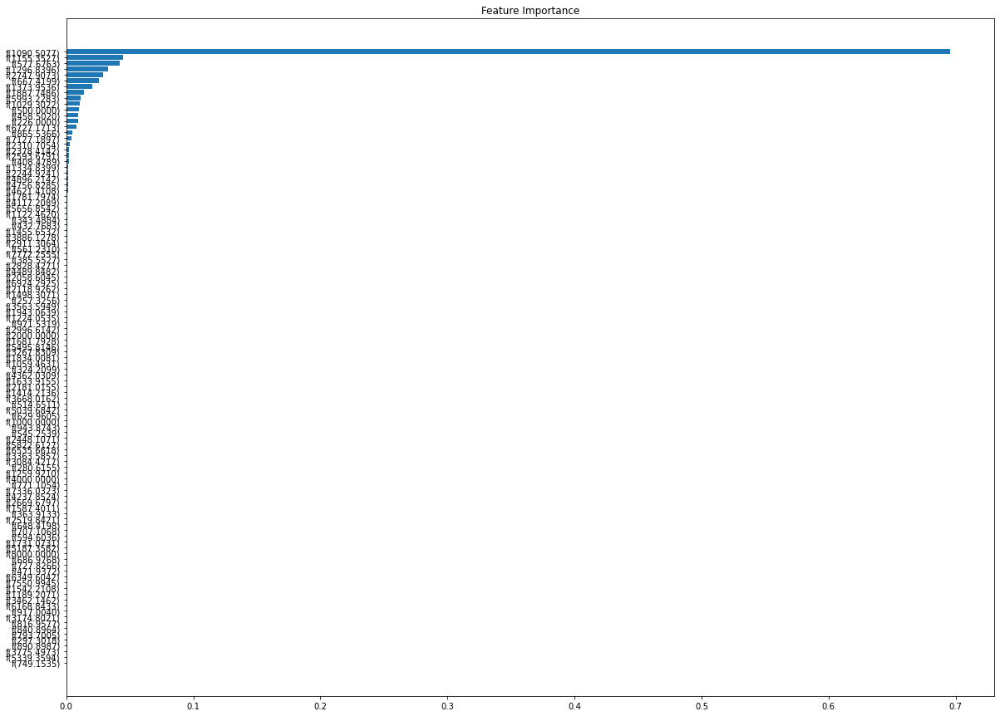

In [34]:
feature_importance = fs_model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(20, 15))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(frequency_test.columns)[sorted_idx])
plt.title('Feature Importance')

In [36]:
sorted_idx=sorted_idx[-20:]
f_list=list(np.array(frequency_test.columns)[sorted_idx])
f_list

['f(408.4789)',
 'f(2593.6791)',
 'f(2378.4142)',
 'f(2310.7054)',
 'f(7127.1897)',
 'f(865.5366)',
 'f(6727.1713)',
 'f(226.0000)',
 'f(458.5020)',
 'f(500.0000)',
 'f(1029.3022)',
 'f(5993.2283)',
 'f(1887.7486)',
 'f(1373.9536)',
 'f(667.4199)',
 'f(2747.9073)',
 'f(1296.8396)',
 'f(577.6763)',
 'f(1155.3527)',
 'f(1090.5077)']

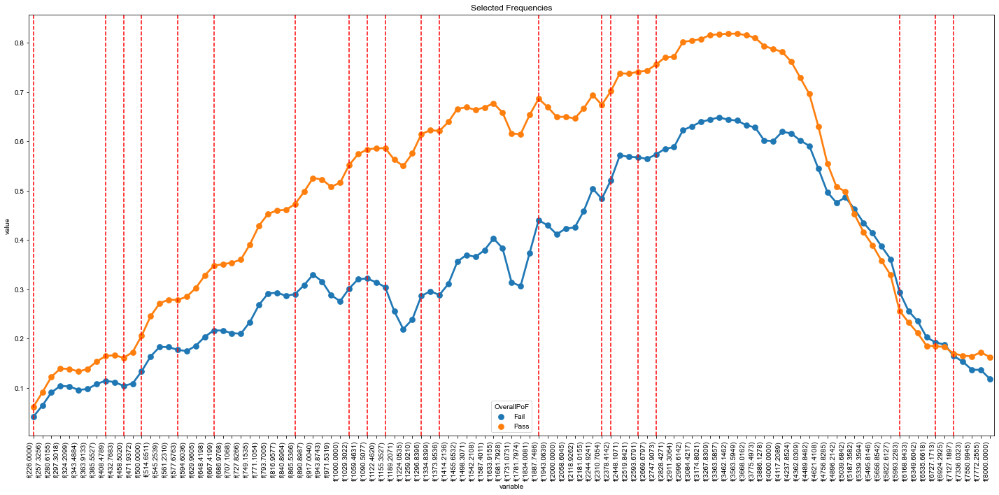

In [37]:
fig = plt.figure(figsize=(20, 10))
assess_freqs(wba_data, frequency_list, f_list)

We now have the f_list, which is the top 20 frequencies that we will select for the highest correlation.

### Train and teat sets after feature selection

'TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4'

#### Final training and testing data

In [38]:
# original
# X_train = pd.concat([X_train.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']],X_train[f_list]],axis=1)
# X_test = pd.concat([X_test.loc[:,['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4']],X_test[f_list]],axis=1)
X_train = X_train[f_list]
X_test = X_test[f_list]

In [35]:
# after oversampling
X_train_over_large = X_train_over_large[f_list]
X_test_over_large = X_test_over_large[f_list]

In [148]:
X_train_over = X_train_over[f_list]
X_test_over = X_test_over[f_list]

In [36]:
# after SMOTE
X_train_smote_large = X_train_smote_large[f_list]
X_test_smote_large = X_test_smote_large[f_list]

In [37]:
# after SVM SMOTE
X_train_svmsmote_large = X_train_svmsmote_large[f_list]
X_test_svmsmote_large = X_test_svmsmote_large[f_list]

In [38]:
# after Adasyn
X_train_adasyn_large = X_train_adasyn_large[f_list]
X_test_adasyn_large = X_test_adasyn_large[f_list]

In [ ]:
# # train data
# y_train_fails = y_train[y_train['OverallPoF'] == 1]
# y_train_over_fails = y_train_over[y_train_over['OverallPoF'] == 1]
# y_train_smote_fails = y_train_smote[y_train_smote['OverallPoF'] == 1]

# # test data
# y_test_fails = y_test[y_test['OverallPoF'] == 1]
# y_test_over_fails = y_test_over[y_test_over['OverallPoF'] == 1]
# y_test_smote_fails = y_test_smote[y_test_smote['OverallPoF'] == 1]

#### view data

In [39]:
X_train.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.0538,0.6712,0.4938,0.4478,0.1956,0.2293,0.2709,0.0044,0.0309,0.0495,0.2009,0.4621,0.3844,0.1865,0.1433,0.7555,0.1841,0.0907,0.2103,0.2344
1,0.0689,0.8478,0.7828,0.7371,0.2789,0.3189,0.3381,0.0364,0.0599,0.1077,0.4167,0.4768,0.8366,0.4787,0.2103,0.8399,0.5119,0.1542,0.4387,0.4141
2,0.2371,0.6491,0.6827,0.6858,0.1961,0.4076,0.2064,0.0581,0.2291,0.2709,0.4437,0.2779,0.5040,0.5173,0.3734,0.6188,0.5211,0.3276,0.5004,0.5038
3,0.1050,0.6001,0.6846,0.6469,0.3378,0.4331,0.4001,0.0498,0.0955,0.1515,0.5456,0.5285,0.6283,0.6200,0.2664,0.5698,0.5979,0.2041,0.5736,0.5528
4,0.1336,0.4592,0.3856,0.3660,0.0000,0.4892,0.0000,0.0227,0.1283,0.1791,0.5451,0.0026,0.4929,0.5128,0.3649,0.4908,0.5497,0.2672,0.5757,0.5824


In [ ]:
X_test.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.2284,0.6784,0.6252,0.5973,0.1211,0.7598,0.1685,0.0654,0.2313,0.2957,0.9315,0.3433,0.5636,0.7442,0.5310,0.7210,0.7940,0.4128,0.9246,0.9544
1,0.2304,0.4966,0.5483,0.5793,0.2134,0.4241,0.1773,0.0800,0.2206,0.2590,0.4562,0.2287,0.6087,0.5521,0.3515,0.4621,0.5481,0.3113,0.5132,0.5049
2,0.1865,0.8640,0.7116,0.6566,0.0915,0.7285,0.0713,0.0434,0.1859,0.2456,0.8540,0.1569,0.6011,0.7677,0.4840,0.9162,0.7790,0.3650,0.8214,0.8624
3,0.1742,0.7097,0.7218,0.7193,0.2904,0.4502,0.3468,0.0391,0.1616,0.2055,0.5060,0.5813,0.8344,0.7748,0.3371,0.6885,0.6994,0.2778,0.5813,0.5557
4,0.2256,0.9472,0.8525,0.8085,0.2619,0.5260,0.3168,0.1663,0.2236,0.2618,0.6774,0.3439,0.7051,0.6109,0.3775,0.9607,0.6136,0.3198,0.6399,0.6792


In [ ]:
X_train_over_large.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.0927,0.4960,0.3840,0.3548,0.3253,0.2354,0.3571,0.0046,0.0801,0.1107,0.2117,0.2971,0.3381,0.1793,0.1990,0.5153,0.1825,0.1611,0.2151,0.2356
1,0.1454,0.7390,0.7193,0.7263,0.2848,0.4589,0.2027,0.0316,0.1242,0.1607,0.5153,0.2819,0.8085,0.6362,0.3281,0.7129,0.5994,0.2427,0.5799,0.5716
2,0.0794,0.7436,0.6379,0.6358,0.1636,0.2549,0.2374,0.0151,0.0625,0.0873,0.2435,0.4568,0.5737,0.2568,0.1890,0.8150,0.2479,0.1369,0.2588,0.2755
3,0.2341,0.9919,0.9393,0.9076,0.0000,0.5759,0.0000,0.0732,0.2415,0.3005,0.6705,0.0000,0.8368,0.8065,0.4516,0.9912,0.8317,0.3946,0.7505,0.7091
4,0.1163,0.8194,0.6787,0.6407,0.0420,0.3918,0.0260,0.0264,0.1061,0.1453,0.4471,0.0440,0.7271,0.5120,0.2808,0.8311,0.5035,0.2087,0.4954,0.4882


In [ ]:
X_test_over_large.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.3525,0.5581,0.5354,0.5515,0.2900,0.6636,0.2993,0.1858,0.3508,0.4114,0.7914,0.3117,0.8115,0.7321,0.5731,0.5695,0.7259,0.5146,0.7284,0.7652
1,0.1137,0.6589,0.5253,0.4831,0.0552,0.3345,0.0432,0.0221,0.1015,0.1408,0.3417,0.1810,0.4998,0.3813,0.2636,0.7030,0.3718,0.2109,0.3676,0.3686
2,0.1313,0.5824,0.5290,0.4657,0.2675,0.4897,0.3189,0.0578,0.1418,0.2112,0.6945,0.4104,0.5632,0.8269,0.3104,0.7009,0.8347,0.2602,0.7845,0.7241
3,0.1690,0.9498,0.9053,0.8904,0.0437,0.5588,0.0450,0.0880,0.1650,0.2146,0.7872,0.0806,0.7858,0.8994,0.3635,0.9600,0.9105,0.2856,0.8596,0.8175
4,0.3351,0.4943,0.4481,0.4356,0.3983,0.5413,0.3379,0.1422,0.3327,0.3848,0.5841,0.2957,0.5173,0.6100,0.4714,0.4698,0.6066,0.4499,0.6321,0.6269


In [ ]:
X_train_smote_large.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.214154,0.334547,0.389703,0.377554,0.182982,0.254260,0.198652,0.128838,0.213576,0.252496,0.253388,0.276110,0.245550,0.042039,0.288133,0.303605,0.067992,0.287102,0.179317,0.250080
1,0.185861,0.721965,0.750568,0.719454,0.000000,0.542855,0.000000,0.061828,0.202554,0.255552,0.643929,0.000000,0.807130,0.810505,0.417664,0.742859,0.763702,0.334702,0.656108,0.668966
2,0.086714,0.607447,0.498283,0.481281,0.252517,0.244177,0.303222,0.009326,0.072178,0.100167,0.226013,0.368983,0.444146,0.214184,0.194499,0.650198,0.211937,0.150207,0.234770,0.253559
3,0.113776,0.660955,0.541495,0.507453,0.046861,0.324665,0.036674,0.020574,0.100080,0.138035,0.328964,0.153655,0.534306,0.372976,0.255155,0.695975,0.360076,0.204540,0.356148,0.358825
4,0.201181,0.643153,0.635582,0.640094,0.109801,0.431928,0.125818,0.057465,0.198448,0.250970,0.435078,0.226420,0.766223,0.490819,0.417534,0.628932,0.482365,0.345876,0.478598,0.480594


In [ ]:
X_test_smote_large.head()

,f(408.4789),f(2593.6791),f(2378.4142),f(2310.7054),f(7127.1897),f(865.5366),f(6727.1713),f(226.0000),f(458.5020),f(500.0000),f(1029.3022),f(5993.2283),f(1887.7486),f(1373.9536),f(667.4199),f(2747.9073),f(1296.8396),f(577.6763),f(1155.3527),f(1090.5077)
0,0.063370,0.932548,0.956849,0.950715,0.025616,0.282516,0.035751,0.003818,0.049740,0.075743,0.289103,0.086680,0.834861,0.434959,0.194828,0.873704,0.406208,0.132343,0.338130,0.328657
1,0.048726,0.770589,0.699027,0.651779,0.326424,0.211831,0.319697,0.000000,0.025822,0.042604,0.211597,0.387645,0.401832,0.207630,0.128977,0.766470,0.206309,0.081672,0.226222,0.242350
2,0.086168,0.828373,0.797865,0.792874,0.131114,0.342934,0.169691,0.025509,0.071919,0.099929,0.396828,0.276550,0.751607,0.517239,0.214199,0.837372,0.487346,0.152995,0.442131,0.450352
3,0.163979,0.633501,0.590933,0.569589,0.245029,0.421618,0.213049,0.025898,0.164499,0.220344,0.491440,0.191877,0.670702,0.521026,0.334980,0.627205,0.520810,0.293705,0.522953,0.543772
4,0.179280,0.681410,0.624802,0.602092,0.259033,0.433647,0.232524,0.077192,0.166136,0.201893,0.530155,0.278758,0.660696,0.603863,0.334385,0.663880,0.583917,0.269553,0.555561,0.569372


### Use an 85/15 random split on the training set to form a validation set.

In [39]:
from sklearn.model_selection import train_test_split

# Nomal data
# random_state for reproducing 
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train.shape)
 
print('number of train examples:', X_train.shape[0])
print('number of valid examples:', X_val.shape[0])
print('number of test examples:', X_test.shape[0])

X_train shape: (162, 20)
number of train examples: 162
number of valid examples: 29
number of test examples: 48


In [41]:
# Oversampling data (large)
# random_state for reproducing 
X_train_over_large, X_val_over_large, y_train_over_large, y_val_over_large = train_test_split(X_train_over_large, y_train_over_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_over_large.shape)

print('number of train examples:', X_train_over_large.shape[0])
print('number of valid examples:', X_val_over_large.shape[0])
print('number of test examples:', X_test_over_large.shape[0])

X_train shape: (7225, 20)
number of train examples: 7225
number of valid examples: 1275
number of test examples: 1500


In [149]:
## small one
X_train_over, X_val_over, y_train_over, y_val_over = train_test_split(X_train_over, y_train_over, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_over.shape)

print('number of train examples:', X_train_over.shape[0])
print('number of valid examples:', X_val_over.shape[0])
print('number of test examples:', X_test_over.shape[0])

X_train shape: (289, 20)
number of train examples: 289
number of valid examples: 52
number of test examples: 61


In [42]:
# SMOTE data (large)
# random_state for reproducing 
X_train_smote_large, X_val_smote_large, y_train_smote_large, y_val_smote_large = train_test_split(X_train_smote_large, y_train_smote_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_smote_large.shape)

print('number of train examples:', X_train_smote_large.shape[0])
print('number of valid examples:', X_val_smote_large.shape[0])
print('number of test examples:', X_test_smote_large.shape[0])

X_train shape: (7225, 20)
number of train examples: 7225
number of valid examples: 1275
number of test examples: 1500


In [43]:
# SVM svmsmote data (large)
# random_state for reproducing 
X_train_svmsmote_large, X_val_svmsmote_large, y_train_svmsmote_large, y_val_svmsmote_large = train_test_split(X_train_svmsmote_large, y_train_svmsmote_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_svmsmote_large.shape)

print('number of train examples:', X_train_svmsmote_large.shape[0])
print('number of valid examples:', X_val_svmsmote_large.shape[0])
print('number of test examples:', X_test_svmsmote_large.shape[0])

X_train shape: (6943, 20)
number of train examples: 6943
number of valid examples: 1226
number of test examples: 1442


In [44]:
# Adasyn data (large)
# random_state for reproducing 
X_train_adasyn_large, X_val_adasyn_large, y_train_adasyn_large, y_val_adasyn_large = train_test_split(X_train_adasyn_large, y_train_adasyn_large, test_size=0.15, random_state=42)
 
print('X_train shape:', X_train_adasyn_large.shape)

print('number of train examples:', X_train_adasyn_large.shape[0])
print('number of valid examples:', X_val_adasyn_large.shape[0])
print('number of test examples:', X_test_adasyn_large.shape[0])

X_train shape: (7226, 20)
number of train examples: 7226
number of valid examples: 1276
number of test examples: 1501


# Model Fitting - Nomal dataset

## Model Choosing

### Training Model Function

In [45]:
def model_train(model, name):
    model.fit(X_train, y_train)                                          # Fitting the model
    y_pred = model.predict(X_test)                                       # Making prediction from the trained model
    cm = confusion_matrix(y_test, y_pred)                               
    print("Grid Search Confusion Matrix " +" Validation Data")           # Displaying the Confusion Matrix
    print(cm)
    print('-----------------------')
    print('-----------------------')
    cr = classification_report(y_test, y_pred)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc = roc_auc_score(y_test, y_pred)       
    print("AUC Score " + str(auc))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec = recall_score(y_test, y_pred)
    print("Recall "+ str(rec))                                           # Displaying the Recall score
    print('_________________________')

    return auc, rec, model

### Decision Tree

#### before gridsearch

In [46]:
# dt = DecisionTreeClassifier(criterion = 'entropy',max_depth = 10, min_samples_leaf =3, random_state=101)
dt = DecisionTreeClassifier(random_state=42)

In [47]:
dt_auc, dt_rec, dt_model = model_train(dt, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[38  2]
 [ 2  6]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      0.95      0.95        40
           1       0.75      0.75      0.75         8

    accuracy                           0.92        48
   macro avg       0.85      0.85      0.85        48
weighted avg       0.92      0.92      0.92        48

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.85
Decision Tree Recall  Validation Data
Recall 0.75
_________________________


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [48]:
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_test)
accuracy_dt = accuracy_score(dt_prediction,y_test)
cm_dt = confusion_matrix(dt_prediction,y_test)
prfs_dt = precision_recall_fscore_support(dt_prediction,y_test)
print('Accuracy: ',accuracy_dt)
print('\n')
print('Confusion Matrix: ',cm_dt)
print('\n')
print('Precision: ', prfs_dt[0])
print('Recall:    ', prfs_dt[1])
print('Fscore:    ', prfs_dt[2])
print('Support:   ', prfs_dt[3])

Accuracy:  0.9166666666666666


Confusion Matrix:  [[38  2]
 [ 2  6]]


Precision:  [0.95 0.75]
Recall:     [0.95 0.75]
Fscore:     [0.95 0.75]
Support:    [40  8]


In [49]:
## train set
dt.fit(X_train,y_train)
dt_prediction_train = dt.predict(X_train)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train, dt_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=dt_prediction_train, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=dt_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=dt_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train, dt_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [50]:
## test set
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_test)
print("Decision Tree Conclusion for Original Dataset")
print('Precision:         ',precision_score(y_test, dt_prediction))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=dt_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=dt_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=dt_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_test, dt_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset
Precision:          0.75
F1-Score:           0.8500000000000001
Accuracy Scores:    0.9166666666666666
Recall Scores:      0.85
Sensitivity:        0.75
Specificity:        0.95


In [51]:
## validation set
dt.fit(X_train,y_train)
dt_prediction = dt.predict(X_val)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_val, dt_prediction))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=dt_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=dt_prediction))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=dt_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_val, dt_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          1.0
F1-Score:           0.855
Accuracy Scores:    0.9310344827586207
Recall Scores:      0.8
Sensitivity:        0.6
Specificity:        1.0


In [52]:
y_train_pred_dt_cross = cross_val_predict(dt, X_train, y_train, cv=3)
confusion_matrix(y_train, y_train_pred_dt_cross)

array([[130,   7],
       [  8,  17]])

<Figure size 1440x720 with 0 Axes>

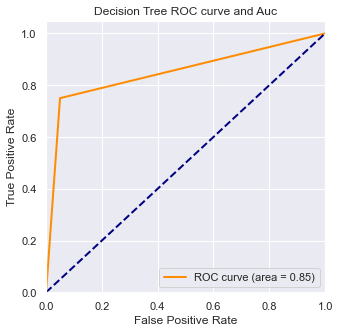

In [53]:
## The value of y_score calculated by decision_function() is used in the roc_curve() function
y_score_dt = dt.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_dt,tpr_dt,threshold_dt = roc_curve(np.ravel(y_test), y_score_dt) ## Calculation of true rate and false positive rate
roc_auc_dt = auc(fpr_dt,tpr_dt) ## Calculate the value of auc

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt, tpr_dt, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc_dt)
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

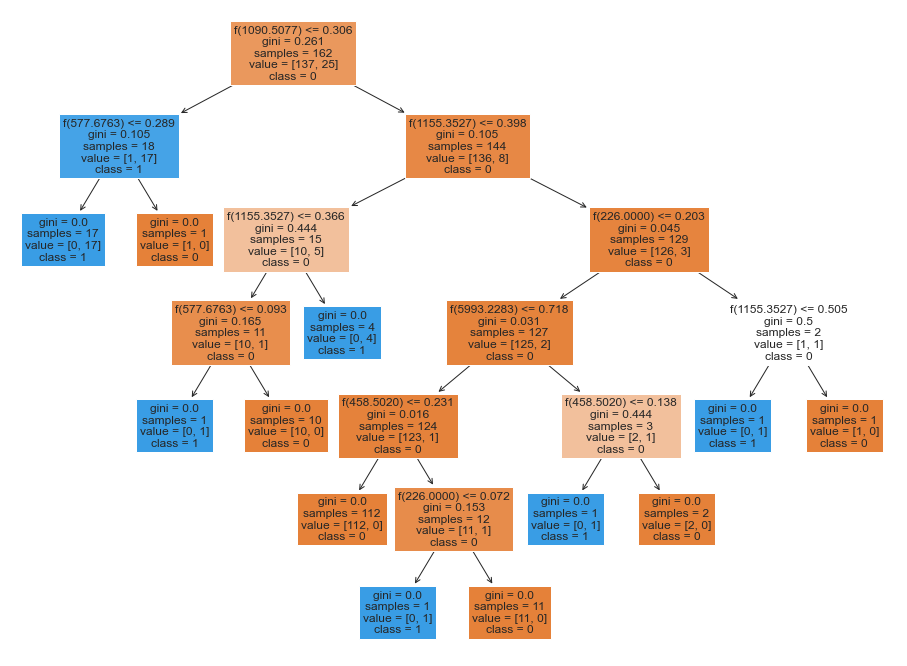

In [54]:
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_dt = plot_tree(dt, feature_names=X_train.columns, fontsize=12, filled=True, class_names=['0', '1'])

#### Decision Tree GridSearch

In [121]:
paramGride = dict(
    max_depth = [3,5,6,7,8,10,15,None],
    max_leaf_nodes = [3,5,6,7,8,10,12,15,None])

dtModel_normal = DecisionTreeClassifier()

dt_normal_grid = GridSearchCV(
    dtModel_normal,paramGride,cv = 3,return_train_score = True)
dt_normal_grid = dt_normal_grid.fit(X_train,y_train)

In [122]:
print('best_score:%f'% dt_normal_grid.best_score_)
print('best parameter:')

for key in dt_normal_grid.best_params_.keys():
    print('%s = %s'%(key,dt_normal_grid.best_params_[key]))

best_score:0.938272
best parameter:
max_depth = 5
max_leaf_nodes = 3


In [123]:
dt_normal_grid.best_estimator_

DecisionTreeClassifier(max_depth=5, max_leaf_nodes=3)

In [124]:
dt_normal_grid_model = DecisionTreeClassifier(max_depth=5, max_leaf_nodes=3)

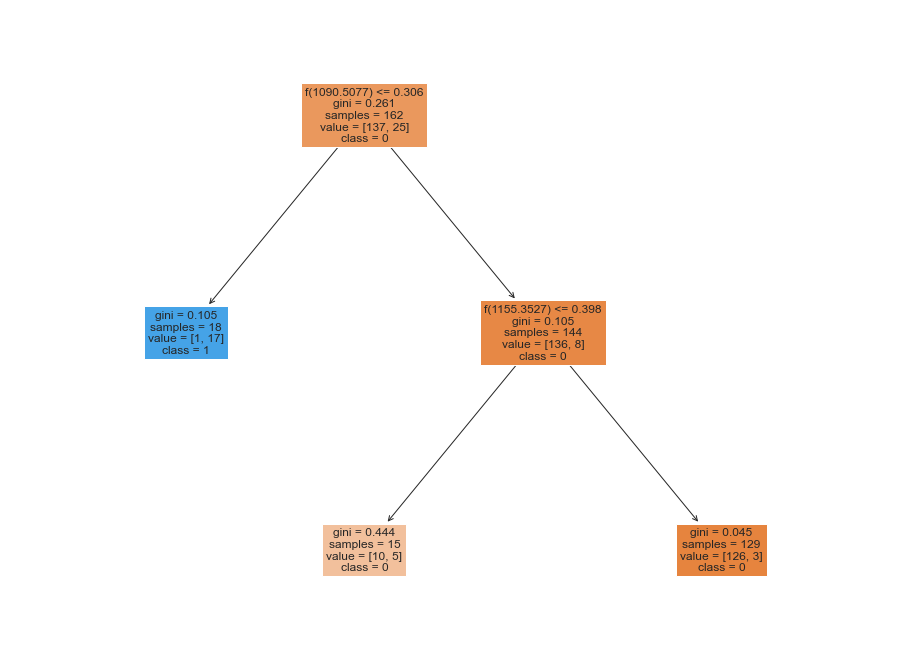

In [125]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_normal_grid_model.fit(X_train,y_train)
predictions_dt_normal_large_grid = dt_normal_grid_model.predict(X_test)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_normal_large = plot_tree(dt_normal_grid_model, feature_names=X_train.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [126]:
## train set
dt_normal_grid_model.fit(X_train,y_train)
dt_normal_large_prediction_train = dt_normal_grid_model.predict(X_train)
print("Decision Tree Conclusion for normal Dataset of train set")
print('Precision:         ',precision_score(y_train, dt_normal_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=dt_normal_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=dt_normal_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=dt_normal_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train, dt_normal_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for normal Dataset of train set
Precision:          0.9444444444444444
F1-Score:           0.8793346023338575
Accuracy Scores:    0.9444444444444444
Recall Scores:      0.8363503649635037
Sensitivity:        0.68
Specificity:        0.9927007299270073


In [127]:
## test set
dt_normal_grid_model.fit(X_train,y_train)
dt_normal_large_prediction = dt_normal_grid_model.predict(X_test)
print("Decision Tree Conclusion for normal Dataset of test set")
print('Precision:         ',precision_score(y_test, dt_normal_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=dt_normal_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=dt_normal_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=dt_normal_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test, dt_normal_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for normal Dataset of test set
Precision:          1.0
F1-Score:           0.8665430954587581
Accuracy Scores:    0.9375
Recall Scores:      0.8125
Sensitivity:        0.625
Specificity:        1.0


In [128]:
## validation set
y_valpred_dt_normal_large = dt_normal_grid_model.predict(X_val)
print("Decision Tree Conclusion for normal Dataset of val set")
print('Precision:         ',precision_score(y_val, y_valpred_dt_normal_large))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=y_valpred_dt_normal_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=y_valpred_dt_normal_large))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=y_valpred_dt_normal_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val, y_valpred_dt_normal_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for normal Dataset of val set
Precision:          1.0
F1-Score:           0.855
Accuracy Scores:    0.9310344827586207
Recall Scores:      0.8
Sensitivity:        0.6
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

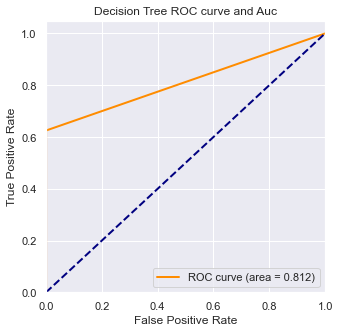

In [130]:
y_score_dt_normal_large = dt_normal_grid_model.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_dt_normal_large,tpr_dt_normal_large,threshold_dt_normal_large = roc_curve(np.ravel(y_test), y_score_dt_normal_large) 
roc_auc_dt_normal_large = auc(fpr_dt_normal_large,tpr_dt_normal_large) 

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_normal_large, tpr_dt_normal_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_normal_large) 
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [55]:
# Random Forest Algorithm
rf = RandomForestClassifier(random_state=42)

In [56]:
rf_auc, rf_rec, rf_model = model_train(rf, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[40  0]
 [ 2  6]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        40
           1       1.00      0.75      0.86         8

    accuracy                           0.96        48
   macro avg       0.98      0.88      0.92        48
weighted avg       0.96      0.96      0.96        48

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 0.875
Random Forest Classifier Recall  Validation Data
Recall 0.75
_________________________


In [57]:
## train set
rf.fit(X_train,y_train)
rf_prediction_train = rf.predict(X_train)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train, rf_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_prediction_train, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train, rf_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [58]:
## test set
rf.fit(X_train,y_train)
rf_prediction = rf.predict(X_test)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_test, rf_prediction))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_test, rf_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          1.0
F1-Score:           0.9163763066202091
Accuracy Scores:    0.9583333333333334
Recall Scores:      0.875
Sensitivity:        0.75
Specificity:        1.0


In [59]:
## validation set
rf.fit(X_train,y_train)
rf_prediction = rf.predict(X_val)
print("Random Forest Conclusion for Original Dataset of validation set")
print('Precision:         ',precision_score(y_val, rf_prediction))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=rf_prediction, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=rf_prediction))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=rf_prediction,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_val, rf_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of validation set
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

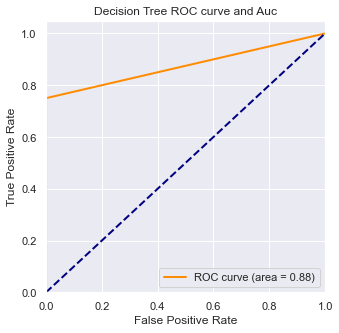

In [60]:
y_score_rf = rf.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf,tpr_rf,threshold_rf = roc_curve(np.ravel(y_test), y_score_rf) ###计算真正率和假正率
roc_auc_rf = auc(fpr_rf,tpr_rf) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf, tpr_rf, color='darkorange',
         lw=lw, label='ROC curve (area = %0.2f)' % roc_auc_rf) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Grid Search

In [61]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs = GridSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs.fit(X_train, np.ravel(y_train))
y_pred = rf_gs.predict(X_test)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=8; total time=   0.0s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s

In [62]:
rf_gs.best_estimator_

RandomForestClassifier(max_depth=5, min_samples_leaf=2, min_samples_split=10,
                       n_estimators=8, random_state=42)

In [63]:
rf_gs_model=RandomForestClassifier(max_depth=5, min_samples_leaf=2, min_samples_split=10, n_estimators=8, random_state=42)
rf_gs_model.fit(X_train, y_train)
y_pred_rf_gs = rf_gs_model.predict(X_test)

In [64]:
print("Grid Search Validation Data")
cm_rf_gs = confusion_matrix(y_test, y_pred_rf_gs)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_rf_gs)
print('-----------------------')
cr_rf_gs = classification_report(y_test, y_pred_rf_gs)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_rf_gs)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_rf_gs = roc_auc_score(y_test, y_pred_rf_gs)       
print("AUC Score " + str(auc_rf_gs))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_rf_gs = recall_score(y_test, y_pred_rf_gs)
print("Recall "+ str(rec_rf_gs))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[40  0]
 [ 2  6]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        40
           1       1.00      0.75      0.86         8

    accuracy                           0.96        48
   macro avg       0.98      0.88      0.92        48
weighted avg       0.96      0.96      0.96        48

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.875
Grid Search Recall  Validation Data
Recall 0.75


In [66]:
## train set
rf_gs_model.fit(X_train,y_train)
rf_gs_prediction_train = rf_gs_model.predict(X_train)
print("Random Forest Conclusion for Normal Dataset of train set")
print('Precision:         ',precision_score(y_train, rf_gs_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_gs_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_gs_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_gs_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train, rf_gs_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Normal Dataset of train set
Precision:          0.9090909090909091
F1-Score:           0.9128965358322452
Accuracy Scores:    0.9567901234567902
Recall Scores:      0.8927007299270073
Sensitivity:        0.8
Specificity:        0.9854014598540146


In [67]:
## test set
rf_gs_model.fit(X_train,y_train)
rf_gs_prediction_test = rf_gs_model.predict(X_test)
print("Random Forest Conclusion for Normal Dataset of test set")
print('Precision:         ',precision_score(y_test, rf_gs_prediction_test))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_gs_prediction_test, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_gs_prediction_test))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_gs_prediction_test,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test, rf_gs_prediction_test).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Normal Dataset of test set
Precision:          1.0
F1-Score:           0.9163763066202091
Accuracy Scores:    0.9583333333333334
Recall Scores:      0.875
Sensitivity:        0.75
Specificity:        1.0


In [79]:
## validation set
rf_gs_model.fit(X_val,y_val)
y_valpred_rf_gs = rf_gs_model.predict(X_val)
print("Random Forest Conclusion for Original Dataset")
print('Precision:         ',precision_score(np.ravel(y_val), y_valpred_rf_gs))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=y_valpred_rf_gs, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=np.ravel(y_val), y_pred=y_valpred_rf_gs))
print('Recall Scores:     ',recall_score(y_true=np.ravel(y_val),y_pred=y_valpred_rf_gs,average='macro')) 
tn, fp, fn, tp = confusion_matrix(np.ravel(y_val), y_valpred_rf_gs).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

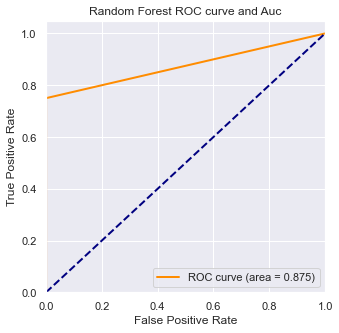

In [69]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs = rf_gs_model.fit(X_train, y_train).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf_gs,tpr_rf_gs,threshold_rf_gs = roc_curve(np.ravel(y_test), y_score_rf_gs) ###计算真正率和假正率
roc_auc_rf_gs = auc(fpr_rf_gs,tpr_rf_gs) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs, tpr_rf_gs, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [140]:
rf_random = RandomizedSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random.fit(X_train, np.ravel(y_train))
y_pred_random = rf_random.predict(X_test)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.1s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=16; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=16; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=10, n_estimators=8; total time=   0.1s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=10; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=2, min_samples_split=10, n_estimators=16; total 

In [141]:
rf_random.best_estimator_

RandomForestClassifier(max_depth=5, max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=10, n_estimators=16, random_state=42)

In [40]:
rf_random_model=RandomForestClassifier(max_depth=10, min_samples_leaf=2, min_samples_split=10,
                       n_estimators=9, random_state=42)
rf_random_model.fit(X_train, np.ravel(y_train))
y_pred_random = rf_random_model.predict(X_test)

In [73]:
print("Randomized Grid Search Validation Data")
cm_rf_random = confusion_matrix(y_test, y_pred_random)                               
print("Randomized Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_rf_random)
print('-----------------------')
cr_rf_random = classification_report(y_test, y_pred_random)
print("Randomized Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_rf_random)
print('------------------------')
print("Randomized Grid Search AUC Score " +" Validation Data")
auc_rf_random = roc_auc_score(y_test, y_pred_random)       
print("AUC Score " + str(auc_rf_random))                                       # Displaying the AUC score
print("Randomized Grid Search Recall " +" Validation Data")
rec_rf_random = recall_score(y_test, y_pred_random)
print("Recall "+ str(rec_rf_random))                                           # Displaying the Recall score

Randomized Grid Search Validation Data
Randomized Grid Search Confusion Matrix  Validation Data
[[40  0]
 [ 2  6]]
-----------------------
Randomized Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.95      1.00      0.98        40
           1       1.00      0.75      0.86         8

    accuracy                           0.96        48
   macro avg       0.98      0.88      0.92        48
weighted avg       0.96      0.96      0.96        48

------------------------
Randomized Grid Search AUC Score  Validation Data
AUC Score 0.875
Randomized Grid Search Recall  Validation Data
Recall 0.75


In [74]:
## train set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_train = rf_random_model.predict(X_train)
print("Random Forest Conclusion for NORMAL Dataset of train set")
print('Precision:         ',precision_score(y_train, rf_random_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train, y_pred=rf_random_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train, y_pred=rf_random_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train,y_pred=rf_random_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train, rf_random_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for NORMAL Dataset of train set
Precision:          0.9090909090909091
F1-Score:           0.9128965358322452
Accuracy Scores:    0.9567901234567902
Recall Scores:      0.8927007299270073
Sensitivity:        0.8
Specificity:        0.9854014598540146


In [75]:
## test set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_test = rf_random_model.predict(X_test)
print("Random Forest Conclusion for NORMAL Dataset of test set")
print('Precision:         ',precision_score(y_test, rf_random_prediction_test))
print('F1-Score:          ',f1_score(y_true=y_test, y_pred=rf_random_prediction_test, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test, y_pred=rf_random_prediction_test))
print('Recall Scores:     ',recall_score(y_true=y_test,y_pred=rf_random_prediction_test,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test, rf_random_prediction_test).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for NORMAL Dataset of test set
Precision:          1.0
F1-Score:           0.9163763066202091
Accuracy Scores:    0.9583333333333334
Recall Scores:      0.875
Sensitivity:        0.75
Specificity:        1.0


In [76]:
## validation set
rf_random_model.fit(X_train,y_train)
rf_random_prediction_val = rf_random_model.predict(X_val)
print("Random Forest Conclusion for NORMAL Dataset of val set")
print('Precision:         ',precision_score(y_val, rf_random_prediction_val))
print('F1-Score:          ',f1_score(y_true=y_val, y_pred=rf_random_prediction_val, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val, y_pred=rf_random_prediction_val))
print('Recall Scores:     ',recall_score(y_true=y_val,y_pred=rf_random_prediction_val,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val, rf_random_prediction_val).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for NORMAL Dataset of val set
Precision:          1.0
F1-Score:           0.9342403628117915
Accuracy Scores:    0.9655172413793104
Recall Scores:      0.9
Sensitivity:        0.8
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

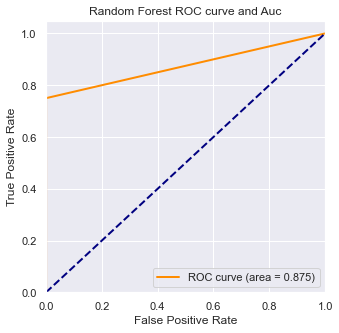

In [80]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random = rf_random_model.fit(X_train, np.ravel(y_train)).predict(X_test)

# Compute ROC curve and ROC area for each class
fpr_rf_random,tpr_rf_random,threshold_rf_random = roc_curve(np.ravel(y_test), y_score_rf_random) ###计算真正率和假正率
roc_auc_rf_random = auc(fpr_rf_random,tpr_rf_random) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random, tpr_rf_random, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [ ]:
rf_y_train_pred=rf_random.predict(X_train)
print('Accuracy score of train data :{}'.format(rf_random.score(X_train,y_train)))
print('Train data f1_Score:{}'.format(f1_score(y_train, rf_y_train_pred)))

rf_y_val_pred=rf_random.predict(X_val)
print('Accuracy score of validation  data :{}'.format(rf_random.score(X_val,y_val)))
print('validation data f1_Score:{}'.format(f1_score(y_val, rf_y_val_pred)))

Accuracy score of train data :0.9629629629629629
Train data f1_Score:0.8749999999999999
Accuracy score of validation  data :0.9655172413793104
validation data f1_Score:0.888888888888889


Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s
[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s[CV] END max_depth=15, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=14; total time=   0.0s

[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=13; total time=   0.0s
[CV] END max_depth=30, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=17; total time=   0.0s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=13

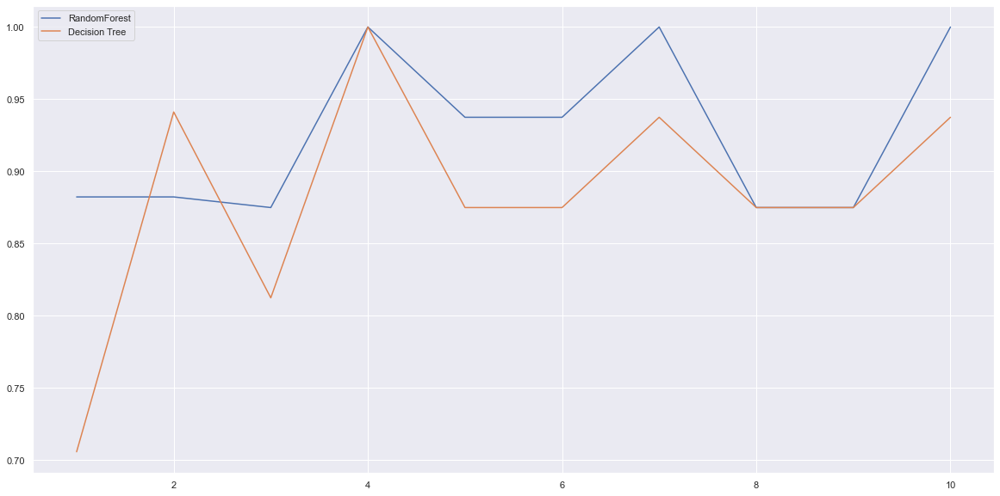

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s=cross_val_score(rf_random,X_train,np.ravel(y_train),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s=cross_val_score(dt,X_train,np.ravel(y_train),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s,label="RandomForest")
plt.plot(range(1,11),clf_s,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total time=   0.0s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=40, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=13; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=4, min_samples_split=5, n_estimators=17; total time=   0.1s
[CV] END max_depth=30, max_features=auto, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total 

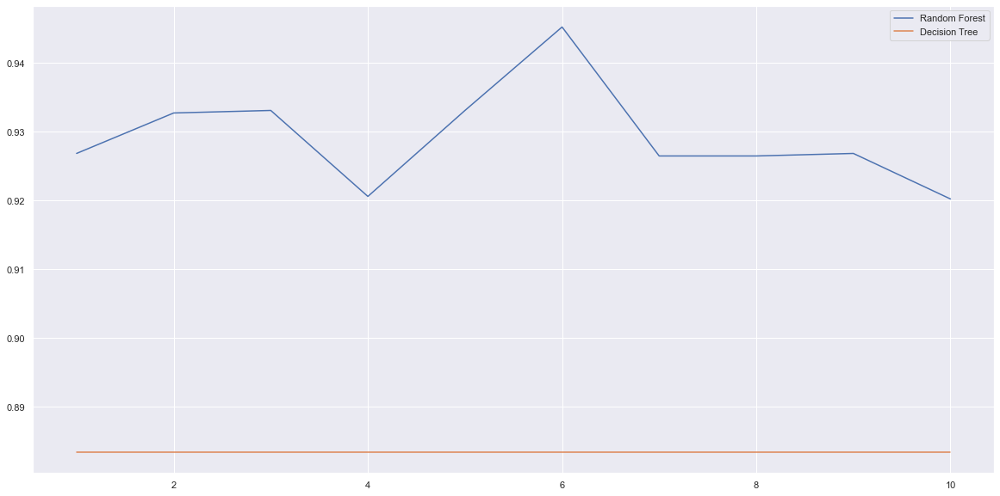

In [ ]:
rfc_l = []
clf_l = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s = cross_val_score(rf_random,X_train,np.ravel(y_train),cv=10).mean()
  rfc_l.append(rfc_s)
  # clf = DecisionTreeClassifier()
  clf_s = cross_val_score(dt,X_train,np.ravel(y_train),cv=10).mean()
  clf_l.append(clf_s)
 
plt.plot(range(1,11),rfc_l,label = "Random Forest")
plt.plot(range(1,11),clf_l,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred=rf_random.predict(X_train)
print('Accuracy score of train data :{}'.format(rf_random.score(X_train,y_train)))
print('Train data f1_Score:{}'.format(f1_score(y_train, rf_y_train_pred)))

rf_y_val_pred=rf_random.predict(X_val)
print('Accuracy score of validation  data :{}'.format(rf_random.score(X_val,y_val)))
print('validation data f1_Score:{}'.format(f1_score(y_val, rf_y_val_pred)))

Accuracy score of train data :0.9629629629629629
Train data f1_Score:0.8749999999999999
Accuracy score of validation  data :0.9655172413793104
validation data f1_Score:0.888888888888889


Random forest accuracy increases from 96% to 98% using cross validation score

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [84]:
# Evaluate the permutation importance 
perm = PermutationImportance(dt, random_state=101).fit(X_test, y_test) 
# Display the weights of each features     
eli5.show_weights(perm, feature_names = X_test.columns.values)                    

Weight,Feature
0.1125 ± 0.1074,f(458.5020)
0.0667 ± 0.0408,f(226.0000)
0.0625 ± 0.0589,f(1090.5077)
0.0417 ± 0.0527,f(577.6763)
0.0417 ± 0.0000,f(1155.3527)
0.0250 ± 0.0167,f(5993.2283)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)
0 ± 0.0000,f(7127.1897)


Lets check the same with Random Forest classifier

In [83]:
perm = PermutationImportance(rf_random_model, random_state=101).fit(X_test, y_test)
eli5.show_weights(perm, feature_names = X_test.columns.values)

Weight,Feature
0.0208 ± 0.0000,f(1029.3022)
0.0167 ± 0.0167,f(1155.3527)
0.0125 ± 0.0204,f(1296.8396)
0.0042 ± 0.0167,f(408.4789)
0.0042 ± 0.0167,f(6727.1713)
0 ± 0.0000,f(226.0000)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(2310.7054)
0 ± 0.0000,f(7127.1897)


Conclusion: The columns in the green are the most important features.

### Shap


#### Lets see how the columns impact a single record of data

In [156]:
row_to_show = 7                               # The row for which we want to check the SHAP explanations
data_to_predict = X_test.iloc[row_to_show]    # data_to_predict

In [157]:
data_to_preddict_array = data_to_predict.values.reshape(1,-1)

rf_random_model.predict_proba(data_to_preddict_array) # Prediction probability on the row of the data


array([[0.93518519, 0.06481481]])

In [158]:
# Predicted output
rf_random_model.predict(data_to_preddict_array)                                       

array([0])

In [159]:
y_test.iloc[row_to_show]

OverallPoF    0
Name: 7, dtype: int64

In [160]:
# Object that can calculate Shap values
explainer_single = shap.TreeExplainer(rf_random_model)                                       # SHAP Tree Explainer

# Calculate the shap values
shap_values_single = explainer_single.shap_values(data_to_predict)                           # SHAP explanations

In [161]:
shap_values_single[0]

array([-2.13727639e-02,  1.59620834e-03, -2.64349864e-02,  1.54162016e-02,
       -4.16186641e-05,  2.98359515e-02, -1.91155694e-03,  1.01739598e-03,
        0.00000000e+00,  2.20458554e-03,  2.26416504e-02, -1.38515831e-02,
        1.46615523e-03,  0.00000000e+00,  5.57322842e-03,  8.90526129e-04,
        2.09090884e-02,  1.30821631e-02,  1.46898797e-02,  1.21358396e-02])

The SHAP model is built on a training data set and the mean of the predictor variables is known by X_train.mean().

In [162]:
X_train.mean()

f(408.4789)     0.157228
f(2593.6791)    0.714201
f(2378.4142)    0.671814
f(2310.7054)    0.642294
f(7127.1897)    0.171181
f(865.5366)     0.438744
f(6727.1713)    0.187232
f(226.0000)     0.059134
f(458.5020)     0.152443
f(500.0000)     0.194293
f(1029.3022)    0.507143
f(5993.2283)    0.264659
f(1887.7486)    0.654320
f(1373.9536)    0.567056
f(667.4199)     0.325357
f(2747.9073)    0.727463
f(1296.8396)    0.560115
f(577.6763)     0.261308
f(1155.3527)    0.537144
f(1090.5077)    0.536943
dtype: float64

In [130]:
y_test.mean()

OverallPoF    0.166667
dtype: float64

The force plot is an interpretation of the predictions for a single sample which visualises shap values as forces, each feature value is a force that increases or decreases the prediction, the prediction starts from a baseline which is the constant of the explanatory model and each attributed value is an arrow that increases (positive) or decreases (negative) the prediction. Features that push the prediction higher (to the right) are shown in red and those that push the prediction lower are shown in blue.

In [163]:
shap.initjs()
shap.force_plot(explainer_single.expected_value[1], shap_values_single[1], data_to_predict)

The data in the eighth row of the predicted output is known to be 0, and the true value is also 0, so the prediction is correct. The figure can be interpreted as the frequency f(2378.4142) having the largest positive contribution, followed by f(408.4789), but f(865.5366) has a large negative contribution, followed by f(1029.3022), meaning that when the values of frequencies such as f(2378.4142), f(408.4789) are lower than their corresponding mean values, and when f( 865.5366), f(1029.3022) and other frequencies are higher than the mean of the training data set, the probability that the sample has an ear with conductive condition is only 0.06.

#### Each feature affects the results

The above are all interpretations for individual instances; the next plots are for all instances.

In [41]:
rf_random_model

RandomForestClassifier(max_depth=10, min_samples_leaf=2, min_samples_split=10,
                       n_estimators=9, random_state=42)

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 5.96 µs


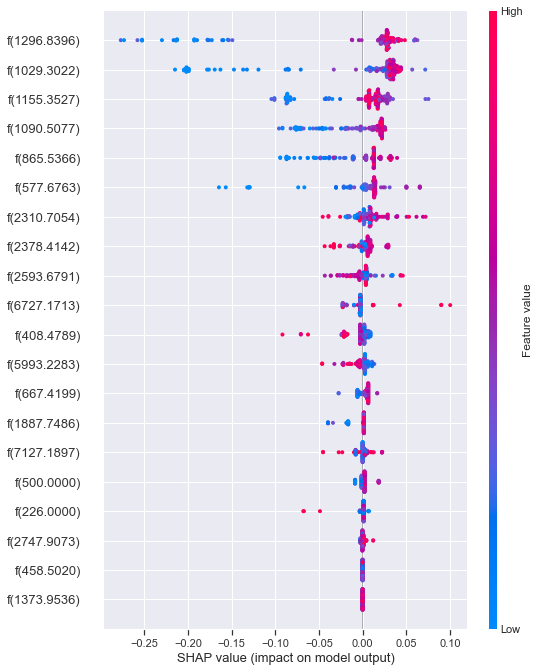

In [42]:
%time
# samples = X_train
samples = X_train

explainer = shap.TreeExplainer(rf_random_model)
shap_values = explainer.shap_values(samples, approximate=False, check_additivity=False)

shap.summary_plot(shap_values[0], samples)

CPU times: user 2 µs, sys: 1e+03 ns, total: 3 µs
Wall time: 5.01 µs


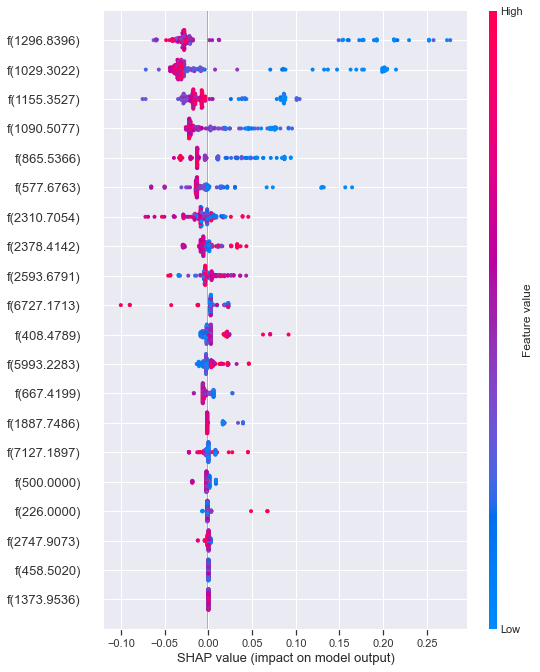

In [43]:
%time
# samples = X_train
samples = X_train

explainer = shap.TreeExplainer(rf_random_model)
shap_values = explainer.shap_values(samples, approximate=False, check_additivity=False)

shap.summary_plot(shap_values[1], samples)

First is the SHAP value plot, which further shows the positive and negative relationship between the predictor variables and the target variables to get the magnitude of the effect of the feature on the prediction, which is equivalent to rotating each feature of the force plot by 90 degrees and drawing it as a point plot. The effect of the size of the feature on the results is indicated by the colour (red for large values, blue for small values and purple adjacent to the mean), the wider the distribution of the area the greater its influence, thus frequencies such as f(1296.8396),f(1029.3022),f(1155.3527) have a high and positive influence, 'high ' from the red and 'negative' influences shown on the x-axis. Similarly we would say that f(2378.4142),f(2593.6791) is positively associated with diagnosing patients ear with conductive condition.

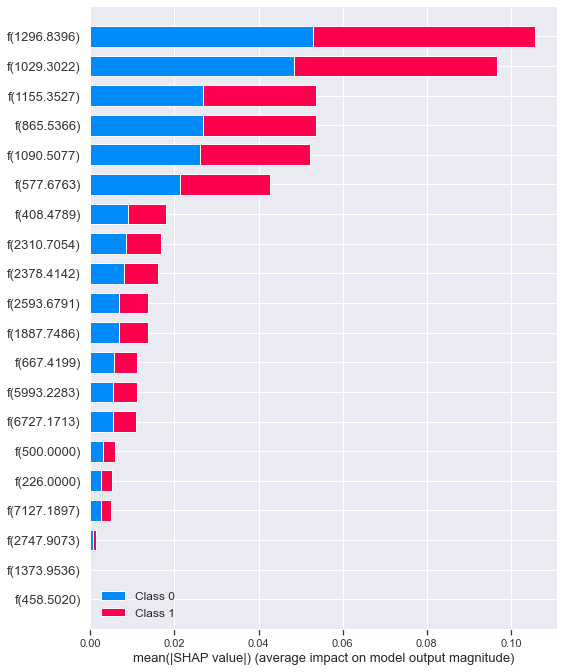

In [137]:
shap.summary_plot(shap_values, X_train)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

Based on the SHAP summary plots, we can use them to indicate the top 20 features seen and the relationship between feature values and impact to classify the model. For a better understanding, let's look at the dependency graph.

In [101]:
def make_shap_waterfall_plot(shap_values, features, num_display=20):
    
    '''
    A function for building a SHAP waterfall plot.
    
    SHAP waterfall plot is used to visualize the most important features in a descending order.
    
    Parameters:
    shap_values (list): SHAP values obtained from a model
    features (pandas DataFrame): a list of features used in a model
    num_display(int): number of features to display
    
    Returns:
    matplotlib.pyplot plot: SHAP waterfall plot
    
    '''
    
    column_list = features.columns
    feature_ratio = (np.abs(shap_values).sum(0) / np.abs(shap_values).sum()) * 100
    column_list = column_list[np.argsort(feature_ratio)[::-1]]
    feature_ratio_order = np.sort(feature_ratio)[::-1]
    cum_sum = np.cumsum(feature_ratio_order)
    column_list = column_list[:num_display]
    feature_ratio_order = feature_ratio_order[:num_display]
    cum_sum = cum_sum[:num_display]
    
    num_height = 0
    if (num_display >= 20) & (len(column_list) >= 20):
        num_height = (len(column_list) - 20) * 0.4
        
    fig, ax1 = plt.subplots(figsize=(8, 8 + num_height))
    ax1.plot(cum_sum[::-1], column_list[::-1], c='blue', marker='o')
    ax2 = ax1.twiny()
    ax2.barh(column_list[::-1], feature_ratio_order[::-1], alpha=0.6)
    
    ax1.grid(True)
    ax2.grid(False)
    ax1.set_xticks(np.arange(0, round(cum_sum.max(), -1)+1, 10))
    ax2.set_xticks(np.arange(0, round(feature_ratio_order.max(), -1)+1, 10))
    ax1.set_xlabel('Cumulative Ratio')
    ax2.set_xlabel('Composition Ratio')
    ax1.tick_params(axis="y", labelsize=13)
    plt.ylim(-1, len(column_list))

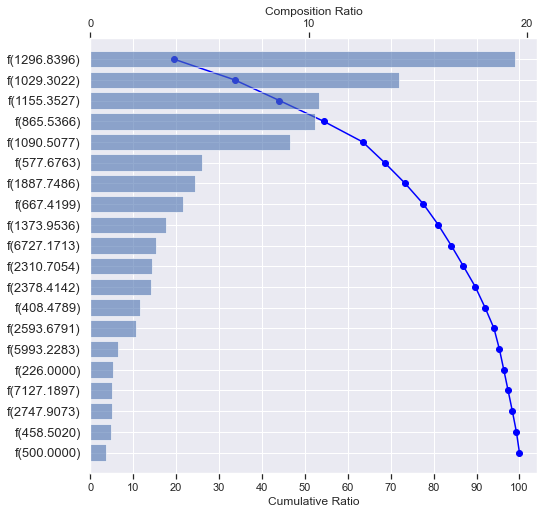

In [148]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values[0], samples)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 60% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

Whether features are positively or negatively correlated, using the force function allows the contribution of features from multiple instances to be plotted on a single graph.

In [164]:
shap.force_plot(explainer.expected_value[1], shap_values[1], samples)


### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(X_train.values,
                                                         feature_names=X_train.columns.values.tolist(),
                                                         mode='classification',class_names='Attack')

In [ ]:
lime_expln1=explainer.explain_instance(X_test.iloc[1],dt_model.predict_proba,num_features=X_test.shape[1], top_labels = 1)
lime_expln1.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

In [207]:
# Create a function to generating the prediction results on both the training and test sets
def pred_plot(y_true,y_pred):
    plt.plot(t, y_true, 'r-', linewidth=2, label='true') #t is the abscissa scale
    plt.plot(t, y_pred, 'g-', linewidth=2, label='pred')
    plt.legend(loc = 'lower right')
    plt.grid(visible=True)

The Prediction Results on Testing Set:


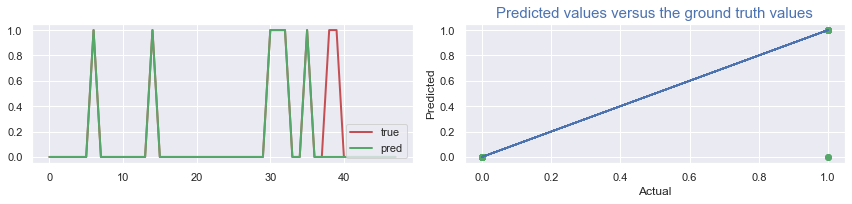

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test))
pred_plot(np.ravel(y_test), np.ravel(y_pred_random)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test), np.ravel(y_test))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test), np.ravel(y_pred_random),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - Oversampling dataset

## Model Choosing 

### Decision Tree

#### before gridsearch

In [93]:
dt_over_large = DecisionTreeClassifier(random_state=42)

The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [94]:
dt_over_large.fit(X_train_over_large, y_train_over_large)

DecisionTreeClassifier(random_state=42)

In [95]:
## train set
dt_over_large.fit(X_train_over_large,y_train_over_large)
dt_over_large_prediction_train = dt_over_large.predict(X_train_over_large)
print("Random Forest Conclusion for Oversampled Dataset of trainidation set")
print('Precision:         ',precision_score(y_train_over_large, dt_over_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_over_large,y_pred=dt_over_large_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train_over_large, dt_over_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [144]:
## train set
dt_over_large.fit(X_train_over,y_train_over)
dt_over_prediction_train = dt_over_large.predict(X_train_over)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train_over, dt_over_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over, y_pred=dt_over_prediction_train, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over, y_pred=dt_over_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_over,y_pred=dt_over_prediction_train,average='macro')) # 也可以指定micro模式
tn, fp, fn, tp = confusion_matrix(y_train_over, dt_over_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [96]:
## test set
y_pred_dt_over_large = dt_over_large.predict(X_test_over_large)
print("Decision Tree Conclusion for Oversampled Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_dt_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [97]:
## validation set
y_valpred_dt_over_large = dt_over_large.predict(X_val_over_large)
print("Decision Tree Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Original Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

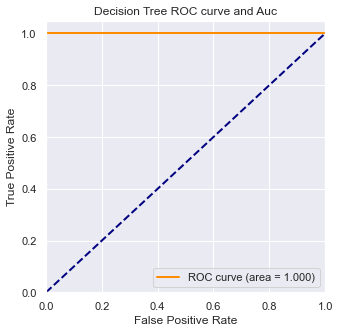

In [98]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_over_large = dt_over_large.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_dt_over_large,tpr_dt_over_large,threshold_dt_over_large = roc_curve(np.ravel(y_test_over_large), y_score_dt_over_large) ###计算真正率和假正率
roc_auc_dt_over_large = auc(fpr_dt_over_large,tpr_dt_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_over_large, tpr_dt_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

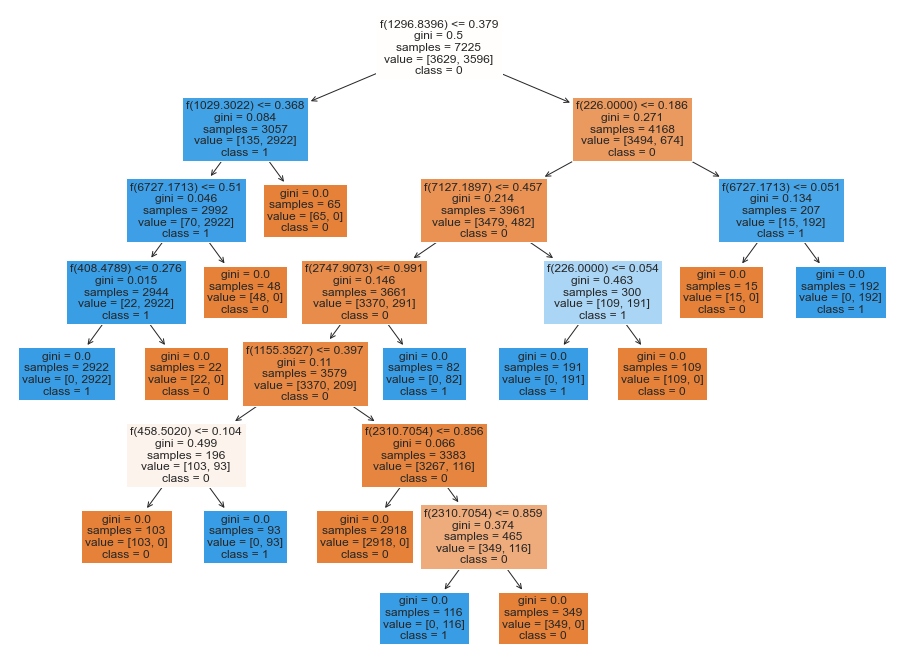

In [99]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_over_large.fit(X_train_over_large,y_train_over_large)
predictions_dt_over_large = dt_over_large.predict(X_test_over_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_over = plot_tree(dt_over_large, feature_names=X_train_over_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

#### Decision Tree GridSearch

In [100]:
paramGride = dict(
    max_depth = [3,5,6,7,8,10,15,None],
    max_leaf_nodes = [3,5,6,7,8,10,12,15,None])

dtModel_over = DecisionTreeClassifier()

dt_over_grid = GridSearchCV(
    dtModel_over,paramGride,cv = 3,return_train_score = True)
dt_over_grid = dt_over_grid.fit(X_train_over_large,y_train_over_large)

In [101]:
print('best_score:%f'% dt_over_grid.best_score_)
print('best parameter:')

for key in dt_over_grid.best_params_.keys():
    print('%s = %s'%(key,dt_over_grid.best_params_[key]))

best_score:1.000000
best parameter:
max_depth = 8
max_leaf_nodes = None


In [102]:
dt_over_grid.best_estimator_

DecisionTreeClassifier(max_depth=8)

In [104]:
dt_over_grid_model = DecisionTreeClassifier(max_depth=8)

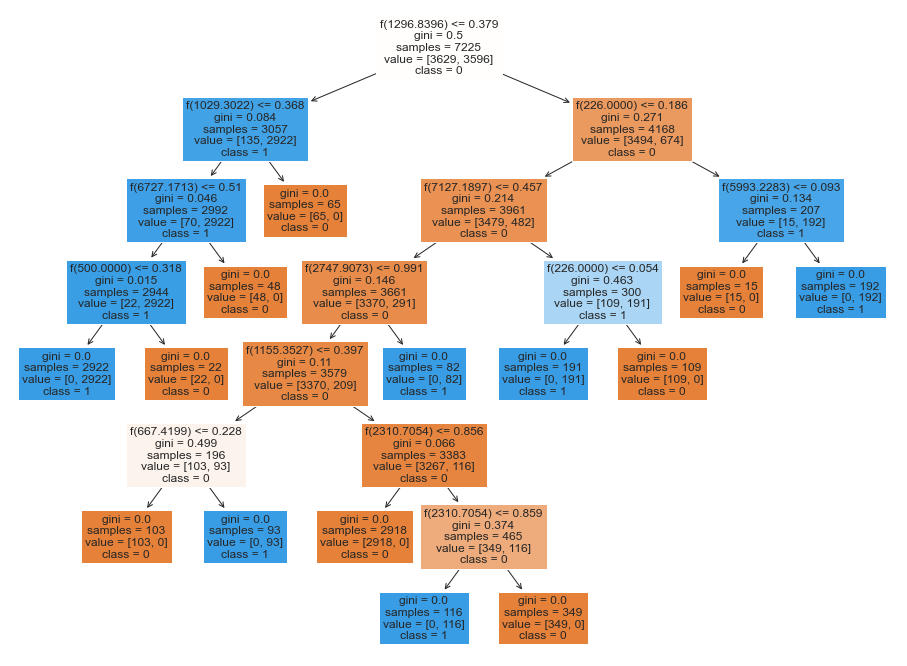

In [105]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_over_grid_model.fit(X_train_over_large,y_train_over_large)
predictions_dt_over_large_grid = dt_over_grid_model.predict(X_test_over_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_over_large = plot_tree(dt_over_grid_model, feature_names=X_train_over_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [106]:
## train set
dt_over_grid_model.fit(X_train_over_large,y_train_over_large)
dt_over_large_prediction_train = dt_over_grid_model.predict(X_train_over_large)
print("Decision Tree Conclusion for over Dataset of train set")
print('Precision:         ',precision_score(y_train_over_large, dt_over_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over_large, y_pred=dt_over_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_over_large,y_pred=dt_over_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_over_large, dt_over_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for over Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [107]:
## test set
dt_over_grid_model.fit(X_train_over_large,y_train_over_large)
dt_over_large_prediction = dt_over_grid_model.predict(X_test_over_large)
print("Decision Tree Conclusion for over Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, dt_over_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=dt_over_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=dt_over_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=dt_over_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, dt_over_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for over Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [108]:
## validation set
y_valpred_dt_over_large = dt_over_grid_model.predict(X_val_over_large)
print("Decision Tree Conclusion for over Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for over Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

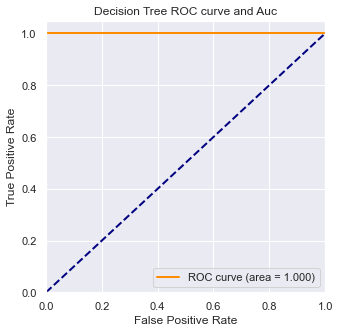

In [109]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_over_large = dt_over_grid_model.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_dt_over_large,tpr_dt_over_large,threshold_dt_over_large = roc_curve(np.ravel(y_test_over_large), y_score_dt_over_large) ###计算真正率和假正率
roc_auc_dt_over_large = auc(fpr_dt_over_large,tpr_dt_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_over_large, tpr_dt_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [172]:
rf_over_large = RandomForestClassifier(random_state = 42)

In [173]:
## train set
rf_over_large.fit(X_train_over_large,y_train_over_large)
rf_over_prediction_train = rf_over_large.predict(X_train_over_large)
print("Random Forest Conclusion for Original Dataset of trainidation set")
print('Precision:         ',precision_score(y_train_over_large, rf_over_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_over_large, y_pred=rf_over_prediction_train, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_over_large, y_pred=rf_over_prediction_train))
tn, fp, fn, tp = confusion_matrix(y_train_over_large, rf_over_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of trainidation set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Sensitivity:        1.0
Specificity:        1.0


In [174]:
## test set
y_pred_rf_over_large = rf_over_large.predict(X_test_over_large)
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_rf_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_rf_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_rf_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_rf_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_rf_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [175]:
## validation set
y_valpred_dt_over_large = dt_over_large.predict(X_val_over_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_dt_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_dt_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_dt_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_dt_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

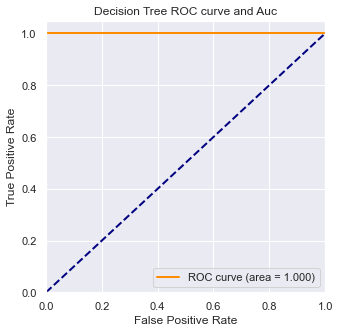

In [176]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_over_large = rf_over_large.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_over_large,tpr_rf_over_large,threshold_rf_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_over_large) ###计算真正率和假正率
roc_auc_rf_over_large = auc(fpr_rf_over_large,tpr_rf_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_over_large, tpr_rf_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [101]:
rf_y_train_pred_over_large = rf_over_large.predict(X_train_over_large)
print('Accuracy score of train data :{}'.format(rf_over_large.score(X_train_over_large,y_train_over_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_over_large, rf_y_train_pred_over_large)))

rf_y_val_pred_over_large = rf_over_large.predict(X_val_over_large)
print('Accuracy score of validation  data :{}'.format(rf_over_large.score(X_val_over_large,y_val_over_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_over_large, rf_y_val_pred_over_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :1.0
validation data f1_Score:1.0


### Grid Search

In [177]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_over_large = GridSearchCV(rf, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_over_large.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_over_large = rf_gs_over_large.predict(X_test_over_large)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s

In [178]:
rf_gs_over_large.best_estimator_

RandomForestClassifier(max_depth=5, n_estimators=6, random_state=42)

In [179]:
rf_gs_over_large_model=RandomForestClassifier(max_depth=5, n_estimators=6, random_state=42)
rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_gs_over_large = rf_gs_over_large_model.predict(X_test_over_large)

In [180]:
print("Grid Search Validation Data")
cm_over_large = confusion_matrix(y_test_over_large, y_pred_gs_over_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_over_large)
print('-----------------------')
cr_over_large = classification_report(y_test_over_large, y_pred_gs_over_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_over_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_over_large = roc_auc_score(y_test_over_large, y_pred_gs_over_large)       
print("AUC Score " + str(auc_over_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_over_large = recall_score(y_test_over_large, y_pred_gs_over_large)
print("Recall "+ str(rec_over_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [181]:
## test set
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_over_large, y_pred_gs_over_large))
print('F1-Score:          ',f1_score(y_true=y_test_over_large, y_pred=y_pred_gs_over_large, average='macro')) 
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_over_large, y_pred=y_pred_gs_over_large))
print('Recall Scores:     ',recall_score(y_true=y_test_over_large,y_pred=y_pred_gs_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_over_large, y_pred_gs_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [182]:
## validation set
y_valpred_gs_over_large = rf_gs_over_large_model.predict(X_val_over_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_gs_over_large))
# print(f1_score(y_true=y_val, y_valpred=y_valpred_gs_over_large, average='macro')) # 也可以指定micro模式
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_gs_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_gs_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_gs_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)


Random Forest Conclusion for Original Dataset of val set
Precision:          1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

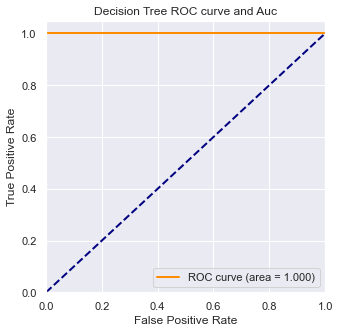

In [108]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_over_large = rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_over_large,tpr_rf_gs_over_large,threshold_rf_gs_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_gs_over_large) ###计算真正率和假正率
roc_auc_rf_gs_over_large = auc(fpr_rf_gs_over_large,tpr_rf_gs_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_over_large, tpr_rf_gs_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

超参数优化也就是常说的调参，python-sklearn里常用的有GridSearchCV和RandomizedSearchCV可以用。其中GridSearchCV的原理很简明，就是程序去挨个尝试每一组超参数，然后选取最好的那一组。可以想象，这个是比较费时间的，面临着维度灾难。因此James Bergstra和Yoshua Bengio在2012年提出了超参数优化的RandomSearch方法。

（2）RandomizedSearchCV是在论文的基础上加入了cross-validation

In [183]:
rf_random_over_large = RandomizedSearchCV(rf_over_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_over_large.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_over_large = rf_random_over_large.predict(X_test_over_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=6; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=6; total time=   0.2s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5; total time=   0.2s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=1, min_samples_split=5, n_estimators=5; total time=   0.2s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=5, n_estimators=6; total time=   0.2s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=8; total time=   0.2s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=8; total time=   0.2s
[CV] END max_depth=20, max_features=auto, min_samples_leaf=1, min_samples_split=10, n_estimators=8; total time=

In [184]:
rf_random_over_large.best_estimator_

RandomForestClassifier(max_depth=20, min_samples_split=10, n_estimators=8,
                       random_state=42)

In [185]:
rf_random_over_large_model = RandomForestClassifier(max_depth=20, min_samples_split=10, n_estimators=8,
                       random_state=42)
rf_random_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large))
y_pred_random_over_large = rf_random_over_large_model.predict(X_test_over_large)

In [186]:
print("Grid Search Validation Data")
cm_over_large = confusion_matrix(y_test_over_large, y_pred_gs_over_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_over_large)
print('-----------------------')
cr_over_large = classification_report(y_test_over_large, y_pred_gs_over_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_over_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_over_large = roc_auc_score(y_test_over_large, y_pred_gs_over_large)       
print("AUC Score " + str(auc_over_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_over_large = recall_score(y_test_over_large, y_pred_gs_over_large)
print("Recall "+ str(rec_over_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[750   0]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       750
           1       1.00      1.00      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 1.0
Grid Search Recall  Validation Data
Recall 1.0


In [120]:
y_valpred_random_over_large = rf_random_over_large_model.predict(X_val_over_large)
print("Random Forest Conclusion for Over Dataset of val set")
print('Precision:         ',precision_score(y_val_over_large, y_valpred_random_over_large))
print('F1-Score:          ',f1_score(y_true=y_val_over_large, y_pred=y_valpred_random_over_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_over_large, y_pred=y_valpred_random_over_large))
print('Recall Scores:     ',recall_score(y_true=y_val_over_large,y_pred=y_valpred_random_over_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_over_large, y_valpred_random_over_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)


Random Forest Conclusion for Over Dataset of val set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


<Figure size 1440x720 with 0 Axes>

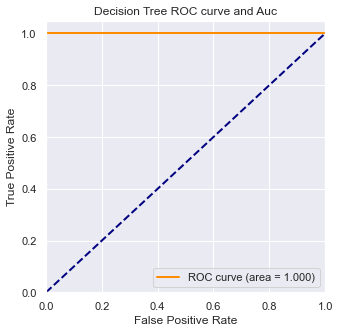

In [121]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_over_large = rf_gs_over_large_model.fit(X_train_over_large, np.ravel(y_train_over_large)).predict(X_test_over_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_over_large,tpr_rf_gs_over_large,threshold_rf_gs_over_large = roc_curve(np.ravel(y_test_over_large), y_score_rf_gs_over_large) ###计算真正率和假正率
roc_auc_rf_gs_over_large = auc(fpr_rf_gs_over_large,tpr_rf_gs_over_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_over_large, tpr_rf_gs_over_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_over_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [188]:
perm_over_large = PermutationImportance(dt_over_large, random_state=101).fit(X_test_over_large, y_test_over_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_over_large, feature_names = X_test_over_large.columns.values) # Display the weights of each features

Weight,Feature
0.2296 ± 0.0161,f(1296.8396)
0.2287 ± 0.0108,f(1029.3022)
0.1777 ± 0.0200,f(1155.3527)
0.0559 ± 0.0054,f(226.0000)
0.0352 ± 0.0047,f(7127.1897)
0.0283 ± 0.0039,f(6727.1713)
0.0239 ± 0.0052,f(408.4789)
0.0175 ± 0.0010,f(2747.9073)
0.0160 ± 0.0040,f(2310.7054)
0.0129 ± 0.0038,f(458.5020)


Lets check the same with Random Forest classifier

In [187]:
perm_over_large = PermutationImportance(rf_random_over_large_model, random_state=101).fit(X_test_over_large, y_test_over_large)
eli5.show_weights(perm_over_large, feature_names = X_test_over_large.columns.values)

Weight,Feature
0.2513 ± 0.0138,f(1029.3022)
0.2421 ± 0.0112,f(1296.8396)
0.0244 ± 0.0032,f(408.4789)
0.0112 ± 0.0030,f(7127.1897)
0.0080 ± 0.0021,f(577.6763)
0.0056 ± 0.0038,f(2310.7054)
0 ± 0.0000,f(226.0000)
0 ± 0.0000,f(2593.6791)
0 ± 0.0000,f(2378.4142)
0 ± 0.0000,f(865.5366)


Conclusion: The columns in the green are the most important features.

### Shap

#### Lets see how the columns impact a single record of data

In [196]:
row_to_show = 20                                      # The row for which we want to check the SHAP explanations
data_to_predict_over_large = X_test_over_large.iloc[row_to_show] # data_to_predict

In [335]:
data_to_preddict_array_over_large = data_to_predict_over_large.values.reshape(1,-1)
# Prediction probability on the row of the data
rf_random_over_large_model.predict_proba(data_to_preddict_array_over_large)  

array([[1., 0.]])

In [336]:
rf_random_over_large_model.predict(data_to_preddict_array_over_large)                                       # Predicted output

array([0])

In [337]:
y_test_over_large.iloc[row_to_show]

OverallPoF    0
Name: 1497, dtype: int64

In [338]:
# Object that can calculate Shap values
explainer_over_large = shap.TreeExplainer(rf_random_over_large_model)     # SHAP Tree Explainer

# Calculate the shap values
shap_values_over_large = explainer_over_large.shap_values(data_to_predict_over_large) # SHAP explanations

In [339]:
shap.initjs()
shap.force_plot(explainer_over_large.expected_value[1], shap_values_over_large[1], data_to_predict_over_large)

The predicted output is known to be 0, and the true value is also 0, so the prediction is correct. The predicted value of the model is 0.06 close to 0, which can be interpreted by the figure as only the frequency f1887.7486) makes a positive contribution to the result, with f(1029.3022) making a large negative contribution, followed by f(865.5366), meaning that when the value of f(f1887.7486) is lower than their corresponding mean, and f(865.5366), f( 1029.3022), etc. have frequencies above the mean of the training data set, the probability of that sample having an ear with conductive condition is 0.00.

#### Each feature affects the results

The above are all interpretations for individual instances; the next plots are for all instances.

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 6.2 µs


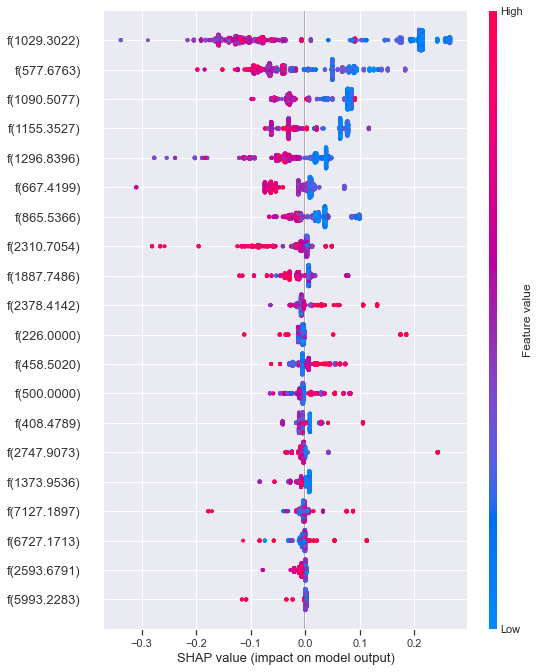

In [340]:
%time
# samples = X_train_over_large
samples_over_large = X_test_over_large

explainer_over_large = shap.TreeExplainer(rf_gs_over_large_model)
shap_values_over_large = explainer_over_large.shap_values(samples_over_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_over_large[1], samples_over_large)

First is the SHAP value plot, which further shows the positive and negative relationship between the predictor variables and the target variables to get the magnitude of the effect of the feature on the prediction, which is equivalent to rotating each feature of the force plot by 90 degrees and drawing it as a point plot. The effect of the size of the feature on the results is indicated by the colour (red for large values, blue for small values and purple adjacent to the mean), the wider the distribution of the area the greater its influence, thus frequencies such as f(1029.3022),f(577.6763),f(1090.5077) have a high and positive influence, 'high ' from the red and 'negative' influences shown on the x-axis. Similarly we would say that f(2378.4142),f(2593.6791) is positively associated with diagnosing patients ear with conductive condition.

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

Based on the SHAP summary plots, we can use them to indicate the top 20 features seen and the relationship between feature values and impact to classify the model. For a better understanding, let's look at the dependency graph.

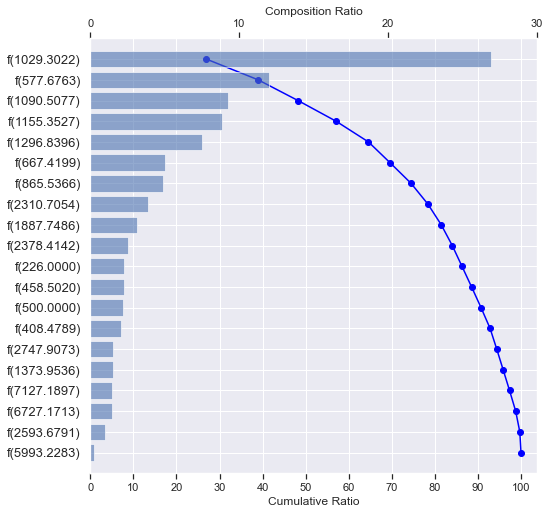

In [204]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_over_large[1], samples_over_large)

Based on the SHAP waterfall plot, we can say that f(1029.3022) is the most important frequency in the model, which almost reach 30% of the model's explainability. Also, these top 20 frequencies have provided 100% of the model's interpretation.

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。Feature contribution

In [205]:
shap.force_plot(explainer_over_large.expected_value[1], shap_values_over_large[1], samples_over_large)

### LIME

In [ ]:
# import lime
# import lime.lime_tabular

In [ ]:
# explainer_over = lime.lime_tabular.LimeTabularExplainer(X_train_over.values,
#                                                          feature_names=X_train_over.columns.values.tolist(),
#                                                          mode='classification',class_names='Attack')

In [ ]:
# lime_expln1_over=explainer_over.explain_instance(X_test_over.iloc[1],dt_model_over.predict_proba,num_features=X_test_over.shape[1], top_labels = 1)
# lime_expln1_over.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


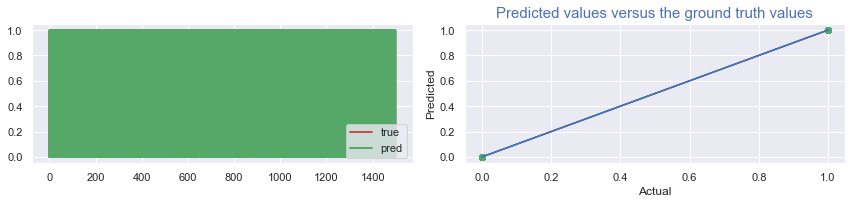

In [208]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_over_large))
pred_plot(np.ravel(y_test_over_large), np.ravel(y_pred_over_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_over_large), np.ravel(y_test_over_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_over_large), np.ravel(y_pred_over_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - SMOTE dataset

## Model Choosing 

### Training Model Function

In [52]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_smote_large_train(model_smote_large, name):
    model_smote_large.fit(X_train_smote_large, y_train_smote_large)     # Fitting the model_smote_large
    y_pred_smote_large = model_smote_large.predict(X_test_smote_large)  # Making prediction from the trained model_smote_large
    cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_smote_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")          # Displaying the Confusion Matrix
    print(cm_smote_large)
    print('-----------------------')
    print('-----------------------')
    cr_smote_large = classification_report(y_test_smote_large, y_pred_smote_large)
    print(name +" Classification Report " +" Validation Data")          # Displaying the Classification Report
    print(cr_smote_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_smote_large)       
    print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_smote_large = recall_score(y_test_smote_large, y_pred_smote_large)
    print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score
    return auc_smote_large, rec_smote_large, model_smote_large

### Decision Tree

#### before grid search

In [53]:
dt_smote_large = DecisionTreeClassifier(random_state=42)

In [54]:
dt_auc_smote_large, dt_rec_smote_large, dt_model_smote_large = model_smote_large_train(dt_smote_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[738  12]
 [  7 743]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      0.98      0.99       750
           1       0.98      0.99      0.99       750

    accuracy                           0.99      1500
   macro avg       0.99      0.99      0.99      1500
weighted avg       0.99      0.99      0.99      1500

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.9873333333333334
Decision Tree Recall  Validation Data
Recall 0.9906666666666667


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

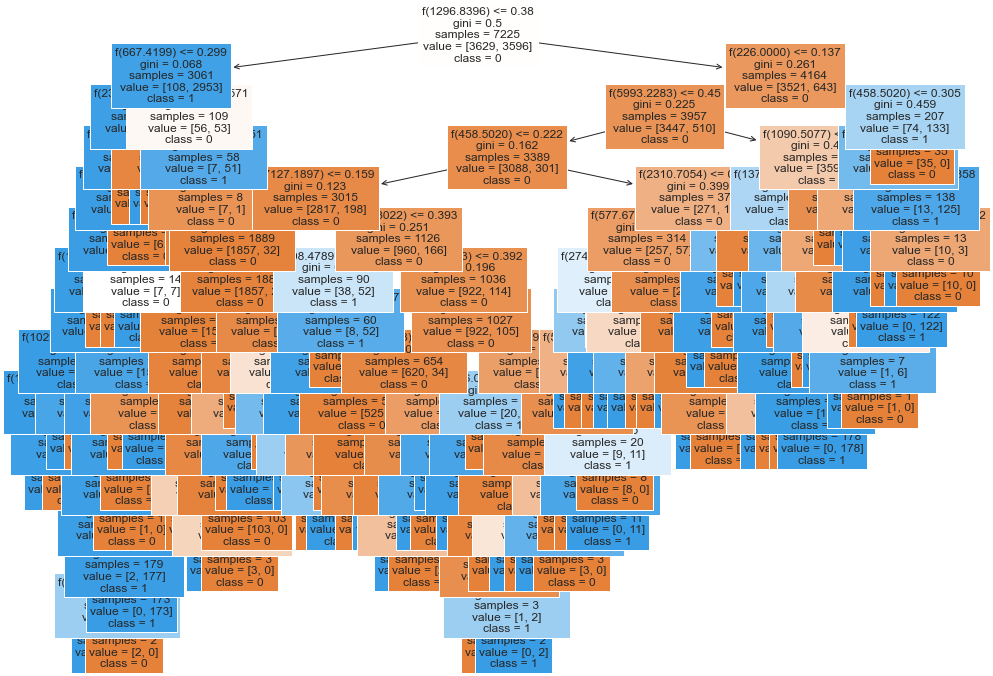

In [55]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
predictions_dt_smote_large = dt_smote_large.predict(X_test_smote_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_smote_large = plot_tree(dt_smote_large, feature_names=X_train_smote_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [213]:
## train set
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction_train = dt_smote_large.predict(X_train_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, dt_smote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=dt_smote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, dt_smote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [214]:
## test set
dt_smote_large.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction = dt_smote_large.predict(X_test_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, dt_smote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=dt_smote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, dt_smote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of test set
Precision:          0.9841059602649007
F1-Score:           0.9873331925910289
Accuracy Scores:    0.9873333333333333
Recall Scores:      0.9873333333333334
Sensitivity:        0.9906666666666667
Specificity:        0.984


In [215]:
## validation set
y_valpred_dt_smote_large = dt_smote_large.predict(X_val_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_dt_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_dt_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_dt_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of val set
Precision:          0.99079754601227
F1-Score:           0.9890131128651831
Accuracy Scores:    0.9890196078431372
Recall Scores:      0.9890528741745335
Sensitivity:        0.9877675840978594
Specificity:        0.9903381642512077


<Figure size 1440x720 with 0 Axes>

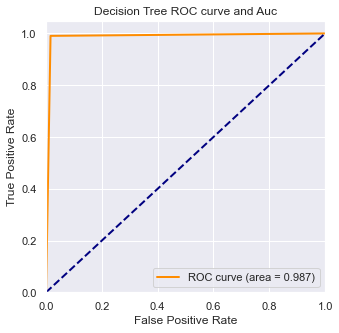

In [130]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_smote_large = dt_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_dt_smote_large,tpr_dt_smote_large,threshold_dt_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_dt_smote_large) ###计算真正率和假正率
roc_auc_dt_smote_large = auc(fpr_dt_smote_large,tpr_dt_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_smote_large, tpr_dt_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

#### Decision Tree GridSearch

In [131]:
paramGride = dict(
    max_depth = [3,5,6,7,8,10,15],
    max_leaf_nodes = [3,5,6,7,8,10,12,15])

dtModel_smote = DecisionTreeClassifier()

dt_smote_grid = GridSearchCV(
    dtModel_smote,paramGride,cv = 3,return_train_score = True)
dt_smote_grid = dt_smote_grid.fit(X_train_smote_large,y_train_smote_large)

In [132]:
print('best_score:%f'% dt_smote_grid.best_score_)
print('best parameter:')

for key in dt_smote_grid.best_params_.keys():
    print('%s = %s'%(key,dt_smote_grid.best_params_[key]))

best_score:0.943391
best parameter:
max_depth = 8
max_leaf_nodes = 15


In [133]:
dt_smote_grid.best_estimator_

DecisionTreeClassifier(max_depth=8, max_leaf_nodes=15)

In [134]:
dt_smote_grid_model = DecisionTreeClassifier(max_depth=8, max_leaf_nodes=15)

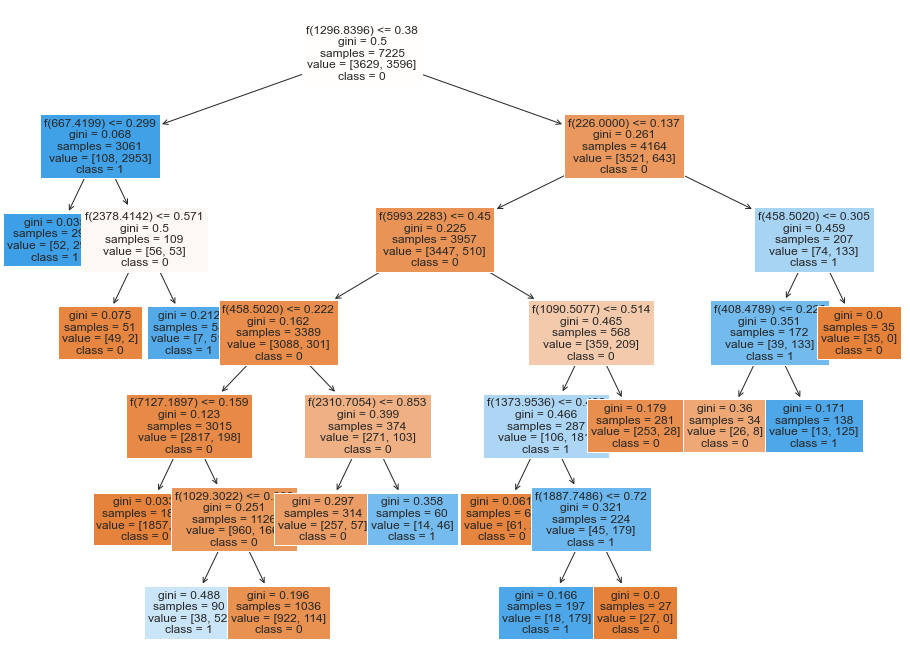

In [135]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_smote_grid_model.fit(X_train_smote_large,y_train_smote_large)
predictions_dt_smote_large_grid = dt_smote_grid_model.predict(X_test_smote_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_smote_large = plot_tree(dt_smote_grid_model, feature_names=X_train_smote_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [136]:
## train set
dt_smote_grid_model.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction_train = dt_smote_grid_model.predict(X_train_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, dt_smote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=dt_smote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=dt_smote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, dt_smote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of train set
Precision:          0.9593705293276109
F1-Score:           0.9466944667011954
Accuracy Scores:    0.946712802768166
Recall Scores:      0.9466478399348224
Sensitivity:        0.9324249165739711
Specificity:        0.9608707632956738


In [137]:
## test set
dt_smote_grid_model.fit(X_train_smote_large,y_train_smote_large)
dt_smote_large_prediction = dt_smote_grid_model.predict(X_test_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, dt_smote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=dt_smote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=dt_smote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, dt_smote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of test set
Precision:          0.953168044077135
F1-Score:           0.9386509613127627
Accuracy Scores:    0.9386666666666666
Recall Scores:      0.9386666666666666
Sensitivity:        0.9226666666666666
Specificity:        0.9546666666666667


In [138]:
## validation set
y_valpred_dt_smote_large = dt_smote_grid_model.predict(X_val_smote_large)
print("Decision Tree Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_dt_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_dt_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_dt_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_dt_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SMOTE Dataset of val set
Precision:          0.9656786271450858
F1-Score:           0.9552831146456644
Accuracy Scores:    0.9552941176470588
Recall Scores:      0.9555282246746147
Sensitivity:        0.9464831804281345
Specificity:        0.964573268921095


<Figure size 1440x720 with 0 Axes>

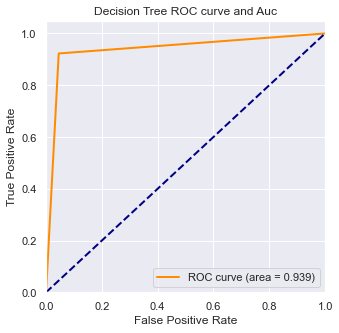

In [139]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_smote_large = dt_smote_grid_model.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_dt_smote_large,tpr_dt_smote_large,threshold_dt_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_dt_smote_large) ###计算真正率和假正率
roc_auc_dt_smote_large = auc(fpr_dt_smote_large,tpr_dt_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_smote_large, tpr_dt_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [72]:
rf_smote_large = RandomForestClassifier(random_state=42)

In [217]:
rf_auc_smote_large, rf_rec_smote_large, rf_model_smote_large = model_smote_large_train(rf_smote_large, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[748   2]
 [  5 745]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      1.00      1.00       750
           1       1.00      0.99      1.00       750

    accuracy                           1.00      1500
   macro avg       1.00      1.00      1.00      1500
weighted avg       1.00      1.00      1.00      1500

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 0.9953333333333332
Random Forest Classifier Recall  Validation Data
Recall 0.9933333333333333


In [218]:
## train set
rf_smote_large.fit(X_train_smote_large,y_train_smote_large)
rf_smote_large_prediction_train = rf_smote_large.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, rf_smote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=rf_smote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=rf_smote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=rf_smote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, rf_smote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [219]:
## test set
rf_smote_large.fit(X_train_smote_large,y_train_smote_large)
rf_smote_large_prediction = rf_smote_large.predict(X_test_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, rf_smote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=rf_smote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=rf_smote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=rf_smote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, rf_smote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of test set
Precision:          0.9973226238286479
F1-Score:           0.9953333146665919
Accuracy Scores:    0.9953333333333333
Recall Scores:      0.9953333333333333
Sensitivity:        0.9933333333333333
Specificity:        0.9973333333333333


In [220]:
## validation set
y_valpred_smote_large = rf_smote_large.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          0.9969278033794163
F1-Score:           0.9945067626829156
Accuracy Scores:    0.9945098039215686
Recall Scores:      0.994567064072449
Sensitivity:        0.9923547400611621
Specificity:        0.9967793880837359


<Figure size 1440x720 with 0 Axes>

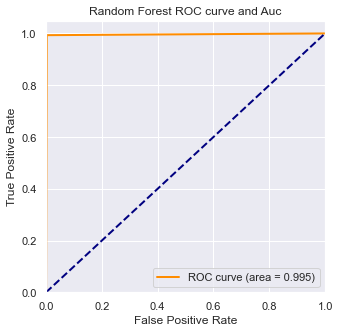

In [141]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_smote_large = rf_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_smote_large,tpr_rf_smote_large,threshold_rf_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_smote_large) ###计算真正率和假正率
roc_auc_rf_smote_large = auc(fpr_rf_smote_large,tpr_rf_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_smote_large, tpr_rf_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [221]:
rf_y_train_pred_smote_large=rf_smote_large.predict(X_train_smote_large)
print('Accuracy score of train data :{}'.format(rf_smote_large.score(X_train_smote_large,y_train_smote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_smote_large, rf_y_train_pred_smote_large)))

rf_y_val_pred_smote_large=rf_smote_large.predict(X_val_smote_large)
print('Accuracy score of validation  data :{}'.format(rf_smote_large.score(X_val_smote_large,y_val_smote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_smote_large, rf_y_val_pred_smote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9945098039215686
validation data f1_Score:0.9946360153256705


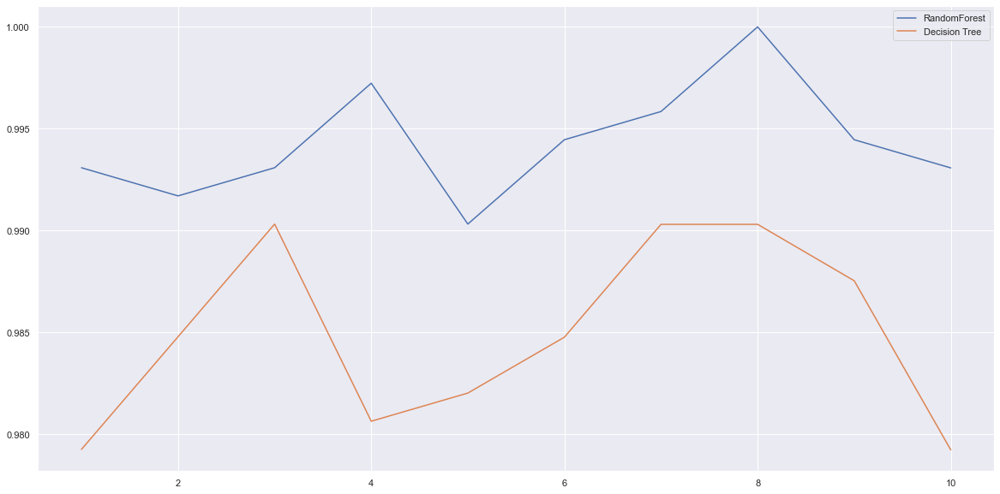

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_smote_large=cross_val_score(rf_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_smote_large=cross_val_score(dt_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_smote_large,label="RandomForest")
plt.plot(range(1,11),clf_s_smote_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

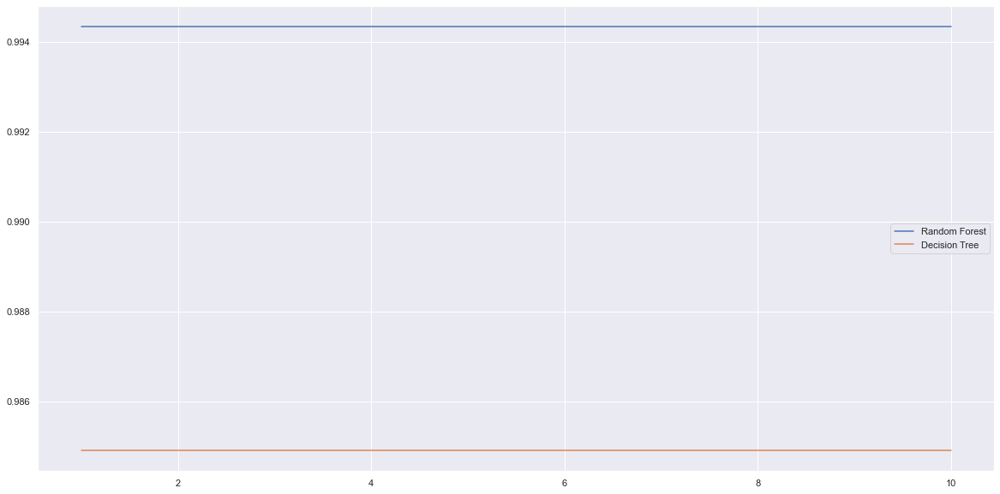

In [ ]:
rfc_l_smote_large = []
clf_l_smote_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_smote_large = cross_val_score(rf_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10).mean()
  rfc_l_smote_large.append(rfc_s_smote_large)
  # clf = DecisionTreeClassifier()
  clf_s_smote_large = cross_val_score(dt_smote_large,X_train_smote_large,np.ravel(y_train_smote_large),cv=10).mean()
  clf_l_smote_large.append(clf_s_smote_large)
 
plt.plot(range(1,11),rfc_l_smote_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_smote_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_smote_large=rf_smote_large.predict(X_train_smote_large)
print('Accuracy score of train data :{}'.format(rf_smote_large.score(X_train_smote_large,y_train_smote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_smote_large, rf_y_train_pred_smote_large)))

rf_y_val_pred_smote_large=rf_smote_large.predict(X_val_smote_large)
print('Accuracy score of validation  data :{}'.format(rf_smote_large.score(X_val_smote_large,y_val_smote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_smote_large, rf_y_val_pred_smote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9945098039215686
validation data f1_Score:0.9946360153256705


### Grid Search

In [73]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,6,7,8,10,15],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_smote_large = GridSearchCV(rf_smote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_smote_large = rf_gs_smote_large.predict(X_test_smote_large)

Fitting 3 folds for each of 1620 candidates, totalling 4860 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.5s[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.4s


In [74]:
rf_gs_smote_large.best_estimator_

RandomForestClassifier(max_depth=15, n_estimators=15, random_state=42)

In [224]:
rf_gs_smote_large_model=RandomForestClassifier(max_depth=20, n_estimators=15, random_state=42)
rf_gs_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_gs_smote_large = rf_gs_smote_large_model.predict(X_test_smote_large)

In [225]:
print("Grid Search Validation Data")
cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_gs_smote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_smote_large)
print('-----------------------')
cr_smote_large = classification_report(y_test_smote_large, y_pred_gs_smote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_smote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_gs_smote_large)       
print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_smote_large = recall_score(y_test_smote_large, y_pred_gs_smote_large)
print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[746   4]
 [  7 743]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       750
           1       0.99      0.99      0.99       750

    accuracy                           0.99      1500
   macro avg       0.99      0.99      0.99      1500
weighted avg       0.99      0.99      0.99      1500

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9926666666666667
Grid Search Recall  Validation Data
Recall 0.9906666666666667


In [148]:
## train set
rf_gs_smote_large_model.fit(X_train_smote_large,y_train_smote_large)
y_pred_gs_smote_large_train = rf_gs_smote_large_model.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, y_pred_gs_smote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=y_pred_gs_smote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=y_pred_gs_smote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=y_pred_gs_smote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, y_pred_gs_smote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          1.0
F1-Score:           0.9998615886303365
Accuracy Scores:    0.9998615916955017
Recall Scores:      0.999860956618465
Sensitivity:        0.9997219132369299
Specificity:        1.0


In [159]:
## test set
y_pred_gs_smote_large = rf_gs_smote_large_model.predict(X_test_smote_large)
print("Random Forest Conclusion for Original Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, y_pred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=y_pred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=y_pred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=y_pred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, y_pred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of test set
Precision:          0.9946452476572959
F1-Score:           0.992666637333216
Accuracy Scores:    0.9926666666666667
Recall Scores:      0.9926666666666667
Sensitivity:        0.9906666666666667
Specificity:        0.9946666666666667


In [160]:
## validation set
y_valpred_gs_smote_large = rf_gs_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for Original Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Original Dataset of val set
Precision:          0.9969088098918083
F1-Score:           0.9913689598873565
Accuracy Scores:    0.9913725490196078
Recall Scores:      0.9915089600969138
Sensitivity:        0.9862385321100917
Specificity:        0.9967793880837359


<Figure size 1440x720 with 0 Axes>

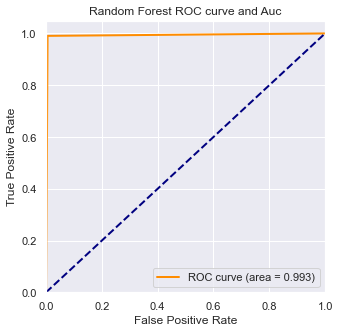

In [157]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_smote_large = rf_gs_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_smote_large,tpr_rf_gs_smote_large,threshold_rf_gs_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_gs_smote_large) ###计算真正率和假正率
roc_auc_rf_gs_smote_large = auc(fpr_rf_gs_smote_large,tpr_rf_gs_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_smote_large, tpr_rf_gs_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [229]:
rf_random_smote_large = RandomizedSearchCV(rf_smote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_smote_large.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_smote_large = rf_random_smote_large.predict(X_test_smote_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=11; total time=   0.2s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=11; total time=   0.2s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=11; total time=   0.2s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10; total time=   0.2s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=2, n_estimators=10; total time= 

In [230]:
rf_random_smote_large.best_estimator_

RandomForestClassifier(max_depth=20, max_features='sqrt', min_samples_leaf=2,
                       n_estimators=6, random_state=42)

In [231]:
rf_random_smote_large_model = RandomForestClassifier(max_depth=20, max_features='sqrt', min_samples_leaf=2,
                       n_estimators=6, random_state=42)
rf_random_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large))
y_pred_random_smote_large = rf_random_smote_large_model.predict(X_test_smote_large)

In [156]:
print("Randomized Grid Search Validation Data")
cm_smote_large = confusion_matrix(y_test_smote_large, y_pred_random_smote_large)                               
print("Randomized Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_smote_large)
print('-----------------------')
cr_smote_large = classification_report(y_test_smote_large, y_pred_random_smote_large)
print("Randomized Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_smote_large)
print('------------------------')
print("Randomized Grid Search AUC Score " +" Validation Data")
auc_smote_large = roc_auc_score(y_test_smote_large, y_pred_random_smote_large)       
print("AUC Score " + str(auc_smote_large))                                       # Displaying the AUC score
print("Randomized Grid Search Recall " +" Validation Data")
rec_smote_large = recall_score(y_test_smote_large, y_pred_random_smote_large)
print("Recall "+ str(rec_smote_large))                                           # Displaying the Recall score

Randomized Grid Search Validation Data
Randomized Grid Search Confusion Matrix  Validation Data
[[747   3]
 [ 10 740]]
-----------------------
Randomized Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       750
           1       1.00      0.99      0.99       750

    accuracy                           0.99      1500
   macro avg       0.99      0.99      0.99      1500
weighted avg       0.99      0.99      0.99      1500

------------------------
Randomized Grid Search AUC Score  Validation Data
AUC Score 0.9913333333333334
Randomized Grid Search Recall  Validation Data
Recall 0.9866666666666667


In [232]:
## train set
rf_random_smote_large_model.fit(X_train_smote_large,y_train_smote_large)
y_pred_random_smote_large_train = rf_random_smote_large_model.predict(X_train_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_smote_large, y_pred_random_smote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_smote_large, y_pred=y_pred_random_smote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_smote_large, y_pred=y_pred_random_smote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_smote_large,y_pred=y_pred_random_smote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_smote_large, y_pred_random_smote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of train set
Precision:          0.9991645781119465
F1-Score:           0.9984774665334308
Accuracy Scores:    0.998477508650519
Recall Scores:      0.9984743159402796
Sensitivity:        0.9977753058954394
Specificity:        0.9991733259851199


In [162]:
## test set
y_pred_random_smote_large = rf_random_smote_large_model.predict(X_test_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_smote_large, y_pred_random_smote_large))
print('F1-Score:          ',f1_score(y_true=y_test_smote_large, y_pred=y_pred_random_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_smote_large, y_pred=y_pred_random_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_smote_large,y_pred=y_pred_random_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_smote_large, y_pred_random_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of test set
Precision:          0.9959623149394348
F1-Score:           0.9913331445884822
Accuracy Scores:    0.9913333333333333
Recall Scores:      0.9913333333333334
Sensitivity:        0.9866666666666667
Specificity:        0.996


In [163]:
## validation set
y_valpred_random_smote_large = rf_random_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_random_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_random_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_random_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_random_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_random_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          0.9953846153846154
F1-Score:           0.9921528030802864
Accuracy Scores:    0.9921568627450981
Recall Scores:      0.9922328591056153
Sensitivity:        0.9892966360856269
Specificity:        0.9951690821256038


<Figure size 1440x720 with 0 Axes>

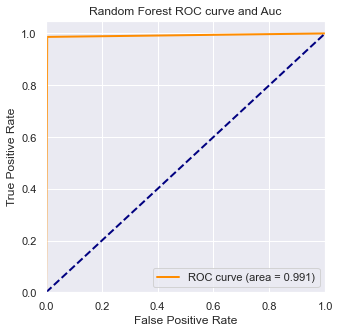

In [164]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_smote_large = rf_random_smote_large_model.fit(X_train_smote_large, np.ravel(y_train_smote_large)).predict(X_test_smote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_smote_large,tpr_rf_random_smote_large,threshold_rf_random_smote_large = roc_curve(np.ravel(y_test_smote_large), y_score_rf_random_smote_large) ###计算真正率和假正率
roc_auc_rf_random_smote_large = auc(fpr_rf_random_smote_large,tpr_rf_random_smote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_smote_large, tpr_rf_random_smote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_smote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [233]:
# Evaluate the permutation importance
perm_smote_large = PermutationImportance(dt_smote_large, random_state=42).fit(X_test_smote_large, y_test_smote_large)    
# Display the weights of each features   
eli5.show_weights(perm_smote_large, feature_names = X_test_smote_large.columns.values)

Weight,Feature
0.3301 ± 0.0129,f(1296.8396)
0.2391 ± 0.0041,f(1373.9536)
0.2264 ± 0.0084,f(1029.3022)
0.1333 ± 0.0112,f(2378.4142)
0.0753 ± 0.0083,f(667.4199)
0.0516 ± 0.0042,f(5993.2283)
0.0468 ± 0.0032,f(408.4789)
0.0345 ± 0.0037,f(226.0000)
0.0329 ± 0.0065,f(458.5020)
0.0273 ± 0.0037,f(7127.1897)


Lets check the same with Random Forest classifier

In [251]:
perm_smote_large = PermutationImportance(rf_gs_smote_large_model, random_state=101).fit(X_test_smote_large, y_test_smote_large)
eli5.show_weights(perm_smote_large, feature_names = X_test_smote_large.columns.values)

Weight,Feature
0.0581 ± 0.0091,f(1296.8396)
0.0565 ± 0.0031,f(1029.3022)
0.0164 ± 0.0014,f(5993.2283)
0.0121 ± 0.0028,f(226.0000)
0.0120 ± 0.0054,f(2378.4142)
0.0108 ± 0.0040,f(577.6763)
0.0101 ± 0.0010,f(408.4789)
0.0092 ± 0.0034,f(1155.3527)
0.0083 ± 0.0025,f(6727.1713)
0.0069 ± 0.0023,f(1887.7486)


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [254]:
# The row for which we want to check the SHAP explanations
row_to_show = 20        
# data_to_predict
data_to_predict_smote_large = X_test_smote_large.iloc[row_to_show]

In [255]:
data_to_preddict_array_smote_large = data_to_predict_smote_large.values.reshape(1,-1)

rf_gs_smote_large_model.predict_proba(data_to_preddict_array_smote_large) # Prediction probability on the row of the data


array([[1., 0.]])

In [256]:
rf_gs_smote_large_model.predict(data_to_preddict_array_smote_large)       # Predicted output

array([0])

In [257]:
y_test_smote_large.iloc[row_to_show]

OverallPoF    0
Name: 20, dtype: int64

In [258]:
# Object that can calculate Shap values
explainer_smote_large = shap.TreeExplainer(rf_gs_smote_large_model)  # SHAP Tree Explainer

# Calculate the shap values
shap_values_smote_large = explainer_smote_large.shap_values(data_to_predict_smote_large) # SHAP explanations

The force plot is an interpretation of the predictions for a single sample which visualises shap values as forces, each feature value is a force that increases or decreases the prediction, the prediction starts from a baseline which is the constant of the explanatory model and each attributed value is an arrow that increases (positive) or decreases (negative) the prediction. Features that push the prediction higher (to the right) are shown in red and those that push the prediction lower are shown in blue.

In [259]:
shap.initjs()
shap.force_plot(explainer_smote_large.expected_value[1], shap_values_smote_large[1], data_to_predict_smote_large)

The predicted output is known to be 0, and the true value is also 0, so the prediction is correct. The predicted value of the model is 0.06 close to 0, which can be interpreted by the figure as only the frequency f(408.4789) makes a positive contribution to the result, with f(577.6763) making a large negative contribution, followed by f(1296.8396), meaning that when the value of f(408.4789) is lower than their corresponding mean, and f(577.6763), f(1296.8396), etc. have frequencies above the mean of the training data set, the probability of that sample having an ear with conductive condition is 0.00.

#### Each feature affects the results

The above are all interpretations for individual instances; the next plots are for all instances.

CPU times: user 3 µs, sys: 1 µs, total: 4 µs
Wall time: 7.39 µs


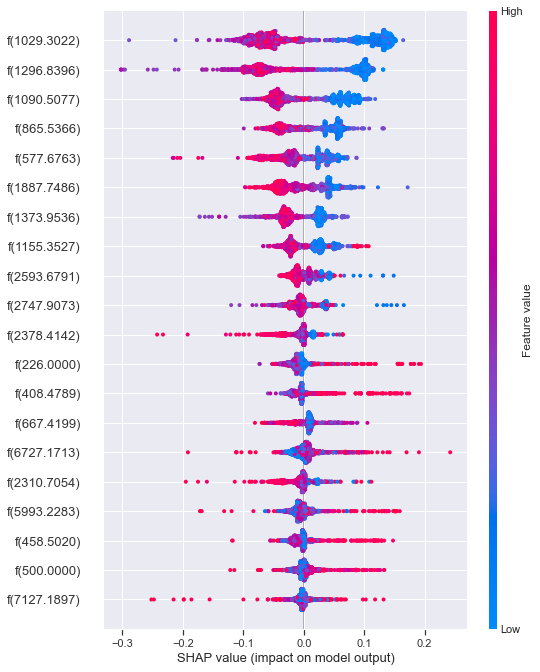

In [261]:
%time
# samples = X_train
samples_smote_large = X_test_smote_large

explainer_smote_large = shap.TreeExplainer(rf_gs_smote_large_model)
shap_values_smote_large = explainer_smote_large.shap_values(samples_smote_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_smote_large[1], samples_smote_large)

First is the SHAP value plot, which further shows the positive and negative relationship between the predictor variables and the target variables to get the magnitude of the effect of the feature on the prediction, which is equivalent to rotating each feature of the force plot by 90 degrees and drawing it as a point plot. The effect of the size of the feature on the results is indicated by the colour (red for large values, blue for small values and purple adjacent to the mean), the wider the distribution of the area the greater its influence, thus frequencies such as f(1029.3022),f(1296.8396),f(1090.5077) have a high and positive influence, 'high ' from the red and 'negative' influences shown on the x-axis. Similarly we would say that f(2378.4142),f(226.0000),f(408.4789) is positively associated with diagnosing patients ear with conductive condition.

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

For a better understanding, let's look at the dependency diagram:

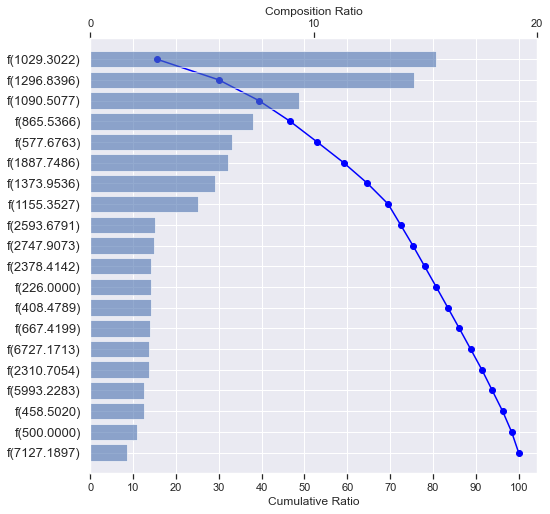

In [262]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_smote_large[1], samples_smote_large)

Based on the SHAP waterfall plot, we can say that f(1029.3022) and f(1296.8396) are two most important frequencies in the model, both of them almost reach 15% of the model's explainability. Also, these top 20 frequencies have provided 100% of the model's interpretation.

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [263]:
shap.force_plot(explainer_smote_large.expected_value[1], shap_values_smote_large[1], samples_smote_large)

Based on the SHAP waterfall plot, we can say that f(1090.5077) and f(1029.3022) are two most important frequencies in the model, both of them almost reach 20% of the model's explainability. Also, these top 20 frequencies have provided 100% of the model's interpretation.

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
# explainer_smote = lime.lime_tabular.LimeTabularExplainer(X_train_smote.values,
#                                                          feature_names=X_train_smote.columns.values.tolist(),
#                                                          mode='classification',class_names='Attack')

In [ ]:
# lime_expln1_smote=explainer_smote.explain_instance(X_test_smote.iloc[1],dt_model_smote.predict_proba,num_features=X_test_smote.shape[1], top_labels = 1)
# lime_expln1_smote.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


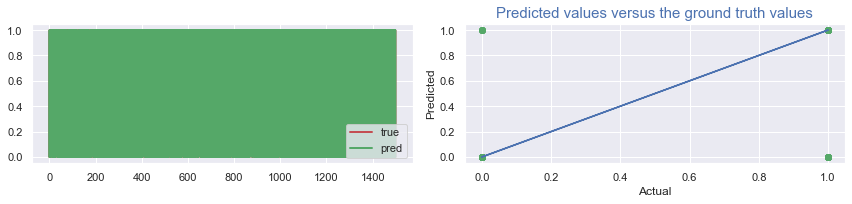

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_smote_large))
pred_plot(np.ravel(y_test_smote_large), np.ravel(y_pred_gs_smote_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_smote_large), np.ravel(y_test_smote_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_smote_large), np.ravel(y_pred_gs_smote_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - SVM SMOTE dataset

## Model Choosing 

### Training Model Function

In [205]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_svmsmote_large_train(model_svmsmote_large, name):
    model_svmsmote_large.fit(X_train_svmsmote_large, y_train_svmsmote_large)                                          # Fitting the model_svmsmote_large
    y_pred_svmsmote_large = model_svmsmote_large.predict(X_test_svmsmote_large)                                       # Making prediction from the trained model_svmsmote_large
    cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_svmsmote_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
    print(cm_svmsmote_large)
    print('-----------------------')
    print('-----------------------')
    cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_svmsmote_large)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr_svmsmote_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_svmsmote_large)       
    print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_svmsmote_large)
    print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score
    return auc_svmsmote_large, rec_svmsmote_large, model_svmsmote_large

### Decision Tree

In [206]:
dt_svmsmote_large = DecisionTreeClassifier(random_state=42)

In [215]:
dt_auc_svmsmote_large, dt_rec_svmsmote_large, dt_model_svmsmote_large = model_svmsmote_large_train(dt_svmsmote_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[682  10]
 [  4 746]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       692
           1       0.99      0.99      0.99       750

    accuracy                           0.99      1442
   macro avg       0.99      0.99      0.99      1442
weighted avg       0.99      0.99      0.99      1442

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.9901078998073218
Decision Tree Recall  Validation Data
Recall 0.9946666666666667


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

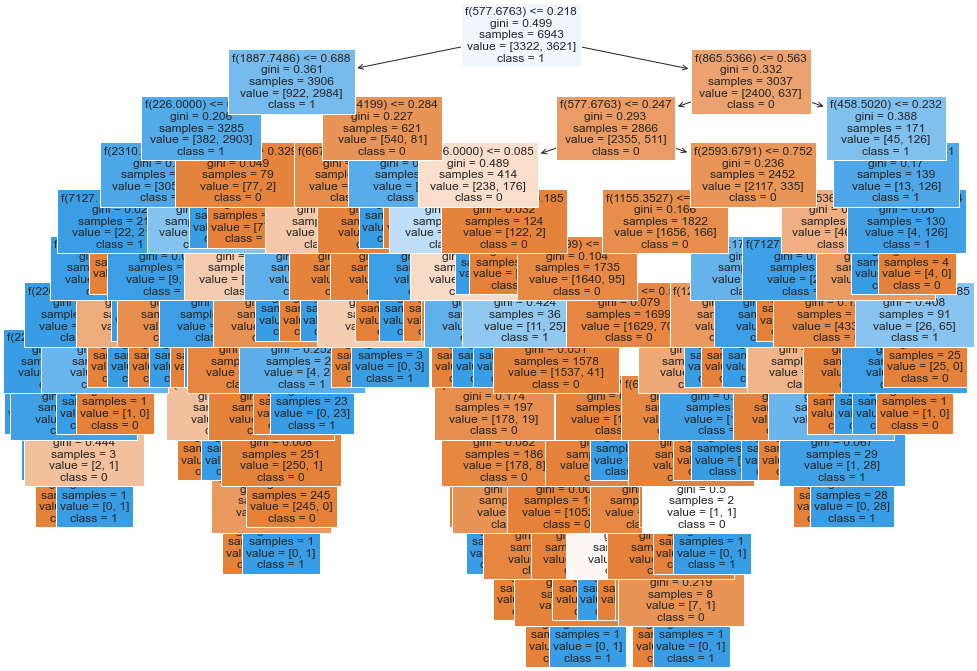

In [208]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
predictions_dt_svmsmote_large = dt_svmsmote_large.predict(X_test_svmsmote_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_svmsmote_large = plot_tree(dt_svmsmote_large, feature_names=X_train_svmsmote_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [213]:
## train set
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
dt_svmsmote_large_prediction_train = dt_svmsmote_large.predict(X_train_svmsmote_large)
print("Decision Tree Conclusion for SVM SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, dt_svmsmote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=dt_svmsmote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=dt_svmsmote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=dt_svmsmote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, dt_svmsmote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [212]:
## test set
dt_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
dt_svmsmote_large_prediction = dt_svmsmote_large.predict(X_test_svmsmote_large)
print("Decision Tree Conclusion for SVM SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, dt_svmsmote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=dt_svmsmote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=dt_svmsmote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=dt_svmsmote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, dt_svmsmote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM SMOTE Dataset of test set
Precision:          0.9867724867724867
F1-Score:           0.9902720997962673
Accuracy Scores:    0.9902912621359223
Recall Scores:      0.9901078998073218
Sensitivity:        0.9946666666666667
Specificity:        0.9855491329479769


In [211]:
## validation set
y_valpred_dt_svmsmote_large = dt_svmsmote_large.predict(X_val_svmsmote_large)
print("Decision Tree Conclusion for SVM svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_dt_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_dt_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_dt_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_dt_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_dt_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for SVM svmsmote Dataset of val set
Precision:          0.9904761904761905
F1-Score:           0.9910212272143502
Accuracy Scores:    0.9910277324632952
Recall Scores:      0.9910003115737671
Sensitivity:        0.9920508744038156
Specificity:        0.9899497487437185


<Figure size 1440x720 with 0 Axes>

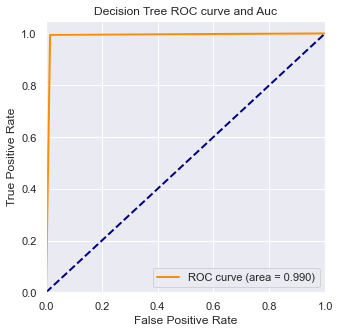

In [216]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_svmsmote_large = dt_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_dt_svmsmote_large,tpr_dt_svmsmote_large,threshold_dt_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_dt_svmsmote_large) ###计算真正率和假正率
roc_auc_dt_svmsmote_large = auc(fpr_dt_svmsmote_large,tpr_dt_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_svmsmote_large, tpr_dt_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Random Forest

In [217]:
rf_svmsmote_large = RandomForestClassifier(random_state=42)

In [219]:
rf_auc_svmsmote_large, rf_rec_svmsmote_large, rf_model_svmsmote_large = model_svmsmote_large_train(rf_svmsmote_large, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[687   5]
 [  0 750]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       692
           1       0.99      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 0.9963872832369942
Random Forest Classifier Recall  Validation Data
Recall 1.0


In [221]:
## train set
rf_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
rf_svmsmote_large_prediction_train = rf_svmsmote_large.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for SVM SMOTE Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, rf_svmsmote_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=rf_svmsmote_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=rf_svmsmote_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=rf_svmsmote_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, rf_svmsmote_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SVM SMOTE Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [223]:
## test set
rf_svmsmote_large.fit(X_train_svmsmote_large,y_train_svmsmote_large)
rf_svmsmote_large_prediction = rf_svmsmote_large.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for SVM SMOTE Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, rf_svmsmote_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=rf_svmsmote_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=rf_svmsmote_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=rf_svmsmote_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, rf_svmsmote_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SVM SMOTE Dataset of test set
Precision:          0.9933774834437086
F1-Score:           0.9965259625276153
Accuracy Scores:    0.9965325936199723
Recall Scores:      0.9963872832369942
Sensitivity:        1.0
Specificity:        0.9927745664739884


In [225]:
## validation set
y_valpred_svmsmote_large = rf_svmsmote_large.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          0.9921011058451816
F1-Score:           0.9951018125158145
Accuracy Scores:    0.9951060358890701
Recall Scores:      0.9950174827502642
Sensitivity:        0.9984101748807631
Specificity:        0.9916247906197655


<Figure size 1440x720 with 0 Axes>

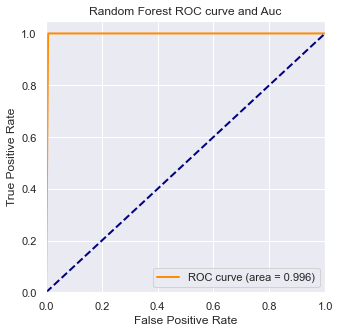

In [227]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_svmsmote_large = rf_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_svmsmote_large,tpr_rf_svmsmote_large,threshold_rf_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_svmsmote_large = auc(fpr_rf_svmsmote_large,tpr_rf_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_svmsmote_large, tpr_rf_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [228]:
rf_y_train_pred_svmsmote_large=rf_svmsmote_large.predict(X_train_svmsmote_large)
print('Accuracy score of train data :{}'.format(rf_svmsmote_large.score(X_train_svmsmote_large,y_train_svmsmote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_svmsmote_large, rf_y_train_pred_svmsmote_large)))

rf_y_val_pred_svmsmote_large=rf_svmsmote_large.predict(X_val_svmsmote_large)
print('Accuracy score of validation  data :{}'.format(rf_svmsmote_large.score(X_val_svmsmote_large,y_val_svmsmote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_svmsmote_large, rf_y_val_pred_svmsmote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9951060358890701
validation data f1_Score:0.9952456418383517


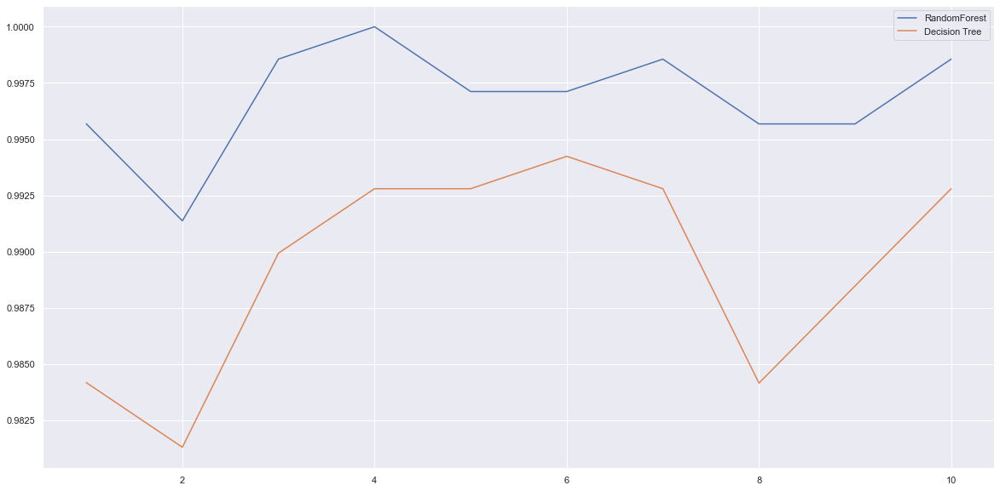

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_svmsmote_large=cross_val_score(rf_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_svmsmote_large=cross_val_score(dt_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_svmsmote_large,label="RandomForest")
plt.plot(range(1,11),clf_s_svmsmote_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

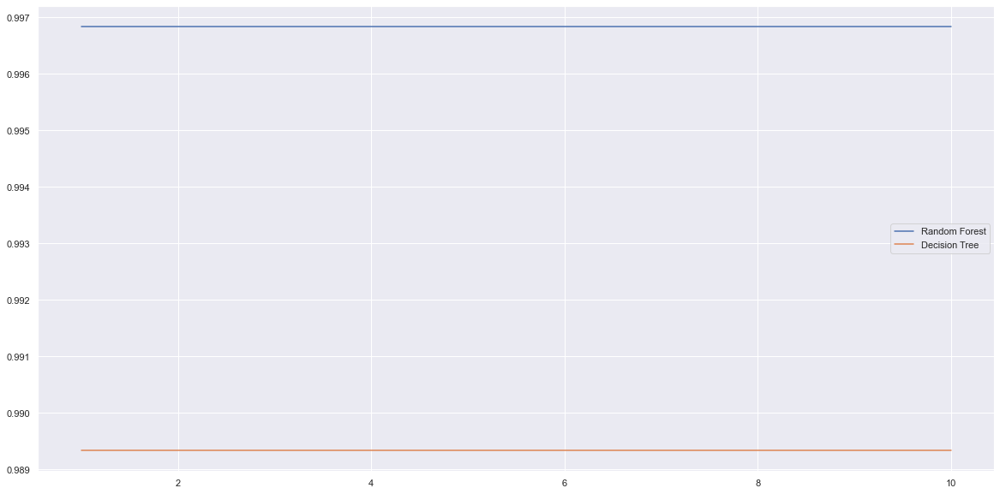

In [ ]:
rfc_l_svmsmote_large = []
clf_l_svmsmote_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_svmsmote_large = cross_val_score(rf_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10).mean()
  rfc_l_svmsmote_large.append(rfc_s_svmsmote_large)
  # clf = DecisionTreeClassifier()
  clf_s_svmsmote_large = cross_val_score(dt_svmsmote_large,X_train_svmsmote_large,np.ravel(y_train_svmsmote_large),cv=10).mean()
  clf_l_svmsmote_large.append(clf_s_svmsmote_large)
 
plt.plot(range(1,11),rfc_l_svmsmote_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_svmsmote_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_svmsmote_large=rf_svmsmote_large.predict(X_train_svmsmote_large)
print('Accuracy score of train data :{}'.format(rf_svmsmote_large.score(X_train_svmsmote_large,y_train_svmsmote_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_svmsmote_large, rf_y_train_pred_svmsmote_large)))

rf_y_val_pred_svmsmote_large=rf_svmsmote_large.predict(X_val_svmsmote_large)
print('Accuracy score of validation  data :{}'.format(rf_svmsmote_large.score(X_val_svmsmote_large,y_val_svmsmote_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_svmsmote_large, rf_y_val_pred_svmsmote_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9951060358890701
validation data f1_Score:0.9952456418383517


### Grid Search

In [229]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_svmsmote_large = GridSearchCV(rf_svmsmote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_svmsmote_large = rf_gs_svmsmote_large.predict(X_test_svmsmote_large)

Fitting 3 folds for each of 810 candidates, totalling 2430 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.1s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.1s


In [230]:
rf_gs_svmsmote_large.best_estimator_

RandomForestClassifier(max_depth=20, min_samples_split=5, n_estimators=18,
                       random_state=42)

In [231]:
rf_gs_svmsmote_large_model=RandomForestClassifier(max_depth=20, n_estimators=18, random_state=42)
rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_test_svmsmote_large)

In [232]:
print("Grid Search Validation Data")
cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_gs_svmsmote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_svmsmote_large)
print('-----------------------')
cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_gs_svmsmote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_svmsmote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large)       
print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large)
print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[686   6]
 [  0 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       692
           1       0.99      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9956647398843931
Grid Search Recall  Validation Data
Recall 1.0


In [237]:
## train set
rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large,y_train_svmsmote_large)
y_pred_gs_svmsmote_large_train = rf_gs_svmsmote_large_model.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, y_pred_gs_svmsmote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=y_pred_gs_svmsmote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=y_pred_gs_svmsmote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=y_pred_gs_svmsmote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, y_pred_gs_svmsmote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [238]:
## test set
y_pred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, y_pred_gs_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=y_pred_gs_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=y_pred_gs_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=y_pred_gs_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, y_pred_gs_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of test set
Precision:          0.9920634920634921
F1-Score:           0.9958308999126859
Accuracy Scores:    0.9958391123439667
Recall Scores:      0.9956647398843931
Sensitivity:        1.0
Specificity:        0.9913294797687862


In [239]:
## validation set
y_valpred_gs_svmsmote_large = rf_gs_svmsmote_large_model.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_gs_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_gs_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_gs_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_gs_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_gs_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          0.9936708860759493
F1-Score:           0.9959183700646735
Accuracy Scores:    0.9959216965742251
Recall Scores:      0.9958550036882878
Sensitivity:        0.9984101748807631
Specificity:        0.9932998324958124


<Figure size 1440x720 with 0 Axes>

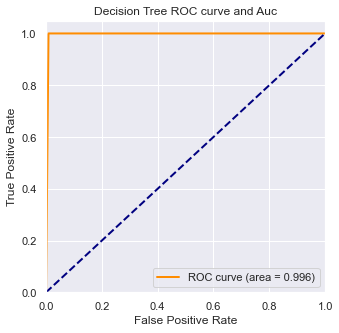

In [240]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_svmsmote_large = rf_gs_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_svmsmote_large,tpr_rf_gs_svmsmote_large,threshold_rf_gs_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_gs_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_gs_svmsmote_large = auc(fpr_rf_gs_svmsmote_large,tpr_rf_gs_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_svmsmote_large, tpr_rf_gs_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [241]:
rf_random_svmsmote_large = RandomizedSearchCV(rf_svmsmote_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_random_svmsmote_large.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_svmsmote_large = rf_random_svmsmote_large.predict(X_test_svmsmote_large)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[CV] END max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=15; total time=   0.4s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=15; total time=   0.5s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total time=   0.5s
[CV] END max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=15; total time=   0.5s
[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=4, min_samples_split=2, n_estimators=16; total time=   0.5s[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=15; total time=   0.5s[CV] END max_depth=20, max_features=sqrt, min_samples_leaf=2, min_samples_split=5, n_estimators=15; total time=   0.5s


[CV] END max_depth=10, max_features=auto, min_samples_leaf=2, min_samples_split=10, n_estimators=15; tot

In [242]:
rf_random_svmsmote_large.best_estimator_

RandomForestClassifier(max_depth=20, max_features='sqrt', min_samples_leaf=4,
                       n_estimators=16, random_state=42)

In [243]:
rf_random_svmsmote_large_model= RandomForestClassifier(max_depth=20, max_features='sqrt', min_samples_leaf=4,
                       n_estimators=16, random_state=42)
rf_random_svmsmote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large))
y_pred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_test_svmsmote_large)

In [250]:
print("Grid Search Validation Data")
cm_svmsmote_large = confusion_matrix(y_test_svmsmote_large, y_pred_random_svmsmote_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_svmsmote_large)
print('-----------------------')
cr_svmsmote_large = classification_report(y_test_svmsmote_large, y_pred_random_svmsmote_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_svmsmote_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_svmsmote_large = roc_auc_score(y_test_svmsmote_large, y_pred_random_svmsmote_large)       
print("AUC Score " + str(auc_svmsmote_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_svmsmote_large = recall_score(y_test_svmsmote_large, y_pred_random_svmsmote_large)
print("Recall "+ str(rec_svmsmote_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[687   5]
 [  1 749]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       692
           1       0.99      1.00      1.00       750

    accuracy                           1.00      1442
   macro avg       1.00      1.00      1.00      1442
weighted avg       1.00      1.00      1.00      1442

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9957206165703276
Grid Search Recall  Validation Data
Recall 0.9986666666666667


In [247]:
## train set
rf_random_svmsmote_large_model.fit(X_train_svmsmote_large,y_train_svmsmote_large)
y_pred_random_svmsmote_large_train = rf_random_svmsmote_large_model.predict(X_train_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of train set")
print('Precision:         ',precision_score(y_train_svmsmote_large, y_pred_random_svmsmote_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_svmsmote_large, y_pred=y_pred_random_svmsmote_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_svmsmote_large, y_pred=y_pred_random_svmsmote_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_svmsmote_large,y_pred=y_pred_random_svmsmote_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_svmsmote_large, y_pred_random_svmsmote_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of train set
Precision:          0.9983448275862069
F1-Score:           0.9988455616559531
Accuracy Scores:    0.9988477603341495
Recall Scores:      0.9988207627557557
Sensitivity:        0.9994476663904999
Specificity:        0.9981938591210114


In [248]:
## test set
y_pred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_test_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of test set")
print('Precision:         ',precision_score(y_test_svmsmote_large, y_pred_random_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_test_svmsmote_large, y_pred=y_pred_random_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_svmsmote_large, y_pred=y_pred_random_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_test_svmsmote_large,y_pred=y_pred_random_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_svmsmote_large, y_pred_random_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of test set
Precision:          0.993368700265252
F1-Score:           0.995831406105458
Accuracy Scores:    0.9958391123439667
Recall Scores:      0.9957206165703276
Sensitivity:        0.9986666666666667
Specificity:        0.9927745664739884


In [249]:
## validation set
y_valpred_random_svmsmote_large = rf_random_svmsmote_large_model.predict(X_val_svmsmote_large)
print("Random Forest Conclusion for svmsmote Dataset of val set")
print('Precision:         ',precision_score(y_val_svmsmote_large, y_valpred_random_svmsmote_large))
print('F1-Score:          ',f1_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_random_svmsmote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_svmsmote_large, y_pred=y_valpred_random_svmsmote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_svmsmote_large,y_pred=y_valpred_random_svmsmote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_svmsmote_large, y_valpred_random_svmsmote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for svmsmote Dataset of val set
Precision:          0.9936808846761453
F1-Score:           0.9967345416772098
Accuracy Scores:    0.9967373572593801
Recall Scores:      0.9966499162479062
Sensitivity:        1.0
Specificity:        0.9932998324958124


<Figure size 1440x720 with 0 Axes>

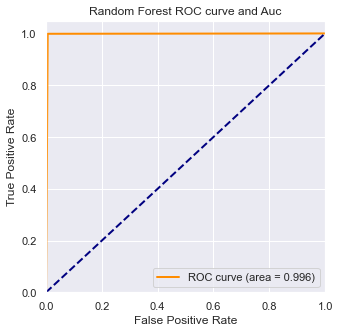

In [251]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_svmsmote_large = rf_random_smote_large_model.fit(X_train_svmsmote_large, np.ravel(y_train_svmsmote_large)).predict(X_test_svmsmote_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_svmsmote_large,tpr_rf_random_svmsmote_large,threshold_rf_random_svmsmote_large = roc_curve(np.ravel(y_test_svmsmote_large), y_score_rf_random_svmsmote_large) ###计算真正率和假正率
roc_auc_rf_random_svmsmote_large = auc(fpr_rf_random_svmsmote_large,tpr_rf_random_svmsmote_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_svmsmote_large, tpr_rf_random_svmsmote_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_svmsmote_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [ ]:
perm_svmsmote_large = PermutationImportance(dt_svmsmote_large, random_state=42).fit(X_test_svmsmote_large, y_test_svmsmote_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_svmsmote_large, feature_names = X_test_svmsmote_large.columns.values)# Display the weights of each features

Weight,Feature
0.0297 ± 0.0058,f(577.6763)
0.0161 ± 0.0027,f(1155.3527)
0.0089 ± 0.0010,f(2378.4142)
0.0060 ± 0.0039,f(1887.7486)
0.0035 ± 0.0009,f(2310.7054)
0.0028 ± 0.0023,f(667.4199)
0.0026 ± 0.0016,f(1296.8396)
0.0021 ± 0.0012,f(865.5366)
0.0017 ± 0.0023,f(408.4789)
0.0015 ± 0.0016,f(6727.1713)


Lets check the same with Random Forest classifier

In [ ]:
perm_svmsmote_large = PermutationImportance(rf_random_svmsmote_large, random_state=101).fit(X_test_svmsmote_large, y_test_svmsmote_large)
eli5.show_weights(perm_svmsmote_large, feature_names = X_test_svmsmote_large.columns.values)

Weight,Feature
0.0288 ± 0.0030,f(577.6763)
0.0158 ± 0.0024,f(1155.3527)
0.0076 ± 0.0046,f(2378.4142)
0.0062 ± 0.0030,f(1887.7486)
0.0028 ± 0.0009,f(865.5366)
0.0026 ± 0.0027,f(2310.7054)
0.0025 ± 0.0023,f(1296.8396)
0.0021 ± 0.0023,f(6727.1713)
0.0018 ± 0.0011,f(7127.1897)
0.0015 ± 0.0018,f(667.4199)


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [ ]:
row_to_show = 20                       # The row for which we want to check the SHAP explanations
data_to_predict_svmsmote_large = X_test_svmsmote_large.iloc[row_to_show]
#data_to_predict

In [ ]:
data_to_preddict_array_svmsmote_large = data_to_predict_svmsmote_large.values.reshape(1,-1)
# Prediction probability on the row of the data
rf_random_svmsmote_large.predict_proba(data_to_preddict_array_svmsmote_large) 

array([[1., 0.]])

In [ ]:
rf_random_svmsmote_large.predict(data_to_preddict_array_svmsmote_large)       # Predicted output

array([0])

In [ ]:
y_test_svmsmote_large.iloc[row_to_show]

OverallPoF    0
Name: 20, dtype: int64

In [ ]:
# Object that can calculate Shap values
explainer_svmsmote_large = shap.TreeExplainer(rf_random_svmsmote_large)                         # SHAP Tree Explainer

# Calculate the shap values
shap_values_svmsmote_large = explainer_svmsmote_large.shap_values(data_to_predict_svmsmote_large) # SHAP explanations

In [ ]:
shap.initjs()
shap.force_plot(explainer_svmsmote_large.expected_value[1], shap_values_svmsmote_large[1], data_to_predict_svmsmote_large)

#### Each feature affects the results

CPU times: user 5 µs, sys: 12 µs, total: 17 µs
Wall time: 20 µs


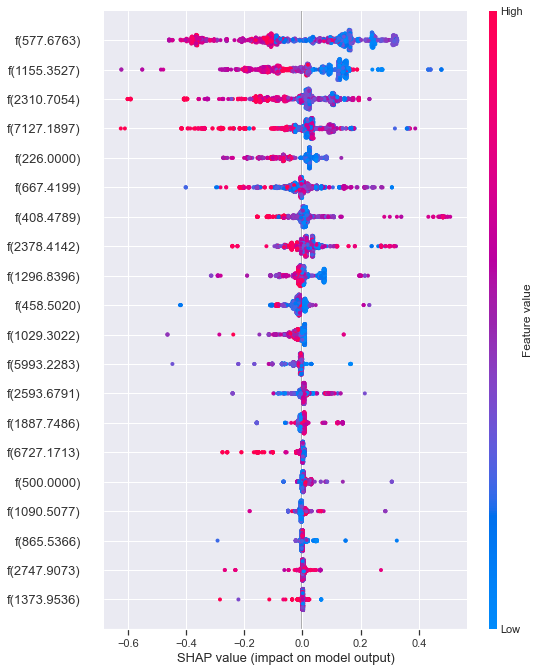

In [ ]:
%time
# samples = X_train
samples_svmsmote_large = X_test_svmsmote_large

explainer_svmsmote_large = shap.TreeExplainer(rf_random_svmsmote_large.best_estimator_[1])
shap_values_svmsmote_large = explainer_svmsmote_large.shap_values(samples_svmsmote_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_svmsmote_large[1], samples_svmsmote_large)

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

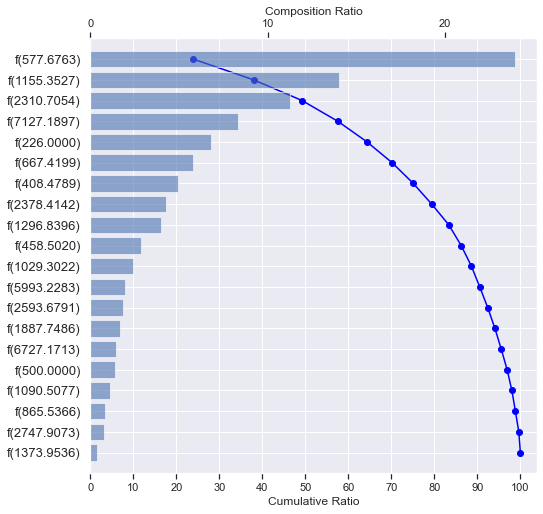

In [ ]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_svmsmote_large[1], samples_svmsmote_large)

Based on the SHAP waterfall plot, we can say that 'TympType' is the most important feature in the model, which has more than 50% of the model's explainability. Also, these top 27 features provide more than 100% of the model's interpretation

特征是正相关还是负相关，使用force函数可将多个实例的特征贡献度画在一张图上。

In [ ]:
shap.force_plot(explainer_svmsmote_large.expected_value[1], shap_values_svmsmote_large[1], samples_svmsmote_large)

### LIME

In [ ]:
import lime
import lime.lime_tabular

In [ ]:
# explainer_smote = lime.lime_tabular.LimeTabularExplainer(X_train_smote.values,
#                                                          feature_names=X_train_smote.columns.values.tolist(),
#                                                          mode='classification',class_names='Attack')

In [ ]:
# lime_expln1_smote=explainer_smote.explain_instance(X_test_smote.iloc[1],dt_model_smote.predict_proba,num_features=X_test_smote.shape[1], top_labels = 1)
# lime_expln1_smote.show_in_notebook(show_table=True, show_all=False)


## Prediction Results on Testing Set

The Prediction Results on Testing Set:


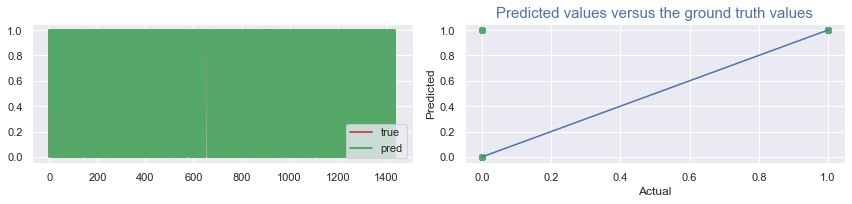

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_svmsmote_large))
pred_plot(np.ravel(y_test_svmsmote_large), np.ravel(y_pred_random_svmsmote_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_svmsmote_large), np.ravel(y_test_svmsmote_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_svmsmote_large), np.ravel(y_pred_random_svmsmote_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

# Model Fitting - Adasyn dataset

## Model Choosing

### Training Model Function

In [264]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, recall_score
def model_train(model_adasyn_large, name):
    model_adasyn_large.fit(X_train_adasyn_large, y_train_adasyn_large)                                          # Fitting the model_adasyn_large
    y_pred_adasyn_large = model_adasyn_large.predict(X_test_adasyn_large)                                       # Making prediction from the trained model_adasyn_large
    cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_adasyn_large)                               
    print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
    print(cm_adasyn_large)
    print('-----------------------')
    print('-----------------------')
    cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_adasyn_large)
    print(name +" Classification Report " +" Validation Data")           # Displaying the Classification Report
    print(cr_adasyn_large)
    print('------------------------')
    print(name +" AUC Score " +" Validation Data")
    auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_adasyn_large)       
    print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
    print(name +" Recall " +" Validation Data")
    rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_adasyn_large)
    print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score
    return auc_adasyn_large, rec_adasyn_large, model_adasyn_large

### Decision Tree

In [265]:
dt_adasyn_large = DecisionTreeClassifier(random_state=42)

In [266]:
dt_auc_adasyn_large, dt_rec_adasyn_large, dt_model_adasyn_large = model_train(dt_adasyn_large, "Decision Tree")

Grid Search Confusion Matrix  Validation Data
[[745   5]
 [  5 746]]
-----------------------
-----------------------
Decision Tree Classification Report  Validation Data
              precision    recall  f1-score   support

           0       0.99      0.99      0.99       750
           1       0.99      0.99      0.99       751

    accuracy                           0.99      1501
   macro avg       0.99      0.99      0.99      1501
weighted avg       0.99      0.99      0.99      1501

------------------------
Decision Tree AUC Score  Validation Data
AUC Score 0.9933377718597425
Decision Tree Recall  Validation Data
Recall 0.9933422103861518


The metric of our choice should be Recall as we want to minimize FN, which means that an attack accured but the model did not detect it.

In [173]:
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_prediction_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)
accuracy_dt_adasyn_large = accuracy_score(dt_prediction_adasyn_large,y_test_adasyn_large)
cm_dt_adasyn_large = confusion_matrix(dt_prediction_adasyn_large,y_test_adasyn_large)
prfs_dt_adasyn_large = precision_recall_fscore_support(dt_prediction_adasyn_large,y_test_adasyn_large)
print('Accuracy: ',accuracy_dt_adasyn_large)
print('\n')
print('Confusion Matrix: ',cm_dt_adasyn_large)
print('\n')
print('Precision: ', prfs_dt_adasyn_large[0])
print('Recall:    ', prfs_dt_adasyn_large[1])
print('Fscore:    ', prfs_dt_adasyn_large[2])
print('Support:   ', prfs_dt_adasyn_large[3])

Accuracy:  0.9933377748167888


Confusion Matrix:  [[745   5]
 [  5 746]]


Precision:  [0.99333333 0.99334221]
Recall:     [0.99333333 0.99334221]
Fscore:     [0.99333333 0.99334221]
Support:    [750 751]


In [267]:
dt_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_dt_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)

In [268]:
## train set
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_adasyn_large_prediction_train = dt_adasyn_large.predict(X_train_adasyn_large)
print("Decision Tree Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, dt_adasyn_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=dt_adasyn_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=dt_adasyn_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=dt_adasyn_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, dt_adasyn_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [176]:
## test set
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
dt_adasyn_large_prediction = dt_adasyn_large.predict(X_test_adasyn_large)
print("Decision Tree Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, dt_adasyn_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=dt_adasyn_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=dt_adasyn_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=dt_adasyn_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, dt_adasyn_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for adasyn Dataset of test set
Precision:          0.9933422103861518
F1-Score:           0.9933377718597425
Accuracy Scores:    0.9933377748167888
Recall Scores:      0.9933377718597425
Sensitivity:        0.9933422103861518
Specificity:        0.9933333333333333


In [177]:
## validation set
y_valpred_dt_adasyn_large = dt_adasyn_large.predict(X_val_adasyn_large)
print("Decision Tree Conclusion for Adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_dt_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_dt_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_dt_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_dt_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_dt_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Decision Tree Conclusion for Adasyn Dataset of val set
Precision:          0.9846390168970814
F1-Score:           0.9882413292089929
Accuracy Scores:    0.9882445141065831
Recall Scores:      0.9881935230232444
Sensitivity:        0.9922600619195047
Specificity:        0.9841269841269841


<Figure size 1440x720 with 0 Axes>

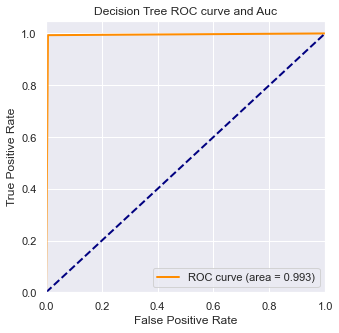

In [178]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_dt_adasyn_large = dt_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_dt_adasyn_large,tpr_dt_adasyn_large,threshold_dt_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_dt_adasyn_large) ###计算真正率和假正率
roc_auc_dt_adasyn_large = auc(fpr_dt_adasyn_large,tpr_dt_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_dt_adasyn_large, tpr_dt_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_dt_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

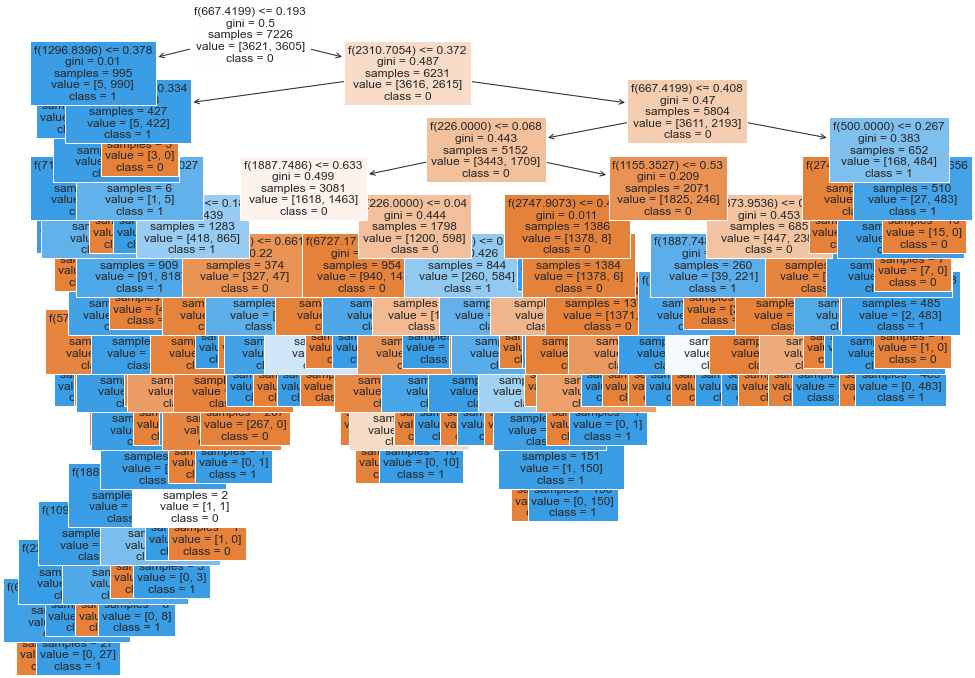

In [ ]:
# dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dt_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
predictions_dt_adasyn_large = dt_adasyn_large.predict(X_test_adasyn_large)
# visualising the decision tree diagram
fig = plt.figure(figsize=(16,12))
a_rf_adasyn_large = plot_tree(dt_adasyn_large, feature_names=X_train_adasyn_large.columns, fontsize=12, filled=True, class_names=['0', '1'])

### Random Forest

In [269]:
rf_adasyn_large = RandomForestClassifier(random_state=42)

In [270]:
rf_auc_adasyn_large, rf_rec_adasyn_large, rf_model_adasyn_large = model_train(rf_adasyn_large, "Random Forest Classifier")

Grid Search Confusion Matrix  Validation Data
[[745   5]
 [  0 751]]
-----------------------
-----------------------
Random Forest Classifier Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       750
           1       0.99      1.00      1.00       751

    accuracy                           1.00      1501
   macro avg       1.00      1.00      1.00      1501
weighted avg       1.00      1.00      1.00      1501

------------------------
Random Forest Classifier AUC Score  Validation Data
AUC Score 0.9966666666666666
Random Forest Classifier Recall  Validation Data
Recall 1.0


In [271]:
rf_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_rf_adasyn_large = rf_adasyn_large.predict(X_test_adasyn_large)

In [182]:
## train set
rf_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
rf_adasyn_large_prediction_train = rf_adasyn_large.predict(X_train_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, rf_adasyn_large_prediction_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=rf_adasyn_large_prediction_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=rf_adasyn_large_prediction_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=rf_adasyn_large_prediction_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, rf_adasyn_large_prediction_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           1.0
Accuracy Scores:    1.0
Recall Scores:      1.0
Sensitivity:        1.0
Specificity:        1.0


In [183]:
## test set
rf_adasyn_large.fit(X_train_adasyn_large,y_train_adasyn_large)
rf_adasyn_large_prediction = rf_adasyn_large.predict(X_test_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, rf_adasyn_large_prediction))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=rf_adasyn_large_prediction, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=rf_adasyn_large_prediction))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=rf_adasyn_large_prediction,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, rf_adasyn_large_prediction).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of test set
Precision:          0.9933862433862434
F1-Score:           0.9966688341807353
Accuracy Scores:    0.9966688874083944
Recall Scores:      0.9966666666666666
Sensitivity:        1.0
Specificity:        0.9933333333333333


In [184]:
## validation set
y_valpred_rf_adasyn_large = rf_adasyn_large.predict(X_val_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_rf_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_rf_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_rf_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_rf_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_rf_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of val set
Precision:          0.9923076923076923
F1-Score:           0.995296650153338
Accuracy Scores:    0.9952978056426333
Recall Scores:      0.9952577522236965
Sensitivity:        0.9984520123839009
Specificity:        0.9920634920634921


<Figure size 1440x720 with 0 Axes>

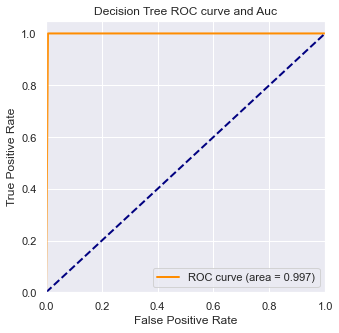

In [185]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_adasyn_large = rf_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_adasyn_large,tpr_rf_adasyn_large,threshold_rf_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_adasyn_large) ###计算真正率和假正率
roc_auc_rf_adasyn_large = auc(fpr_rf_adasyn_large,tpr_rf_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_adasyn_large, tpr_rf_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Scores for Train and Validation data

In [186]:
rf_y_train_pred_adasyn_large=rf_adasyn_large.predict(X_train_adasyn_large)
print('Accuracy score of train data :{}'.format(rf_adasyn_large.score(X_train_adasyn_large,y_train_adasyn_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_adasyn_large, rf_y_train_pred_adasyn_large)))

rf_y_val_pred_adasyn_large=rf_adasyn_large.predict(X_val_adasyn_large)
print('Accuracy score of validation  data :{}'.format(rf_adasyn_large.score(X_val_adasyn_large,y_val_adasyn_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_adasyn_large, rf_y_val_pred_adasyn_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9952978056426333
validation data f1_Score:0.9953703703703703


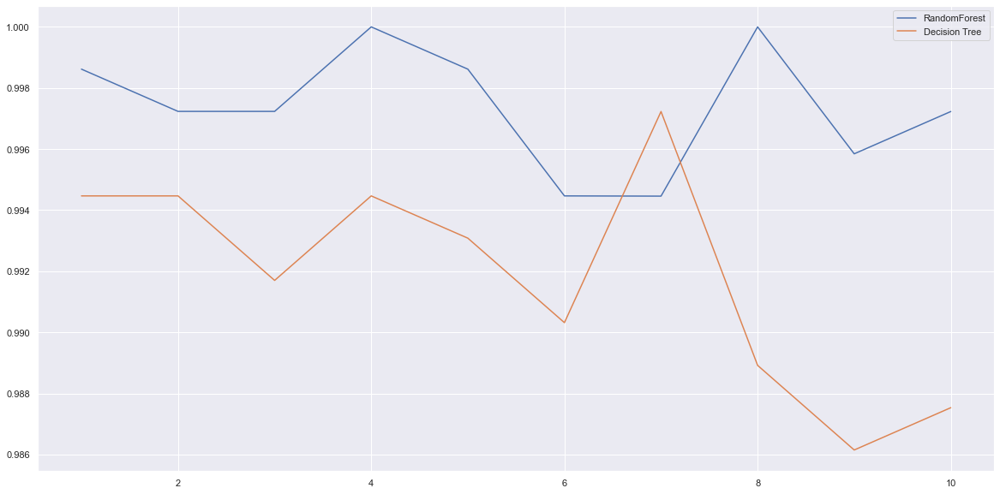

In [ ]:
#随机森林
# rfc=RandomForestClassifier(n_estimators=25)
rfc_s_adasyn_large=cross_val_score(rf_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10)
#决策树
# clf=DecisionTreeClassifier(random_state=0)
clf_s_adasyn_large=cross_val_score(dt_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10)
#绘制十折交叉验证
plt.plot(range(1,11),rfc_s_adasyn_large,label="RandomForest")
plt.plot(range(1,11),clf_s_adasyn_large,label="Decision Tree")
plt.legend()
plt.show()

随机森林和决策树在十组交叉验证下的效果对比

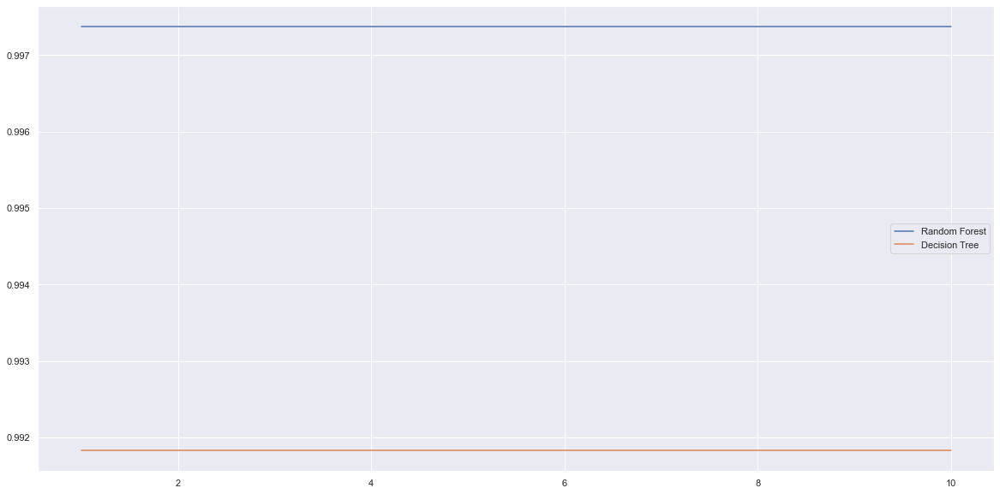

In [ ]:
rfc_l_adasyn_large = []
clf_l_adasyn_large = []
for i in range(10):
  # rfc = RandomForestClassifier(n_estimators=25)
  rfc_s_adasyn_large = cross_val_score(rf_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10).mean()
  rfc_l_adasyn_large.append(rfc_s_adasyn_large)
  # clf = DecisionTreeClassifier()
  clf_s_adasyn_large = cross_val_score(dt_adasyn_large,X_train_adasyn_large,np.ravel(y_train_adasyn_large),cv=10).mean()
  clf_l_adasyn_large.append(clf_s_adasyn_large)
 
plt.plot(range(1,11),rfc_l_adasyn_large,label = "Random Forest")
plt.plot(range(1,11),clf_l_adasyn_large,label = "Decision Tree")
plt.legend()
plt.show()

In [ ]:
rf_y_train_pred_adasyn_large=rf_adasyn_large.predict(X_train_adasyn_large)
print('Accuracy score of train data :{}'.format(rf_adasyn_large.score(X_train_adasyn_large,y_train_adasyn_large)))
print('Train data f1_Score:{}'.format(f1_score(y_train_adasyn_large, rf_y_train_pred_adasyn_large)))

rf_y_val_pred_adasyn_large=rf_adasyn_large.predict(X_val_adasyn_large)
print('Accuracy score of validation  data :{}'.format(rf_adasyn_large.score(X_val_adasyn_large,y_val_adasyn_large)))
print('validation data f1_Score:{}'.format(f1_score(y_val_adasyn_large, rf_y_val_pred_adasyn_large)))

Accuracy score of train data :1.0
Train data f1_Score:1.0
Accuracy score of validation  data :0.9952978056426333
validation data f1_Score:0.9953703703703703


### Grid Search

In [272]:
random_grid = {'n_estimators': range(5,20),
              'max_features' : ['auto', 'sqrt'],
              'max_depth' : [5,10,15,20],
              'min_samples_split':[2,5,10],
              'min_samples_leaf':[1,2,4]}

rf_gs_adasyn_large = GridSearchCV(rf_adasyn_large, random_grid, cv = 3, n_jobs=-1, verbose=2)

rf_gs_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_adasyn_large = rf_gs_adasyn_large.predict(X_test_adasyn_large)

Fitting 3 folds for each of 1080 candidates, totalling 3240 fits
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=5; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=6; total time=   0.4s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=7; total time=   0.3s
[CV] END max_depth=5, max_features=auto, min_samples_leaf=1, min_samples_split=2, n_estimators=8; total time=   0.3s

In [188]:
rf_gs_adasyn_large.best_estimator_

RandomForestClassifier(max_depth=20, min_samples_split=5, n_estimators=8,
                       random_state=42)

In [273]:
rf_gs_adasyn_large_model = RandomForestClassifier(max_depth=20, min_samples_split=5, n_estimators=8, random_state=42)
rf_gs_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_gs_adasyn_large = rf_gs_adasyn_large_model.predict(X_test_adasyn_large)

In [190]:
print("Grid Search Validation Data")
cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_gs_adasyn_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_adasyn_large)
print('-----------------------')
cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_gs_adasyn_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_adasyn_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_gs_adasyn_large)       
print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_gs_adasyn_large)
print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[741   9]
 [  1 750]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      0.99       750
           1       0.99      1.00      0.99       751

    accuracy                           0.99      1501
   macro avg       0.99      0.99      0.99      1501
weighted avg       0.99      0.99      0.99      1501

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9933342210386151
Grid Search Recall  Validation Data
Recall 0.9986684420772304


In [191]:
## train set
rf_gs_adasyn_large_model.fit(X_train_adasyn_large,y_train_adasyn_large)
y_pred_gs_adasyn_large_train = rf_gs_adasyn_large_model.predict(X_train_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, y_pred_gs_adasyn_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=y_pred_gs_adasyn_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=y_pred_gs_adasyn_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=y_pred_gs_adasyn_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, y_pred_gs_adasyn_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of train set
Precision:          0.9997226844148641
F1-Score:           0.9998616102533741
Accuracy Scores:    0.9998616108497094
Recall Scores:      0.999861916597625
Sensitivity:        1.0
Specificity:        0.9997238331952499


In [192]:
## test set
y_pred_gs_adasyn_large = rf_gs_adasyn_large_model.predict(X_test_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, y_pred_gs_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=y_pred_gs_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=y_pred_gs_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=y_pred_gs_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, y_pred_gs_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of test set
Precision:          0.9881422924901185
F1-Score:           0.993337535287538
Accuracy Scores:    0.9933377748167888
Recall Scores:      0.9933342210386151
Sensitivity:        0.9986684420772304
Specificity:        0.988


In [193]:
## validation set
y_valpred_gs_smote_large = rf_gs_smote_large_model.predict(X_val_smote_large)
print("Random Forest Conclusion for SMOTE Dataset of val set")
print('Precision:         ',precision_score(y_val_smote_large, y_valpred_gs_smote_large))
print('F1-Score:          ',f1_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_smote_large, y_pred=y_valpred_gs_smote_large))
print('Recall Scores:     ',recall_score(y_true=y_val_smote_large,y_pred=y_valpred_gs_smote_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_smote_large, y_valpred_gs_smote_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for SMOTE Dataset of val set
Precision:          0.9969088098918083
F1-Score:           0.9913689598873565
Accuracy Scores:    0.9913725490196078
Recall Scores:      0.9915089600969138
Sensitivity:        0.9862385321100917
Specificity:        0.9967793880837359


<Figure size 1440x720 with 0 Axes>

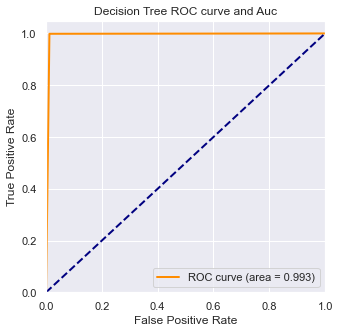

In [194]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_gs_adasyn_large = rf_gs_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_gs_adasyn_large,tpr_rf_gs_adasyn_large,threshold_rf_gs_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_gs_adasyn_large) ###计算真正率和假正率
roc_auc_rf_gs_adasyn_large = auc(fpr_rf_gs_adasyn_large,tpr_rf_gs_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_gs_adasyn_large, tpr_rf_gs_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_gs_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

### Randomized Grid Search

In [275]:
rf_random_adasyn_large = RandomizedSearchCV(rf_adasyn_large, random_grid, cv = 4, n_jobs=-1, verbose=2)

rf_random_adasyn_large.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_adasyn_large = rf_random_adasyn_large.predict(X_test_adasyn_large)

Fitting 4 folds for each of 10 candidates, totalling 40 fits
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=5; total time=   0.2s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=5; total time=   0.2s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=5; total time=   0.2s
[CV] END max_depth=15, max_features=sqrt, min_samples_leaf=4, min_samples_split=10, n_estimators=5; total time=   0.2s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=19; total time=   0.5s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=19; total time=   0.5s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=19; total time=   0.6s
[CV] END max_depth=5, max_features=sqrt, min_samples_leaf=1, min_samples_split=2, n_estimators=19; total time

In [276]:
rf_random_adasyn_large.best_estimator_

RandomForestClassifier(max_depth=15, max_features='sqrt', min_samples_leaf=2,
                       min_samples_split=10, n_estimators=17, random_state=42)

In [290]:
# rf_random_adasyn_large_model=RandomForestClassifier(max_depth=10, max_features='sqrt', min_samples_split=10,
#                        n_estimators=10, random_state=42)
# rf_random_adasyn_large_model=RandomForestClassifier(max_depth=10, max_features='sqrt', n_estimators=17,random_state=42)
rf_random_adasyn_large_model=RandomForestClassifier(max_depth=15, max_features='sqrt', min_samples_leaf=2, min_samples_split=10, n_estimators=17, random_state=42)
rf_random_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large))
y_pred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_test_adasyn_large)

In [278]:
print("Grid Search Validation Data")
cm_adasyn_large = confusion_matrix(y_test_adasyn_large, y_pred_random_adasyn_large)                               
print("Grid Search Confusion Matrix " +" Validation Data")                # Displaying the Confusion Matrix
print(cm_adasyn_large)
print('-----------------------')
cr_adasyn_large = classification_report(y_test_adasyn_large, y_pred_random_adasyn_large)
print("Grid Search Classification Report " +" Validation Data")           # Displaying the Classification Report
print(cr_adasyn_large)
print('------------------------')
print("Grid Search AUC Score " +" Validation Data")
auc_adasyn_large = roc_auc_score(y_test_adasyn_large, y_pred_random_adasyn_large)       
print("AUC Score " + str(auc_adasyn_large))                                       # Displaying the AUC score
print("Grid Search Recall " +" Validation Data")
rec_adasyn_large = recall_score(y_test_adasyn_large, y_pred_random_adasyn_large)
print("Recall "+ str(rec_adasyn_large))                                           # Displaying the Recall score

Grid Search Validation Data
Grid Search Confusion Matrix  Validation Data
[[743   7]
 [  0 751]]
-----------------------
Grid Search Classification Report  Validation Data
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       750
           1       0.99      1.00      1.00       751

    accuracy                           1.00      1501
   macro avg       1.00      1.00      1.00      1501
weighted avg       1.00      1.00      1.00      1501

------------------------
Grid Search AUC Score  Validation Data
AUC Score 0.9953333333333334
Grid Search Recall  Validation Data
Recall 1.0


In [291]:
## train set
rf_random_adasyn_large_model.fit(X_train_adasyn_large,y_train_adasyn_large)
y_pred_random_adasyn_large_train = rf_random_adasyn_large_model.predict(X_train_adasyn_large)
print("Random Forest Conclusion for Adasyn Dataset of train set")
print('Precision:         ',precision_score(y_train_adasyn_large, y_pred_random_adasyn_large_train))
print('F1-Score:          ',f1_score(y_true=y_train_adasyn_large, y_pred=y_pred_random_adasyn_large_train, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_train_adasyn_large, y_pred=y_pred_random_adasyn_large_train))
print('Recall Scores:     ',recall_score(y_true=y_train_adasyn_large,y_pred=y_pred_random_adasyn_large_train,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_train_adasyn_large, y_pred_random_adasyn_large_train).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for Adasyn Dataset of train set
Precision:          1.0
F1-Score:           0.9997232199819699
Accuracy Scores:    0.9997232216994187
Recall Scores:      0.9997226074895977
Sensitivity:        0.9994452149791956
Specificity:        1.0


In [292]:
## test set
y_pred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_test_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of test set")
print('Precision:         ',precision_score(y_test_adasyn_large, y_pred_random_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_test_adasyn_large, y_pred=y_pred_random_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_test_adasyn_large, y_pred=y_pred_random_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_test_adasyn_large,y_pred=y_pred_random_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_test_adasyn_large, y_pred_random_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of test set
Precision:          0.9907651715039578
F1-Score:           0.995336309892376
Accuracy Scores:    0.9953364423717521
Recall Scores:      0.9953333333333334
Sensitivity:        1.0
Specificity:        0.9906666666666667


In [293]:
## validation set
y_valpred_random_adasyn_large = rf_random_adasyn_large_model.predict(X_val_adasyn_large)
print("Random Forest Conclusion for adasyn Dataset of val set")
print('Precision:         ',precision_score(y_val_adasyn_large, y_valpred_random_adasyn_large))
print('F1-Score:          ',f1_score(y_true=y_val_adasyn_large, y_pred=y_valpred_random_adasyn_large, average='macro'))
print('Accuracy Scores:   ',accuracy_score(y_true=y_val_adasyn_large, y_pred=y_valpred_random_adasyn_large))
print('Recall Scores:     ',recall_score(y_true=y_val_adasyn_large,y_pred=y_valpred_random_adasyn_large,average='macro'))
tn, fp, fn, tp = confusion_matrix(y_val_adasyn_large, y_valpred_random_adasyn_large).ravel()
sensitivity = tp / (tp+fn)
specificity = tn / (tn+fp)
print('Sensitivity:       ',sensitivity)
print('Specificity:       ',specificity)

Random Forest Conclusion for adasyn Dataset of val set
Precision:          0.9923076923076923
F1-Score:           0.995296650153338
Accuracy Scores:    0.9952978056426333
Recall Scores:      0.9952577522236965
Sensitivity:        0.9984520123839009
Specificity:        0.9920634920634921


<Figure size 1440x720 with 0 Axes>

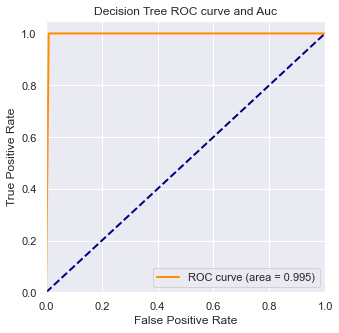

In [294]:
###通过decision_function()计算得到的y_score的值，用在roc_curve()函数中
y_score_rf_random_adasyn_large = rf_random_adasyn_large_model.fit(X_train_adasyn_large, np.ravel(y_train_adasyn_large)).predict(X_test_adasyn_large)

# Compute ROC curve and ROC area for each class
fpr_rf_random_adasyn_large,tpr_rf_random_adasyn_large,threshold_rf_random_adasyn_large = roc_curve(np.ravel(y_test_adasyn_large), y_score_rf_random_adasyn_large) ###计算真正率和假正率
roc_auc_rf_random_adasyn_large = auc(fpr_rf_random_adasyn_large,tpr_rf_random_adasyn_large) ###计算auc的值

plt.figure()
lw = 2
plt.figure(figsize=(5,5))
plt.plot(fpr_rf_random_adasyn_large, tpr_rf_random_adasyn_large, color='darkorange',
         lw=lw, label='ROC curve (area = %0.3f)' % roc_auc_rf_random_adasyn_large) ###假正率为横坐标，真正率为纵坐标做曲线
plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree ROC curve and Auc')
plt.legend(loc="lower right")
plt.show()

## Model Explainations

### Permutation Importance
We will run the permutation importance using Decision Tree Classifier

In [295]:
perm_adasyn_large = PermutationImportance(dt_adasyn_large, random_state=42).fit(X_test_adasyn_large, y_test_adasyn_large)      # Evaluate the permutation importance 
eli5.show_weights(perm_adasyn_large, feature_names = X_test_adasyn_large.columns.values)# Display the weights of each features

Weight,Feature
0.1346 ± 0.0129,f(500.0000)
0.1340 ± 0.0127,f(226.0000)
0.1298 ± 0.0155,f(667.4199)
0.1229 ± 0.0048,f(1155.3527)
0.1219 ± 0.0082,f(1887.7486)
0.0895 ± 0.0121,f(1296.8396)
0.0771 ± 0.0092,f(408.4789)
0.0732 ± 0.0047,f(1373.9536)
0.0697 ± 0.0122,f(2310.7054)
0.0497 ± 0.0088,f(865.5366)


Lets check the same with Random Forest classifier

In [296]:
perm_adasyn_large = PermutationImportance(rf_random_adasyn_large_model, random_state=101).fit(X_test_adasyn_large, y_test_adasyn_large)
eli5.show_weights(perm_adasyn_large, feature_names = X_test_adasyn_large.columns.values)

Weight,Feature
0.0228 ± 0.0028,f(1887.7486)
0.0220 ± 0.0022,f(226.0000)
0.0193 ± 0.0048,f(865.5366)
0.0131 ± 0.0073,f(408.4789)
0.0089 ± 0.0032,f(577.6763)
0.0019 ± 0.0010,f(667.4199)
0.0017 ± 0.0018,f(1155.3527)
0.0015 ± 0.0020,f(2378.4142)
0.0013 ± 0.0037,f(458.5020)
0.0012 ± 0.0023,f(2310.7054)


Conclusion: The columns in the green are the most important features.

### Shap
Lets see how the columns impact a single record of data

In [329]:
# The row for which we want to check the SHAP explanations
row_to_show = 1497          
# data_to_predict
data_to_predict_adasyn_large = X_test_adasyn_large.iloc[row_to_show]

In [330]:
data_to_preddict_array_adasyn_large = data_to_predict_adasyn_large.values.reshape(1,-1)
# Prediction probability on the row of the data
rf_random_adasyn_large_model.predict_proba(data_to_preddict_array_adasyn_large) 

array([[1., 0.]])

In [331]:
rf_random_adasyn_large_model.predict(data_to_preddict_array_adasyn_large)       # Predicted output

array([0])

In [332]:
y_test_adasyn_large.iloc[row_to_show]

OverallPoF    0
Name: 1497, dtype: int64

In [333]:
# Object that can calculate Shap values
explainer_adasyn_large = shap.TreeExplainer(dt_model_adasyn_large)                         # SHAP Tree Explainer

# Calculate the shap values
shap_values_adasyn_large = explainer_adasyn_large.shap_values(data_to_predict_adasyn_large) # SHAP explanations

The force plot is an interpretation of the predictions for a single sample which visualises shap values as forces, each feature value is a force that increases or decreases the prediction, the prediction starts from a baseline which is the constant of the explanatory model and each attributed value is an arrow that increases (positive) or decreases (negative) the prediction. Features that push the prediction higher (to the right) are shown in red and those that push the prediction lower are shown in blue.

In [334]:
shap.initjs()
shap.force_plot(explainer_adasyn_large.expected_value[1], shap_values_adasyn_large[1], data_to_predict_adasyn_large)

The predicted output is known to be 0, and the true value is also 0, so the prediction is correct. The predicted value of the model is 0.06 close to 0, which can be interpreted by the figure as only the frequency f(1887.7486) makes a positive contribution to the result, with f(1155.3527) making a large negative contribution, followed by f(667.4199), meaning that when the value of f(1887.7486) is lower than their corresponding mean, and f(667.4199), f(1155.3527), etc. have frequencies above the mean of the training data set, the probability of that sample having an ear with conductive condition is 0.00.

#### Each feature affects the results

CPU times: user 2 µs, sys: 1 µs, total: 3 µs
Wall time: 4.77 µs


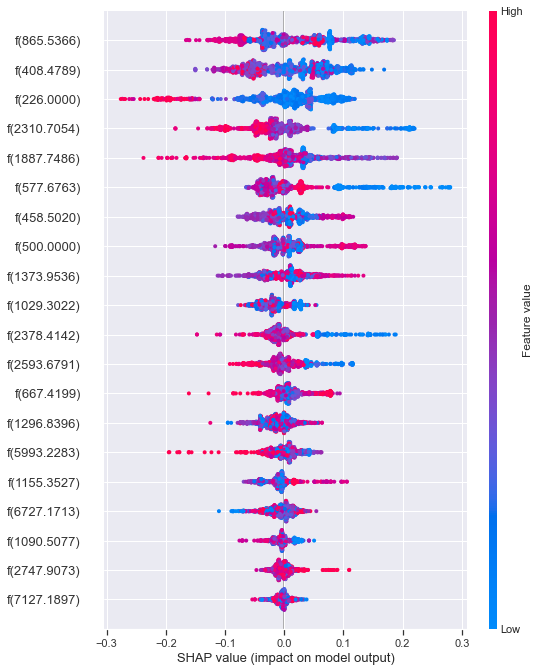

In [309]:
%time
# samples = X_train
samples_adasyn_large = X_test_adasyn_large

explainer_adasyn_large = shap.TreeExplainer(rf_random_adasyn_large_model)
shap_values_adasyn_large = explainer_adasyn_large.shap_values(samples_adasyn_large, approximate=False, check_additivity=False)

shap.summary_plot(shap_values_adasyn_large[1], samples_adasyn_large)

First is the SHAP value plot, which further shows the positive and negative relationship between the predictor variables and the target variables to get the magnitude of the effect of the feature on the prediction, which is equivalent to rotating each feature of the force plot by 90 degrees and drawing it as a point plot. The effect of the size of the feature on the results is indicated by the colour (red for large values, blue for small values and purple adjacent to the mean), the wider the distribution of the area the greater its influence, thus frequencies such as f(865.5366),f(408.4789),f(226.0000) have a high and positive influence, 'high ' from the red and 'negative' influences shown on the x-axis. Similarly we would say that f(500.0000),f(458.5020),f(1373.9536) is positively associated with diagnosing patients ear with conductive condition.

Based on the SHAP summary plot, we can see top 20 features and their indications of the relationship between the value of a feature and the impact on the classification model. For better understanding let us have a look at the dependence plots.

基于SHAP汇总图，我们可以用它们指示看到前20个特征以及特征值与影响之间的关系分类模型。为了更好地理解，让我们来看看依赖关系图。

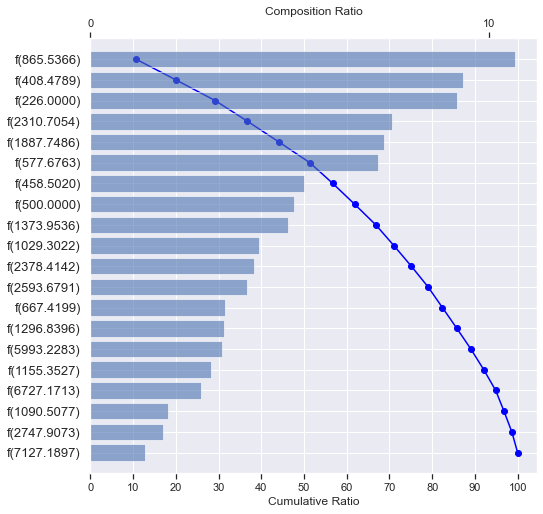

In [310]:
# Shapp waterfall plot
make_shap_waterfall_plot(shap_values_adasyn_large[1], samples_adasyn_large)

Based on the SHAP waterfall plot, we can say that f(865.5366) is the most important frequency in the model, which is more than 10% of the model's explainability. Also, these top 20 frequencies have provided 100% of the model's interpretation.

For a better understanding, let's look at the dependency diagram:

In [311]:
shap.force_plot(explainer_adasyn_large.expected_value[1], shap_values_adasyn_large[1], samples_adasyn_large)

## Prediction Results on Testing Set

The Prediction Results on Testing Set:


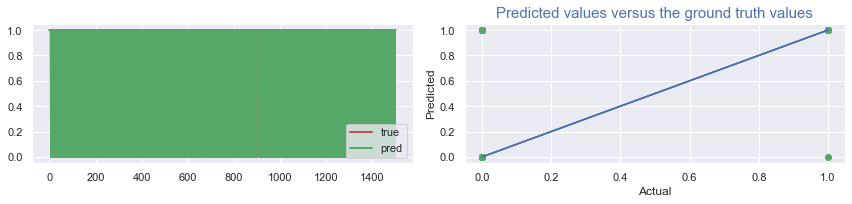

In [ ]:
print("The Prediction Results on Testing Set:") #subtitle
    
fig = plt.figure(figsize=(12,3))

plt.subplot(1,2,1)
t=np.arange(len(X_test_adasyn_large))
pred_plot(np.ravel(y_test_adasyn_large), np.ravel(y_pred_random_adasyn_large)) #call the function on test sets
# plt.title("Test Sets", fontsize=15) #title
fig.tight_layout(pad=1, w_pad=3.0, h_pad=3.0) #adjust the image to the right size and position
# plt.show()

plt.subplot(1,2,2)
# x_diagonal = [0,50]
# y_diagonal = [0,50]
plt.plot(np.ravel(y_test_adasyn_large), np.ravel(y_test_adasyn_large))
# plt.plot(x_diagonal , y_diagonal , c='0' , linewidth=1 ,  marker='.' , alpha=0.3)# Drawing diagonals
plt.scatter(np.ravel(y_test_adasyn_large), np.ravel(y_pred_adasyn_large),color='g')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Predicted values versus the ground truth values",fontsize=15,color='b') #title
    
plt.tight_layout()# Adjusting the distance between each subplot
plt.show()

In [ ]:
clf_over = DecisionTreeClassifier(random_state=42)   # decision tree instantiation
rfc_over = RandomForestClassifier(random_state=42)   # Random forest instantiation

# Training data set
clf_over = clf_over.fit(X_train_over,y_train_over)
rfc_over = rfc_over.fit(X_train_over,np.ravel(y_train_over))

score_c_over = clf_over.score(X_test_over,y_test_over)
score_r_over=rfc_over.score(X_test_over,y_test_over)
print("single tree:{}".format(score_c_over))
print("randon forest:{}".format(score_r_over))

single tree:0.9836065573770492
randon forest:0.9836065573770492


### GridSearch

In [ ]:
clf_l_over = []
rfc_l_over = []
# Cross-validation: This is a method of dividing the data set into n parts, taking each part in turn as a test set and each n-1 part as a training set, and training the model several times to observe the stability of the model
for i in range(10):
    # Random forest cross-validation
    rfc_over = RandomForestClassifier(n_estimators=25)
    rfc_s_over = cross_val_score(rfc_over, X_train_over, np.ravel(y_train_over), cv=10).mean()
    rfc_l_over.append(rfc_s_over)
    # Decision tree cross-validation
    clf_over = DecisionTreeClassifier()
    clf_s_over = cross_val_score(clf_over, X_train_over, np.ravel(y_train_over), cv=10).mean()
    clf_l_over.append(clf_s_over)

plt.plot(range(1, 11), rfc_l_over, label="Random Forest")
plt.plot(range(1, 11), clf_l_over, label="Decision Tree")
plt.legend()
plt.show()

n_estimators

0.9941176470588236 0


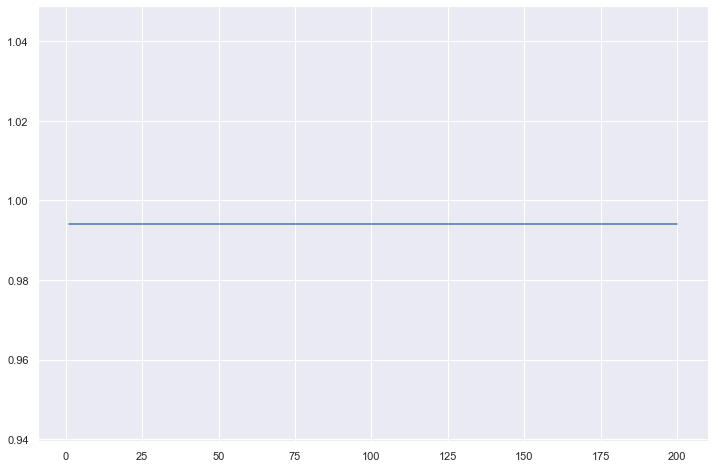

In [ ]:
rfc_over = RandomForestClassifier(n_estimators=25,random_state=1)
superpa_over = []
for i in range(200):
    rfc_over = RandomForestClassifier(n_estimators=i+1,n_jobs=-1,random_state=1)
    rfc_s_over = cross_val_score(rfc,X_train_over,np.ravel(y_train_over),cv=10).mean()
    superpa_over.append(rfc_s_over)
print(max(superpa_over),superpa_over.index(max(superpa_over)))
plt.figure(figsize=[12,8])
plt.plot(range(1,201),superpa_over)
plt.show()


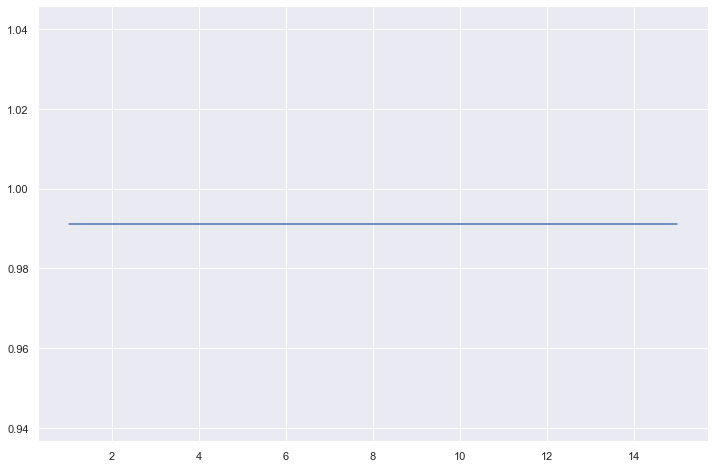

In [ ]:
idx_over = []
for j in range(15):
    rfc_1_over = RandomForestClassifier(n_estimators=25,max_features=j+1,random_state=1)
    rfc_1_s_over = cross_val_score(rfc_over,X_train_over,np.ravel(y_train_over),cv=10).mean()
    idx_over.append(rfc_1_s_over)
plt.figure(figsize=(12,8))
plt.plot(range(1,16),idx_over)
plt.show()

In [ ]:
from sklearn.tree import plot_tree

In [ ]:
rf_classifier = grid_rf.best_estimator_

In [ ]:
rf_pred = rf_classifier.predict(X_test)
accuracy_score(rf_pred, y_test)

1.0

In [ ]:
plot_cm(y_test, rf_pred)

NameError: name 'plot_cm' is not defined

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV

params = {'max_leaf_nodes': list(range(2, 100)), 'min_samples_split': [2, 3, 4]}
grid_search_cv = GridSearchCV(DecisionTreeClassifier(random_state=42), params, verbose=1, cv=3)

grid_search_cv.fit(X_train, y_train)

Fitting 3 folds for each of 294 candidates, totalling 882 fits


GridSearchCV(cv=3, estimator=DecisionTreeClassifier(random_state=42),
             param_grid={'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                            13, 14, 15, 16, 17, 18, 19, 20, 21,
                                            22, 23, 24, 25, 26, 27, 28, 29, 30,
                                            31, ...],
                         'min_samples_split': [2, 3, 4]},
             verbose=1)

In [ ]:
grid_search_cv.best_estimator_

DecisionTreeClassifier(max_leaf_nodes=3, random_state=42)

In [ ]:
# importing Decision Tree Classifier via sklean

from sklearn.tree import DecisionTreeClassifier

dtree = DecisionTreeClassifier(criterion='entropy',max_depth=10)
dtree.fit(X_train,y_train)
predictions = dtree.predict(X_test)

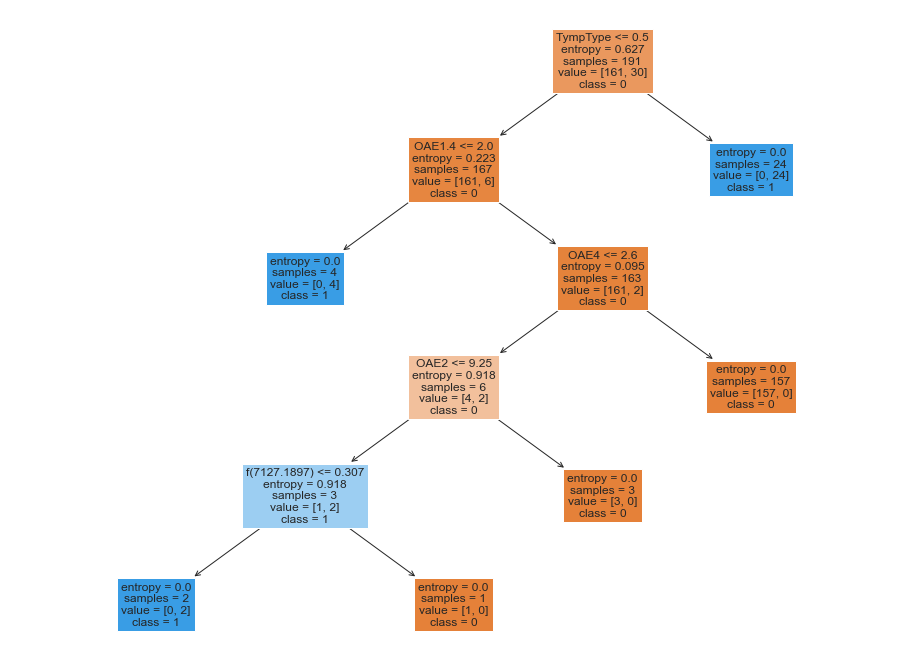

In [ ]:
# visualising the decision tree diagram

from sklearn.tree import plot_tree

import matplotlib.pyplot as plt
fig = plt.figure(figsize=(16,12))
a = plot_tree(dtree, feature_names=X_train.columns, fontsize=12, filled=True, class_names=['0', '1'])

In [ ]:
X_train.columns

Index(['TPP', 'TympType', 'OAE1', 'OAE1.4', 'OAE2', 'OAE2.8', 'OAE4',
       'f(408.4789)', 'f(2593.6791)', 'f(2378.4142)', 'f(2310.7054)',
       'f(7127.1897)', 'f(865.5366)', 'f(6727.1713)', 'f(226.0000)',
       'f(458.5020)', 'f(500.0000)', 'f(1029.3022)', 'f(5993.2283)',
       'f(1887.7486)', 'f(1373.9536)', 'f(667.4199)', 'f(2747.9073)',
       'f(1296.8396)', 'f(577.6763)', 'f(1155.3527)', 'f(1090.5077)'],
      dtype='object')

In [ ]:
# importing Decision Tree Classifier via sklean

from sklearn.tree import DecisionTreeClassifier

dtree_over = DecisionTreeClassifier(criterion='entropy',max_depth=5)
dtree_over.fit(X_train_over,y_train_over)
predictions = dtree_over.predict(X_test_over)

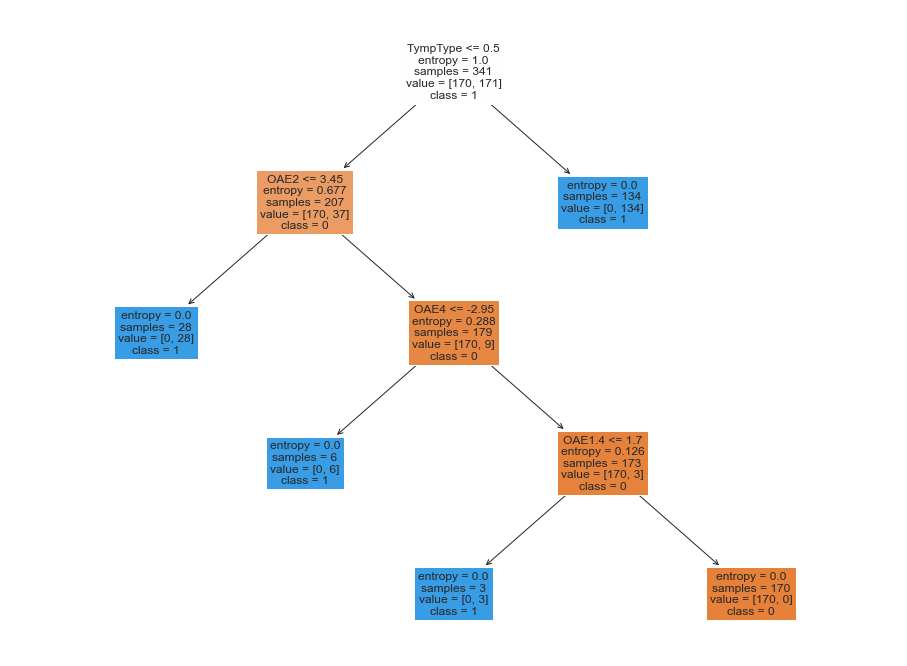

In [ ]:
fig_over = plt.figure(figsize=(16,12))
a_over = plot_tree(dtree_over, feature_names=X_train_over.columns, fontsize=12, filled=True, class_names=['0', '1'])